In [62]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
from scipy.stats import shapiro
from scipy.stats import chi2,chi2_contingency
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder,LabelEncoder

In [63]:
df = pd.read_csv('MIMIC-IV-data-extraced.csv')

### Exploratory Data Analysis

In [64]:
df.describe()

,subject_id,age,mortality,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,Arterial Blood Pressure diastolic,Non Invasive Blood Pressure diastolic,...,"Sedative, hypnotic or anxiolytic use, unspecified with sedative",Inhalant abuse with inhalant-induced dementia,Inhalant dependence with inhalant-induced dementia,"Inhalant use, unspecified with inhalant-induced persisting deme",Other psychoactive substance abuse with psychoactive substance-,Other psychoactive substance dependence with psychoactive subst,"Other psychoactive substance use, unspecified with psychoactive",Frontotemporal dementia,Other frontotemporal dementia-2,Dementia with Lewy bodies
count,6.377000e+03,6377.000000,6377.000000,6377.000000,6374.000000,6373.000000,3899.000000,6332.000000,3900.000000,6332.000000,...,6377.0,6377.0,6377.0,6377.0,6377.000000,6377.0,6377.0,6377.0,6377.000000,6377.000000
mean,1.497580e+07,69.313157,0.151952,113.117767,260.787575,168.810309,154.507053,160.847285,174.744359,215.886292,...,0.0,0.0,0.0,0.0,0.000157,0.0,0.0,0.0,0.000470,0.002195
std,2.867415e+06,13.154244,0.359003,24.498357,3955.804690,2388.104217,29.238841,294.861135,2312.412261,2786.237760,...,0.0,0.0,0.0,0.0,0.012523,0.0,0.0,0.0,0.021686,0.046807
min,1.000243e+07,19.000000,0.000000,43.000000,60.000000,40.000000,0.000000,56.000000,1.000000,41.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
25%,1.249449e+07,61.000000,0.000000,95.000000,120.000000,50.000000,136.000000,135.000000,69.000000,82.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
50%,1.495931e+07,70.000000,0.000000,109.000000,130.000000,60.000000,150.000000,153.000000,78.000000,98.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
75%,1.743914e+07,79.000000,0.000000,128.000000,133.750000,60.000000,168.000000,171.000000,92.000000,115.000000,...,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
max,1.999729e+07,91.000000,1.000000,295.000000,165130.000000,60120.000000,742.000000,15878.000000,91100.000000,105125.000000,...,0.0,0.0,0.0,0.0,1.000000,0.0,0.0,0.0,1.000000,1.000000


In [65]:
df.head()

,subject_id,gender,age,mortality,ethnicity,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,...,Inhalant abuse with inhalant-induced dementia,Inhalant dependence with inhalant-induced dementia,"Inhalant use, unspecified with inhalant-induced persisting deme",Other psychoactive substance abuse with psychoactive substance-,Other psychoactive substance dependence with psychoactive subst,"Other psychoactive substance use, unspecified with psychoactive",Frontotemporal dementia,Other frontotemporal dementia-2,Dementia with Lewy bodies,Age Group
0,10002430,M,86,0,WHITE,103,140.0,60.0,NaN,126.0,...,0,0,0,0,0,0,0,0,0,66-100
1,10004401,M,82,1,WHITE,104,120.0,60.0,150.0,166.0,...,0,0,0,0,0,0,0,0,0,66-100
2,10004606,F,64,0,WHITE,116,130.0,130.0,210.0,204.0,...,0,0,0,0,0,0,0,0,0,51-65
3,10005348,M,76,0,WHITE,103,160.0,85.0,138.0,157.0,...,0,0,0,0,0,0,0,0,0,66-100
4,10010058,M,80,1,ASIAN - SOUTH EAST ASIAN,155,130.0,50.0,118.0,121.0,...,0,0,0,0,0,0,0,0,0,66-100


In [66]:
df.tail()

,subject_id,gender,age,mortality,ethnicity,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,...,Inhalant abuse with inhalant-induced dementia,Inhalant dependence with inhalant-induced dementia,"Inhalant use, unspecified with inhalant-induced persisting deme",Other psychoactive substance abuse with psychoactive substance-,Other psychoactive substance dependence with psychoactive subst,"Other psychoactive substance use, unspecified with psychoactive",Frontotemporal dementia,Other frontotemporal dementia-2,Dementia with Lewy bodies,Age Group
6372,19993776,M,83,0,WHITE,70,130.0,50.0,NaN,161.0,...,0,0,0,0,0,0,0,0,0,66-100
6373,19994379,M,68,0,WHITE,132,140.0,50.0,NaN,121.0,...,0,0,0,0,0,0,0,0,0,66-100
6374,19995091,M,65,0,WHITE,89,120.0,60.0,132.0,114.0,...,0,0,0,0,0,0,0,0,0,51-65
6375,19995595,M,68,0,UNKNOWN,149,140.0,60.0,216.0,186.0,...,0,0,0,0,0,0,0,0,0,66-100
6376,19997293,M,76,0,WHITE,112,120.0,60.0,186.0,189.0,...,0,0,0,0,0,0,0,0,0,66-100


In [67]:
df.shape

(6377, 207)

In [68]:
df.columns

Index(['subject_id', 'gender', 'age', 'mortality', 'ethnicity', 'Heart Rate',
       'Heart rate Alarm - High', 'Heart Rate Alarm - Low',
       'Arterial Blood Pressure systolic',
       'Non Invasive Blood Pressure systolic',
       ...
       'Inhalant abuse with inhalant-induced dementia',
       'Inhalant dependence with inhalant-induced dementia',
       'Inhalant use, unspecified with inhalant-induced persisting deme',
       'Other psychoactive substance abuse with psychoactive substance-',
       'Other psychoactive substance dependence with psychoactive subst',
       'Other psychoactive substance use, unspecified with psychoactive',
       'Frontotemporal dementia', 'Other frontotemporal dementia-2',
       'Dementia with Lewy bodies', 'Age Group'],
      dtype='object', length=207)

In [69]:
#Finding total number of unique values:
df.nunique()

subject_id                                                         6377
gender                                                                2
age                                                                  72
mortality                                                             2
ethnicity                                                            33
                                                                   ... 
Other psychoactive substance use, unspecified with psychoactive       1
Frontotemporal dementia                                               1
Other frontotemporal dementia-2                                       2
Dementia with Lewy bodies                                             2
Age Group                                                             4
Length: 207, dtype: int64

In [70]:
#Converting gender to binary as Male=0 Female=1
df['gender']=np.where(df.gender=='M',0,1)
print(df['gender'])

0       0
1       0
2       1
3       0
4       0
       ..
6372    0
6373    0
6374    0
6375    0
6376    0
Name: gender, Length: 6377, dtype: int32


In [71]:
#numeric variables from the dataset are:
numeric_df= df.select_dtypes(include=['number'])
non_binary=numeric_df.columns[(numeric_df.nunique() > 2)]
print(non_binary)

Index(['subject_id', 'age', 'Heart Rate', 'Heart rate Alarm - High',
       'Heart Rate Alarm - Low', 'Arterial Blood Pressure systolic',
       'Non Invasive Blood Pressure systolic',
       'Arterial Blood Pressure diastolic',
       'Non Invasive Blood Pressure diastolic', 'Respiratory Rate',
       'Respiratory Rate (Set)', 'Respiratory Rate (spontaneous)',
       'Respiratory Rate (Total)', 'SpO2 Desat Limit', 'INR',
       'Prothrombin time', 'Anion gap', 'Creatinine (serum)', 'Temperature',
       'Potassium, Whole Blood-2', 'Potassium (whole blood)',
       'Sodium (whole blood)', 'Sodium, Whole Blood', 'Chloride, Whole Blood',
       'Chloride (whole blood)', 'Bicarbonate', 'Glucose (whole blood)',
       'GCS - Eye Opening', 'Hemoglobin', 'Hemoglobin-2', 'Hematocrit',
       'Platelet Count'],
      dtype='object')


In [72]:
df[non_binary].describe()

,subject_id,age,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Arterial Blood Pressure systolic,Non Invasive Blood Pressure systolic,Arterial Blood Pressure diastolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,...,"Sodium, Whole Blood","Chloride, Whole Blood",Chloride (whole blood),Bicarbonate,Glucose (whole blood),GCS - Eye Opening,Hemoglobin,Hemoglobin-2,Hematocrit,Platelet Count
count,6.377000e+03,6377.000000,6377.000000,6374.000000,6373.000000,3899.000000,6332.000000,3900.000000,6332.000000,6375.000000,...,4256.000000,4110.000000,2808.000000,6374.000000,3.424000e+03,6377.000000,4020.000000,6377.000000,6377.000000,6377.000000
mean,1.497580e+07,69.313157,113.117767,260.787575,168.810309,154.507053,160.847285,174.744359,215.886292,34.783686,...,138.336701,106.143552,462.731838,30.702855,2.311856e+03,3.943077,12.021866,13.524557,41.140254,339.921907
std,2.867415e+06,13.154244,24.498357,3955.804690,2388.104217,29.238841,294.861135,2312.412261,2786.237760,35.494195,...,4.779916,5.564448,18869.253297,4.474367,4.715157e+04,0.369037,2.692671,1.860455,5.303291,164.069124
min,1.000243e+07,19.000000,43.000000,60.000000,40.000000,0.000000,56.000000,1.000000,41.000000,15.000000,...,115.000000,71.000000,11.000000,13.000000,3.500000e+01,1.000000,0.000000,5.100000,18.100000,9.000000
25%,1.249449e+07,61.000000,95.000000,120.000000,50.000000,136.000000,135.000000,69.000000,82.000000,27.000000,...,136.000000,103.000000,104.000000,28.000000,1.470000e+02,4.000000,10.700000,12.300000,37.600000,231.000000
50%,1.495931e+07,70.000000,109.000000,130.000000,60.000000,150.000000,153.000000,78.000000,98.000000,32.000000,...,138.000000,106.000000,107.000000,30.000000,1.730000e+02,4.000000,12.100000,13.600000,41.400000,304.000000
75%,1.743914e+07,79.000000,128.000000,133.750000,60.000000,168.000000,171.000000,92.000000,115.000000,38.000000,...,140.000000,109.000000,109.000000,33.000000,2.100000e+02,4.000000,13.400000,14.800000,44.600000,408.000000
max,1.999729e+07,91.000000,295.000000,165130.000000,60120.000000,742.000000,15878.000000,91100.000000,105125.000000,2037.000000,...,187.000000,139.000000,999999.000000,51.000000,1.276100e+06,4.000000,97.000000,22.600000,69.700000,2660.000000


### Visualizations before imputing

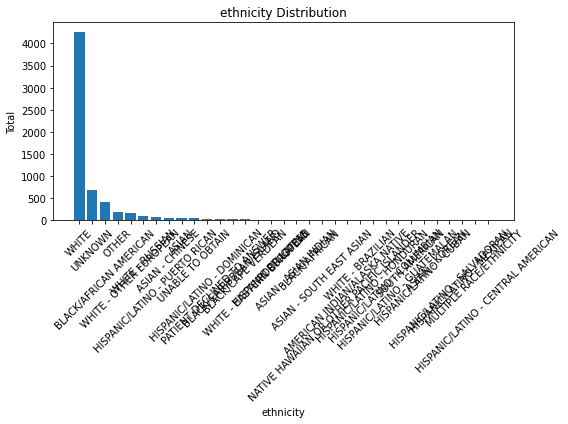

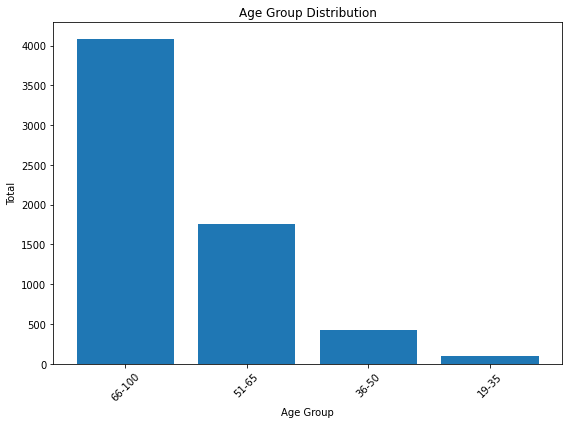

In [73]:
# Univariate Analysis for Ordinal Variables
save_dir = './bar_plots/'
import os
os.makedirs(save_dir, exist_ok=True)

mapping = {1: 'present', 0: 'absent'}

for column in df.select_dtypes(include='object'):
    # Checking if the column contains values 1 and 0
    unique_values = set(df[column].unique())
    if len(unique_values) == 1 and (0 in unique_values or 1 in unique_values):
        df[column] = df[column].map(mapping)


for column in df.select_dtypes(include='object'):
    # Count the occurrences of each category
    category_counts = df[column].value_counts()

    # Create the bar chart
    plt.figure(figsize=(8, 6))
    plt.bar(category_counts.index, category_counts.values)

    # Set labels and title
    plt.xlabel(column)
    plt.ylabel('Total')
    plt.title(f'{column} Distribution')

    # Rotate x-axis labels if needed
    plt.xticks(rotation=45)
    
    plt.savefig(os.path.join(save_dir, column + '_barplot.png'))

    # Show the plot
    plt.tight_layout()
    plt.show()

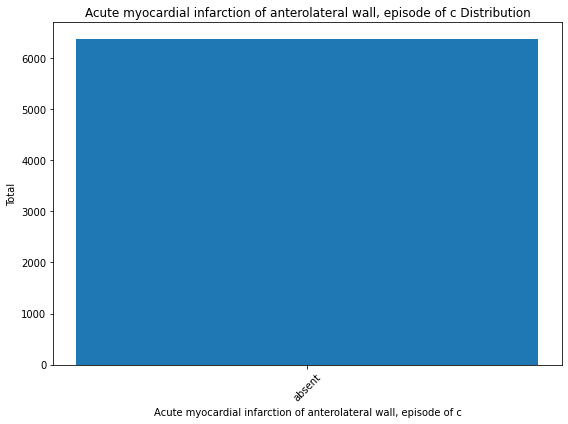

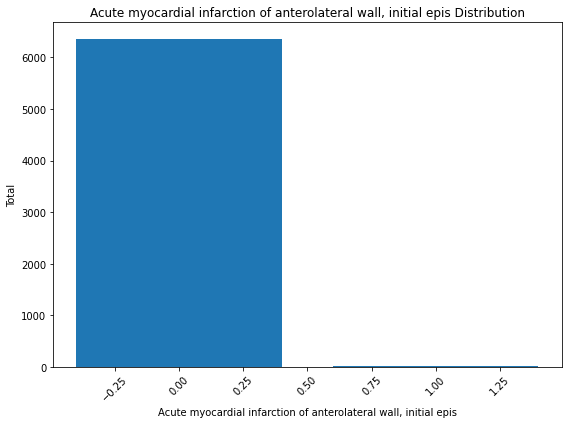

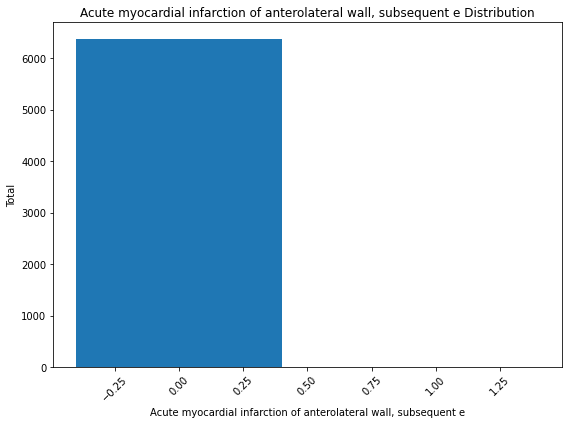

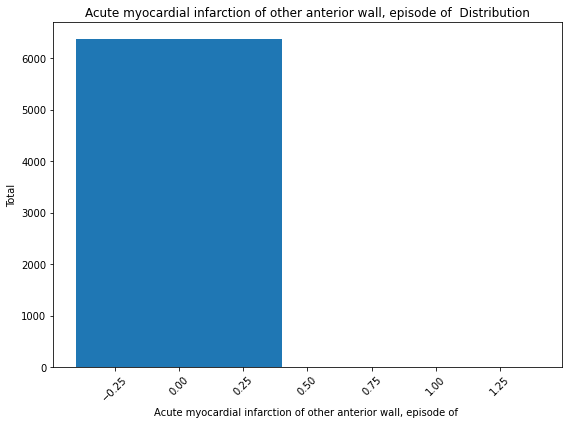

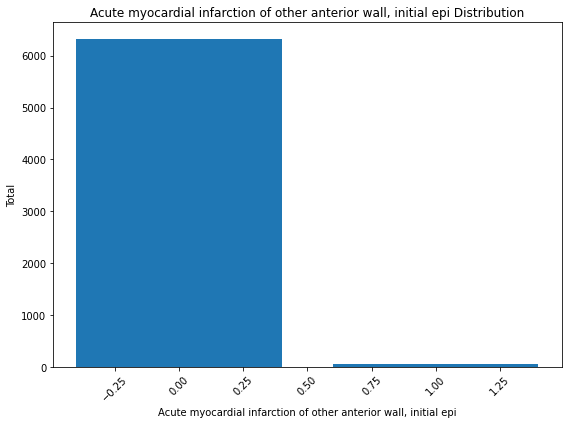

...

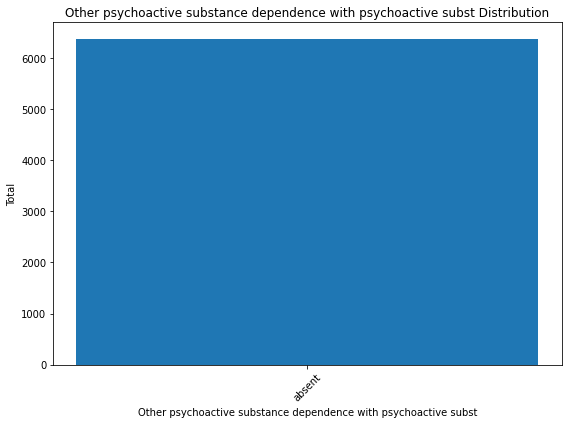

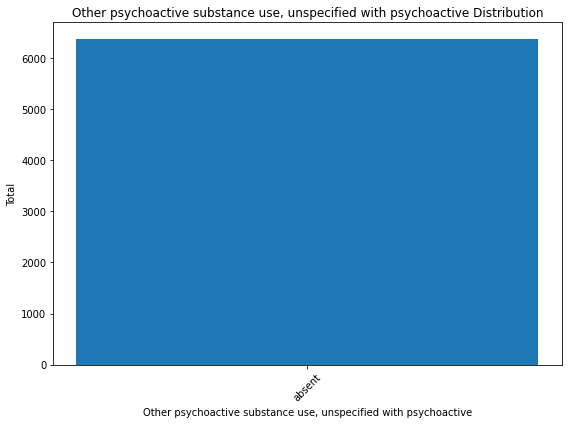

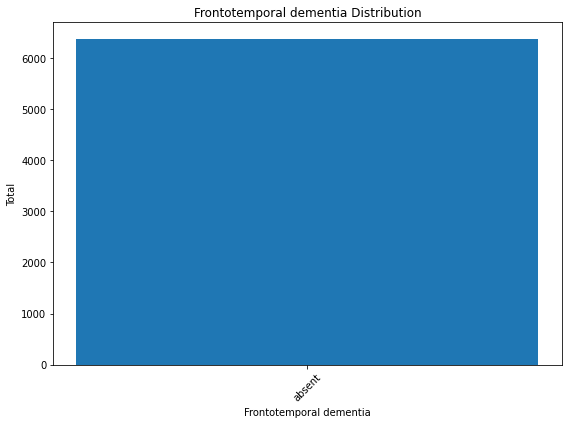

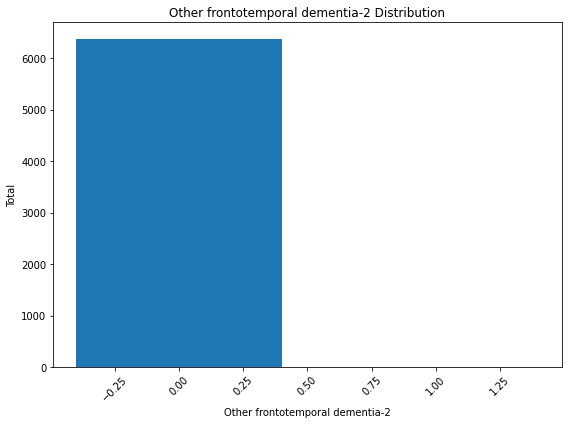

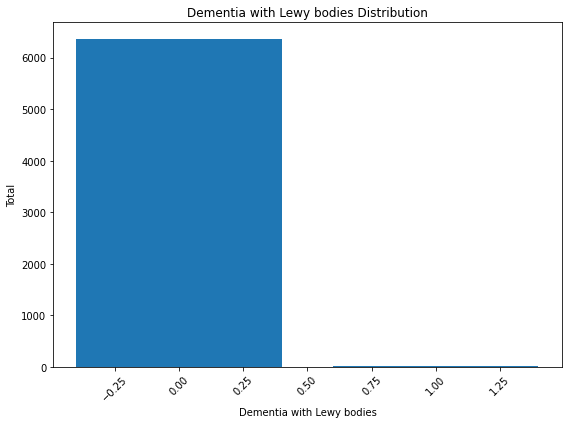

In [74]:
# Bar chart for categorical variables
save_dir = './category_plots/'
import os
os.makedirs(save_dir, exist_ok=True)

categorical_column = df.iloc[:,35:]
categorical_column = categorical_column.drop(columns=['Age Group'])

mapping = {1: 'present', 0: 'absent'}

for col in categorical_column:
    # Checking if the column contains values 1 and 0
    unique_values = set(df[col].unique())
    if len(unique_values) == 1 and (0 in unique_values or 1 in unique_values):
        df[col] = df[col].map(mapping)


for col in categorical_column:
    # Count the occurrences of each category
    category_counts = df[col].value_counts()

    # Create the bar chart
    plt.figure(figsize=(8, 6))
    plt.bar(category_counts.index, category_counts.values)

    # Set labels and title
    plt.xlabel(col)
    plt.ylabel('Total')
    plt.title(f'{col} Distribution')

    # Rotate x-axis labels if needed
    plt.xticks(rotation=45)
    
    plt.savefig(os.path.join(save_dir, col + '_catplot.png'))

    # Show the plot
    plt.tight_layout()
    plt.show()

Summary statistics for column: subject_id
count    6.377000e+03
mean     1.497580e+07
std      2.867415e+06
min      1.000243e+07
25%      1.249449e+07
50%      1.495931e+07
75%      1.743914e+07
max      1.999729e+07
Name: subject_id, dtype: float64


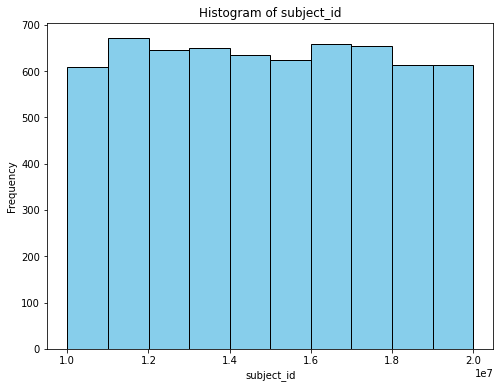

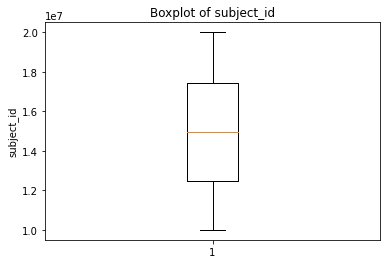

Summary statistics for column: gender
count    6377.000000
mean        0.375725
std         0.484348
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: gender, dtype: float64


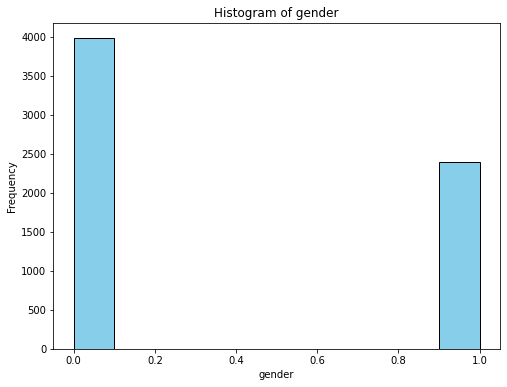

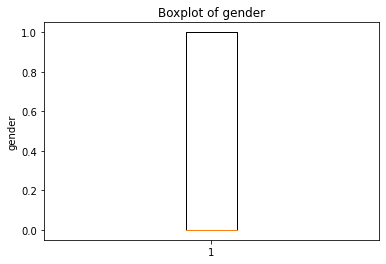

Summary statistics for column: age
count    6377.000000
mean       69.313157
std        13.154244
min        19.000000
25%        61.000000
50%        70.000000
75%        79.000000
max        91.000000
Name: age, dtype: float64


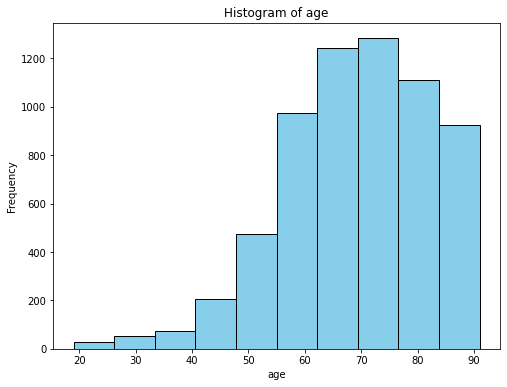

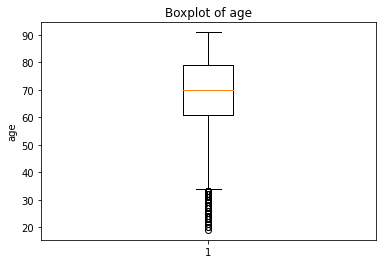

Summary statistics for column: mortality
count    6377.000000
mean        0.151952
std         0.359003
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: mortality, dtype: float64


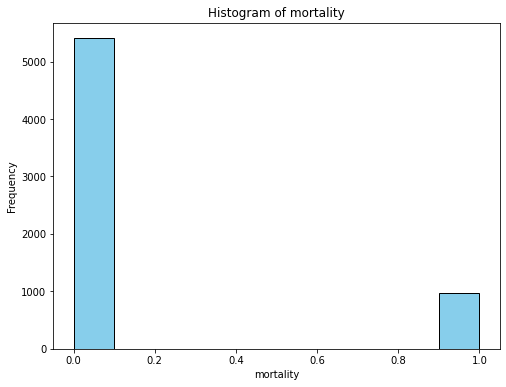

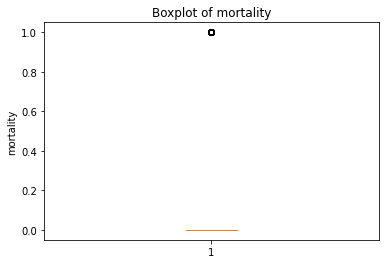

Summary statistics for column: Heart Rate
count    6377.000000
mean      113.117767
std        24.498357
min        43.000000
25%        95.000000
50%       109.000000
75%       128.000000
max       295.000000
Name: Heart Rate, dtype: float64


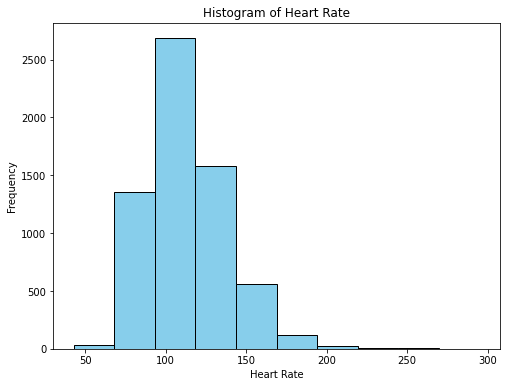

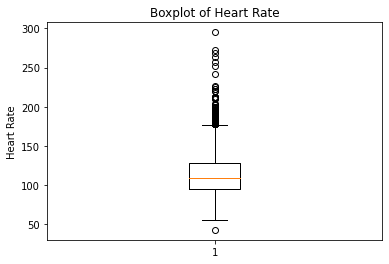

Summary statistics for column: Heart rate Alarm - High
count      6374.000000
mean        260.787575
std        3955.804690
min          60.000000
25%         120.000000
50%         130.000000
75%         133.750000
max      165130.000000
Name: Heart rate Alarm - High, dtype: float64


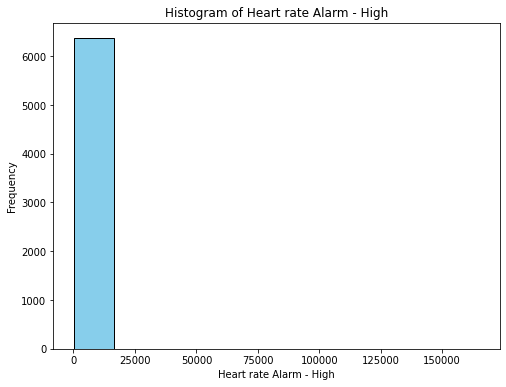

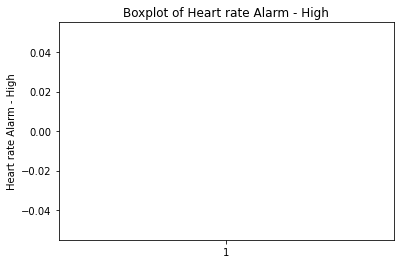

Summary statistics for column: Heart Rate Alarm - Low
count     6373.000000
mean       168.810309
std       2388.104217
min         40.000000
25%         50.000000
50%         60.000000
75%         60.000000
max      60120.000000
Name: Heart Rate Alarm - Low, dtype: float64


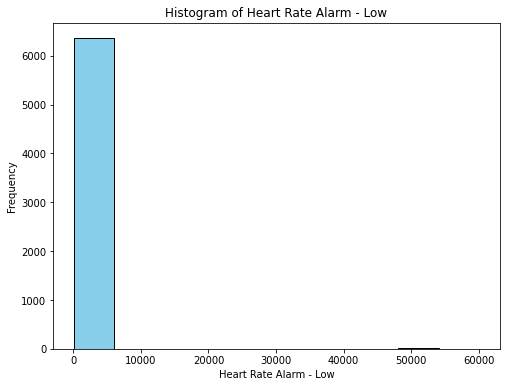

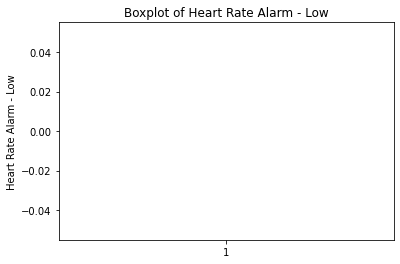

Summary statistics for column: Arterial Blood Pressure systolic
count    3899.000000
mean      154.507053
std        29.238841
min         0.000000
25%       136.000000
50%       150.000000
75%       168.000000
max       742.000000
Name: Arterial Blood Pressure systolic, dtype: float64


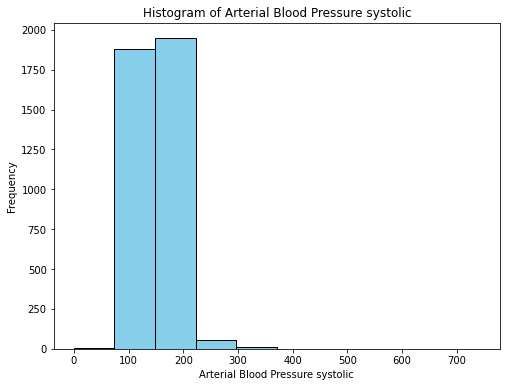

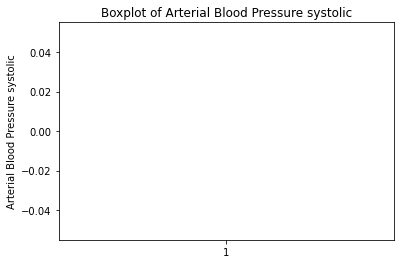

Summary statistics for column: Non Invasive Blood Pressure systolic
count     6332.000000
mean       160.847285
std        294.861135
min         56.000000
25%        135.000000
50%        153.000000
75%        171.000000
max      15878.000000
Name: Non Invasive Blood Pressure systolic, dtype: float64


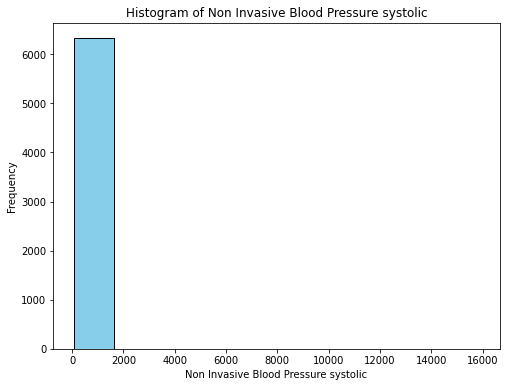

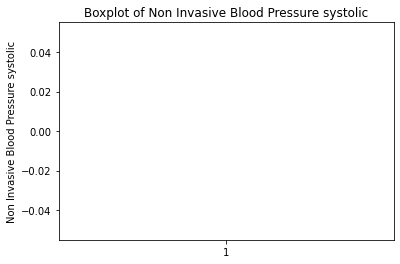

Summary statistics for column: Arterial Blood Pressure diastolic
count     3900.000000
mean       174.744359
std       2312.412261
min          1.000000
25%         69.000000
50%         78.000000
75%         92.000000
max      91100.000000
Name: Arterial Blood Pressure diastolic, dtype: float64


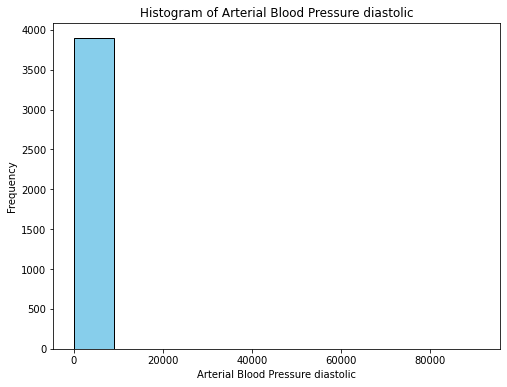

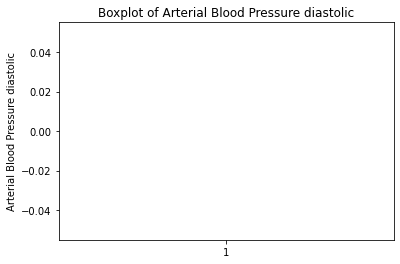

Summary statistics for column: Non Invasive Blood Pressure diastolic
count      6332.000000
mean        215.886292
std        2786.237760
min          41.000000
25%          82.000000
50%          98.000000
75%         115.000000
max      105125.000000
Name: Non Invasive Blood Pressure diastolic, dtype: float64


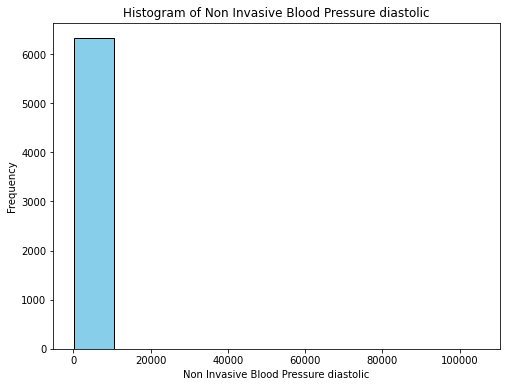

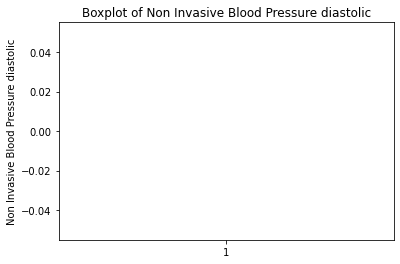

Summary statistics for column: Respiratory Rate
count    6375.000000
mean       34.783686
std        35.494195
min        15.000000
25%        27.000000
50%        32.000000
75%        38.000000
max      2037.000000
Name: Respiratory Rate, dtype: float64


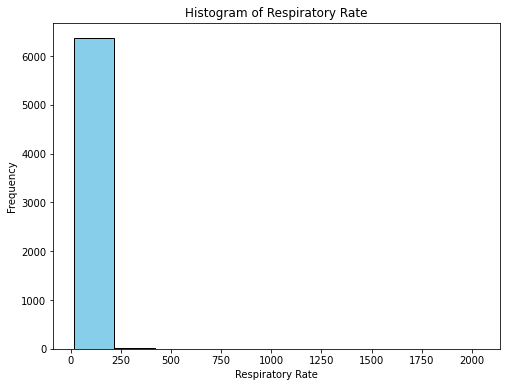

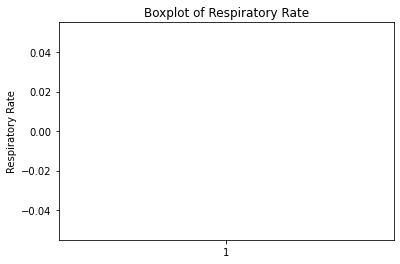

Summary statistics for column: Respiratory Rate (Set)
count    3907.000000
mean       20.020220
std        34.022791
min         0.000000
25%        16.000000
50%        18.000000
75%        20.000000
max      1618.000000
Name: Respiratory Rate (Set), dtype: float64


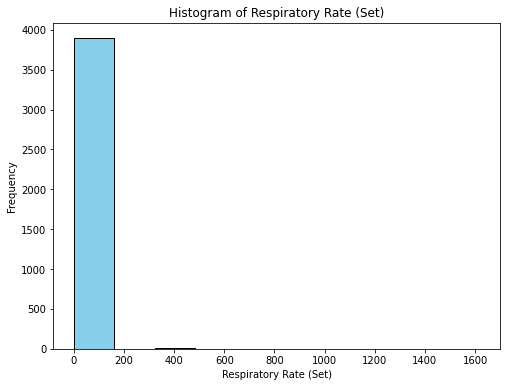

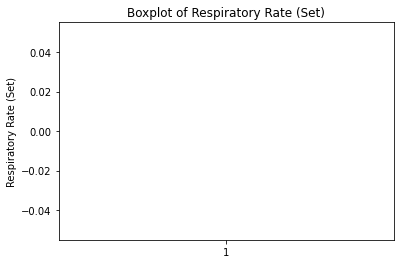

Summary statistics for column: Respiratory Rate (spontaneous)
count    4077.000000
mean       20.813834
std        36.118656
min         0.000000
25%        13.000000
50%        21.000000
75%        28.000000
max      1918.000000
Name: Respiratory Rate (spontaneous), dtype: float64


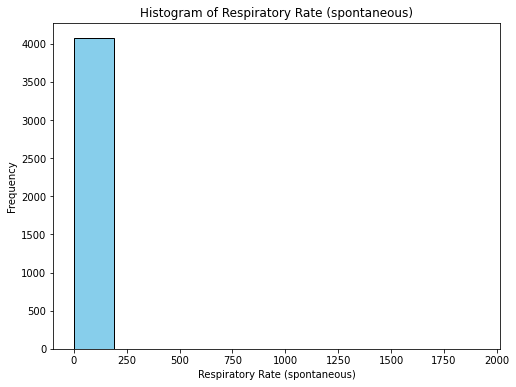

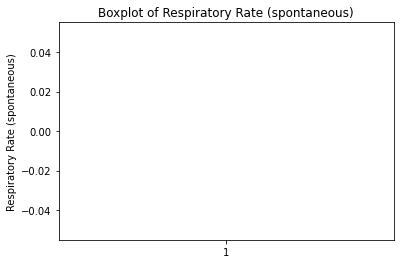

Summary statistics for column: Respiratory Rate (Total)
count    4091.000000
mean       25.742606
std        57.922742
min         0.000000
25%        18.000000
50%        23.000000
75%        29.000000
max      3634.000000
Name: Respiratory Rate (Total), dtype: float64


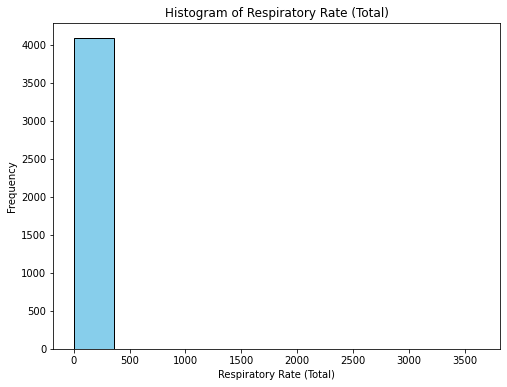

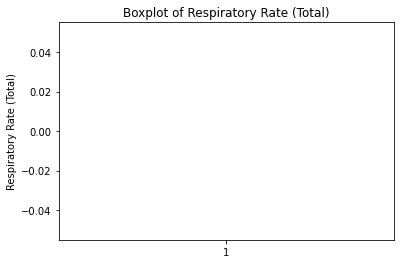

Summary statistics for column: SpO2 Desat Limit
count    6364.000000
mean       89.376996
std        39.766331
min        85.000000
25%        85.000000
50%        88.000000
75%        88.000000
max       920.000000
Name: SpO2 Desat Limit, dtype: float64


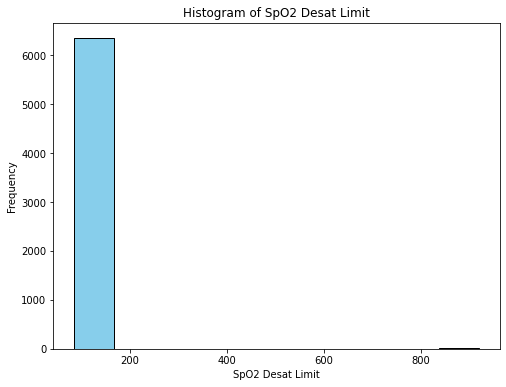

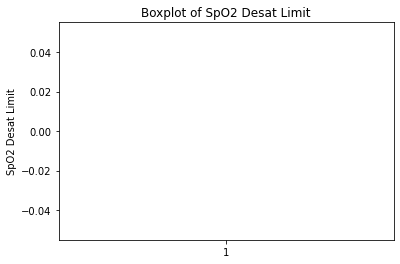

Summary statistics for column: INR
count      6141.000000
mean       5049.946255
std       70875.551022
min           0.900000
25%           1.200000
50%           1.400000
75%           1.800000
max      999999.000000
Name: INR, dtype: float64


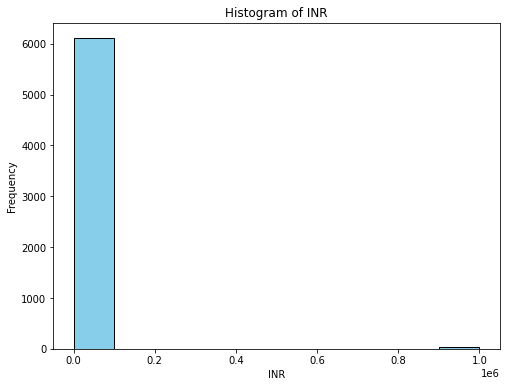

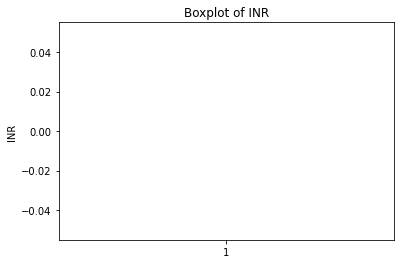

Summary statistics for column: Prothrombin time
count      6141.000000
mean       4905.797069
std       69727.423807
min           9.300000
25%          13.500000
50%          15.600000
75%          19.900000
max      999999.000000
Name: Prothrombin time, dtype: float64


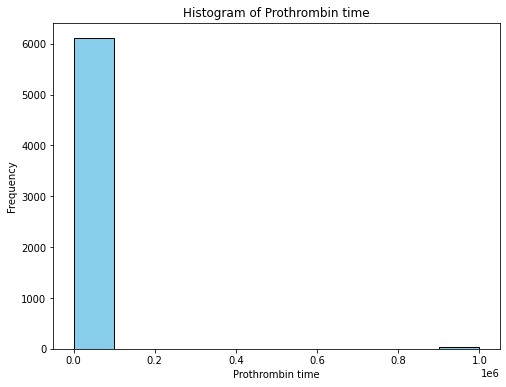

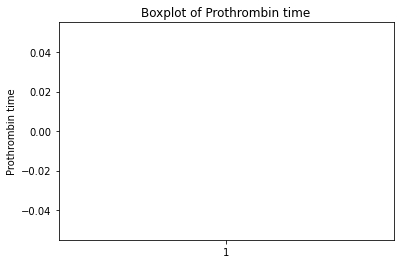

Summary statistics for column: Anion gap
count      6360.000000
mean        174.542453
std       12539.018181
min           7.000000
25%          14.000000
50%          16.000000
75%          20.000000
max      999999.000000
Name: Anion gap, dtype: float64


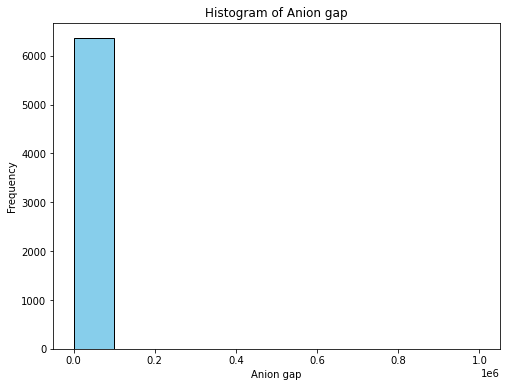

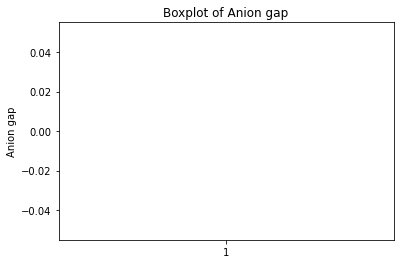

Summary statistics for column: Creatinine (serum)
count      6363.000000
mean        944.929593
std       30695.353796
min           0.300000
25%           0.900000
50%           1.200000
75%           2.100000
max      999999.000000
Name: Creatinine (serum), dtype: float64


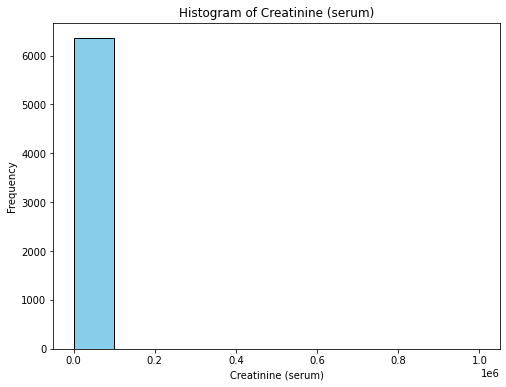

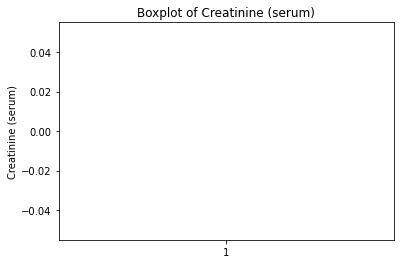

Summary statistics for column: Temperature
count    2537.000000
mean       37.391210
std         0.931146
min        32.200000
25%        36.800000
50%        37.200000
75%        37.900000
max        40.700000
Name: Temperature, dtype: float64


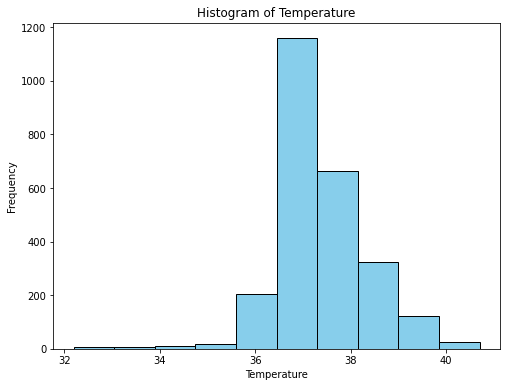

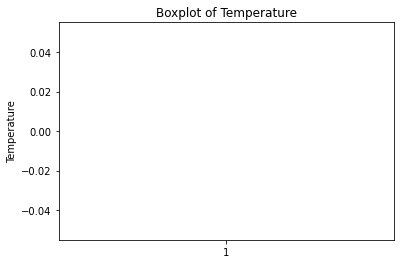

Summary statistics for column: Potassium, Whole Blood-2
count    4936.000000
mean        5.123602
std         2.164168
min         1.800000
25%         4.400000
50%         5.000000
75%         5.600000
max       134.000000
Name: Potassium, Whole Blood-2, dtype: float64


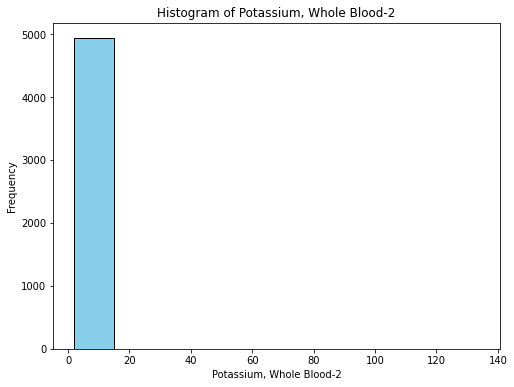

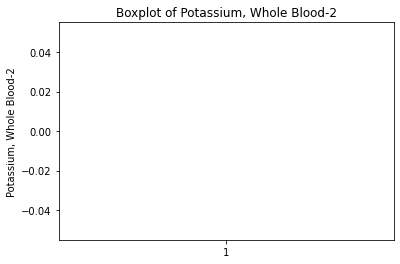

Summary statistics for column: Potassium (whole blood)
count      3575.000000
mean       1403.598853
std       37376.721593
min           2.100000
25%           4.300000
50%           4.900000
75%           5.500000
max      999999.000000
Name: Potassium (whole blood), dtype: float64


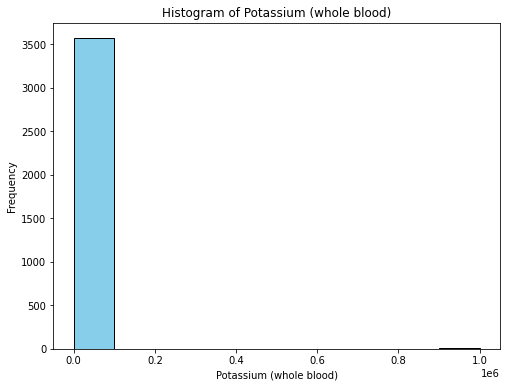

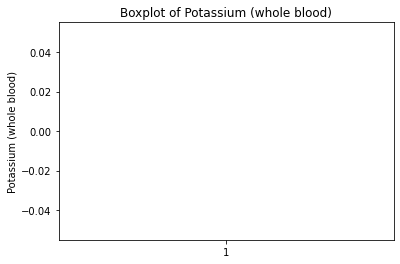

Summary statistics for column: Sodium (whole blood)
count      3015.000000
mean        800.324046
std       25747.752384
min         118.000000
25%         135.000000
50%         137.000000
75%         139.000000
max      999999.000000
Name: Sodium (whole blood), dtype: float64


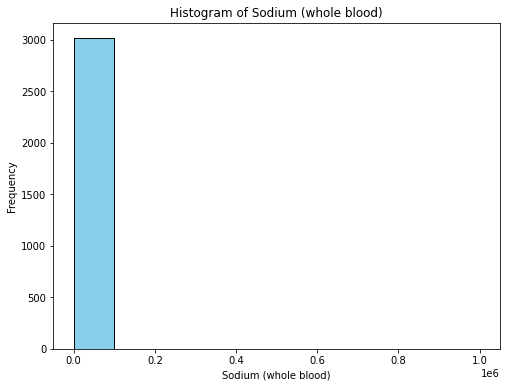

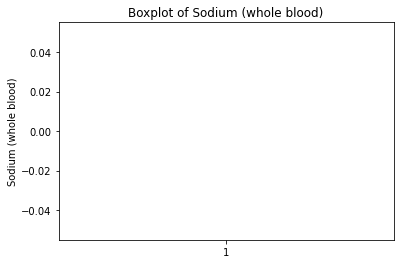

Summary statistics for column: Sodium, Whole Blood
count    4256.000000
mean      138.336701
std         4.779916
min       115.000000
25%       136.000000
50%       138.000000
75%       140.000000
max       187.000000
Name: Sodium, Whole Blood, dtype: float64


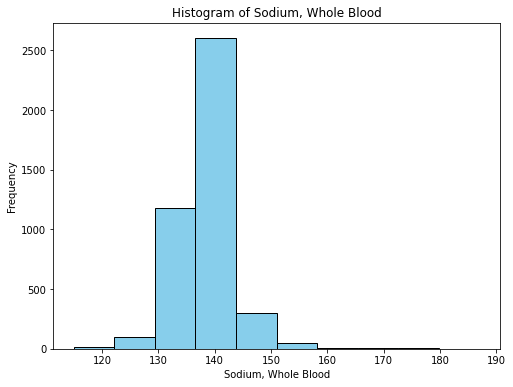

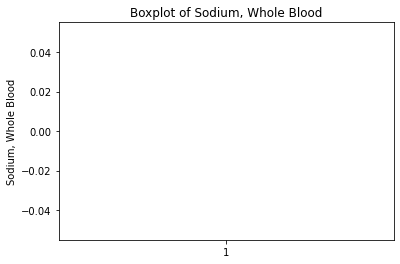

Summary statistics for column: Chloride, Whole Blood
count    4110.000000
mean      106.143552
std         5.564448
min        71.000000
25%       103.000000
50%       106.000000
75%       109.000000
max       139.000000
Name: Chloride, Whole Blood, dtype: float64


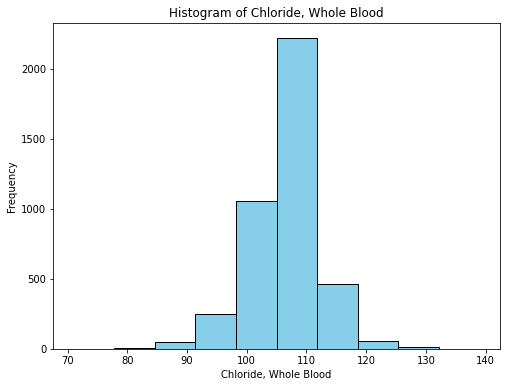

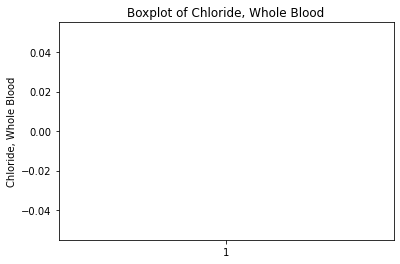

Summary statistics for column: Chloride (whole blood)
count      2808.000000
mean        462.731838
std       18869.253297
min          11.000000
25%         104.000000
50%         107.000000
75%         109.000000
max      999999.000000
Name: Chloride (whole blood), dtype: float64


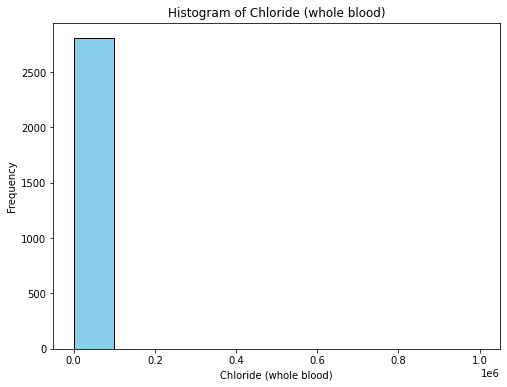

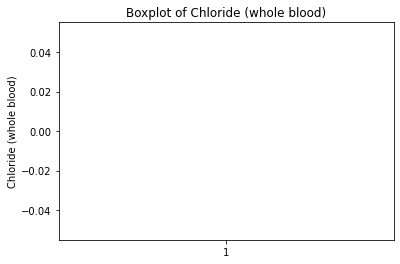

Summary statistics for column: Bicarbonate
count    6374.000000
mean       30.702855
std         4.474367
min        13.000000
25%        28.000000
50%        30.000000
75%        33.000000
max        51.000000
Name: Bicarbonate, dtype: float64


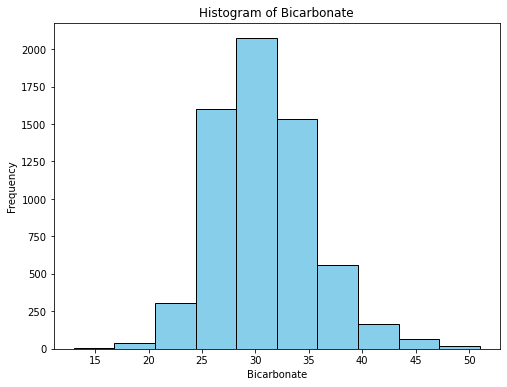

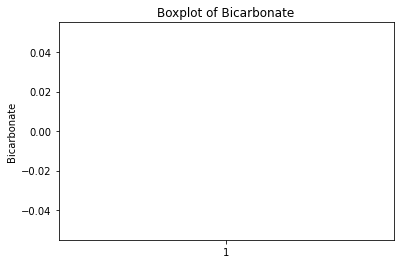

Summary statistics for column: Glucose (whole blood)
count    3.424000e+03
mean     2.311856e+03
std      4.715157e+04
min      3.500000e+01
25%      1.470000e+02
50%      1.730000e+02
75%      2.100000e+02
max      1.276100e+06
Name: Glucose (whole blood), dtype: float64


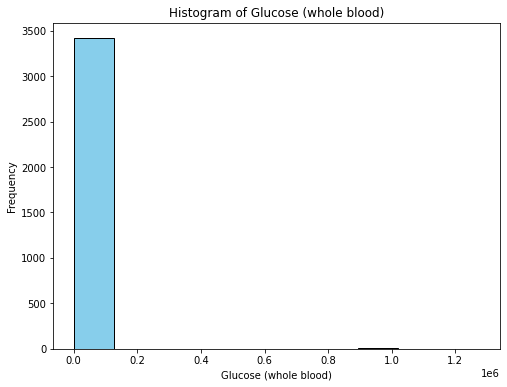

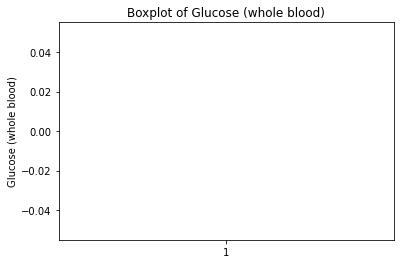

Summary statistics for column: GCS - Eye Opening
count    6377.000000
mean        3.943077
std         0.369037
min         1.000000
25%         4.000000
50%         4.000000
75%         4.000000
max         4.000000
Name: GCS - Eye Opening, dtype: float64


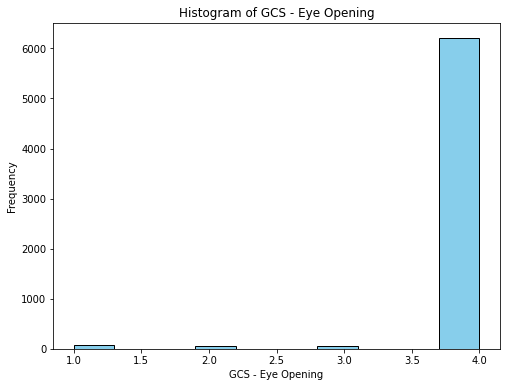

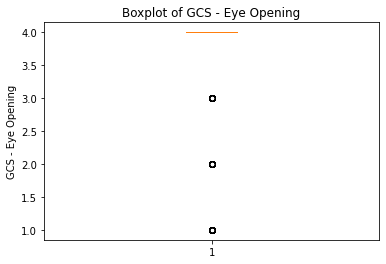

Summary statistics for column: Hemoglobin
count    4020.000000
mean       12.021866
std         2.692671
min         0.000000
25%        10.700000
50%        12.100000
75%        13.400000
max        97.000000
Name: Hemoglobin, dtype: float64


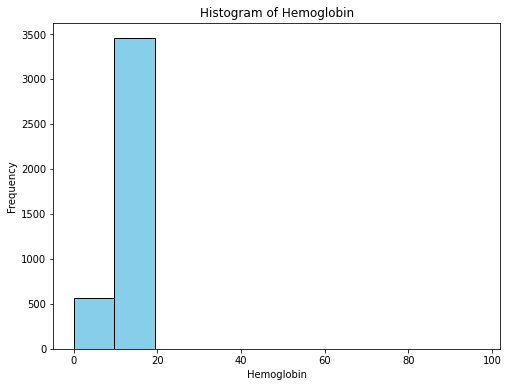

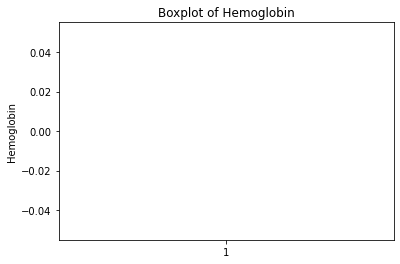

Summary statistics for column: Hemoglobin-2
count    6377.000000
mean       13.524557
std         1.860455
min         5.100000
25%        12.300000
50%        13.600000
75%        14.800000
max        22.600000
Name: Hemoglobin-2, dtype: float64


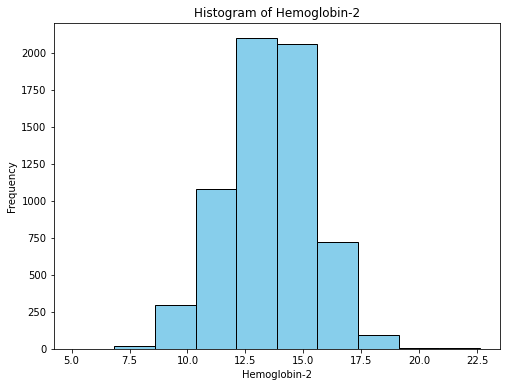

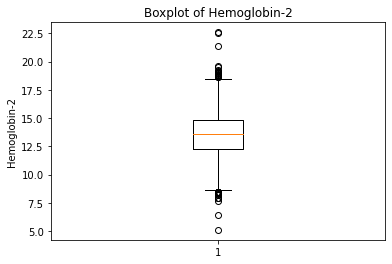

Summary statistics for column: Hematocrit
count    6377.000000
mean       41.140254
std         5.303291
min        18.100000
25%        37.600000
50%        41.400000
75%        44.600000
max        69.700000
Name: Hematocrit, dtype: float64


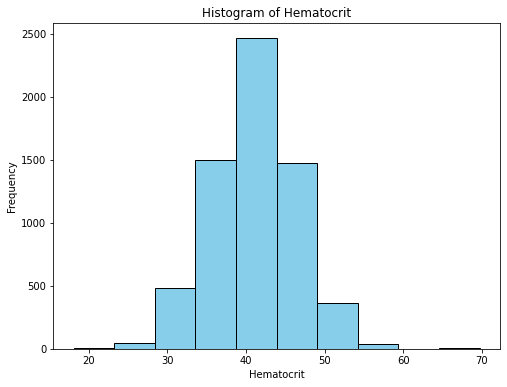

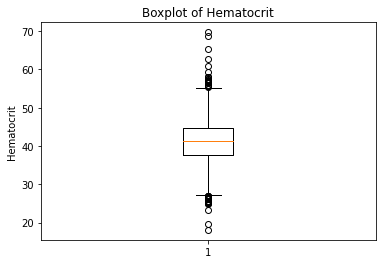

Summary statistics for column: Platelet Count
count    6377.000000
mean      339.921907
std       164.069124
min         9.000000
25%       231.000000
50%       304.000000
75%       408.000000
max      2660.000000
Name: Platelet Count, dtype: float64


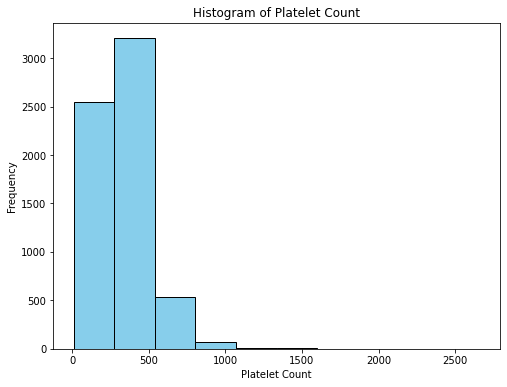

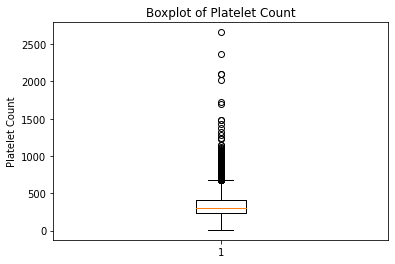

Summary statistics for column: Acute myocardial infarction of anterolateral wall, initial epis
count    6377.000000
mean        0.003136
std         0.055919
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of anterolateral wall, initial epis, dtype: float64


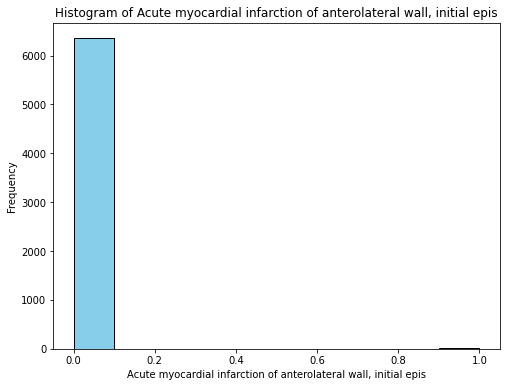

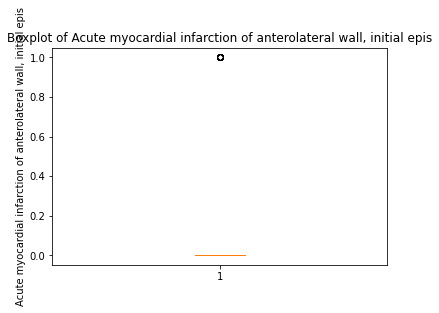

Summary statistics for column: Acute myocardial infarction of anterolateral wall, subsequent e
count    6377.000000
mean        0.000627
std         0.025039
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of anterolateral wall, subsequent e, dtype: float64


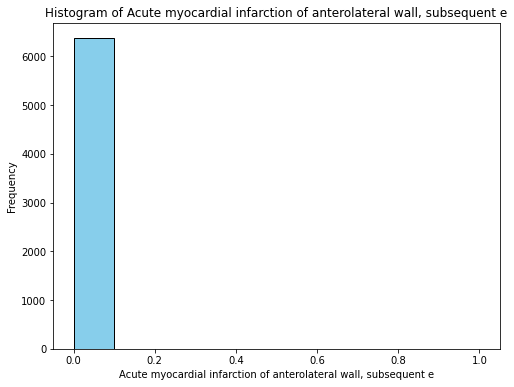

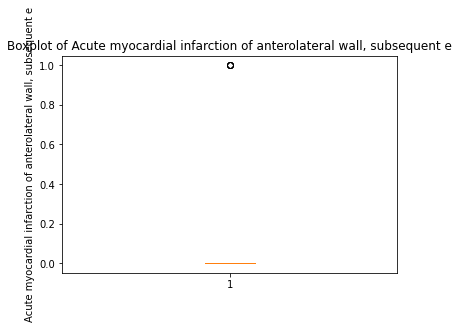

Summary statistics for column: Acute myocardial infarction of other anterior wall, episode of 
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other anterior wall, episode of , dtype: float64


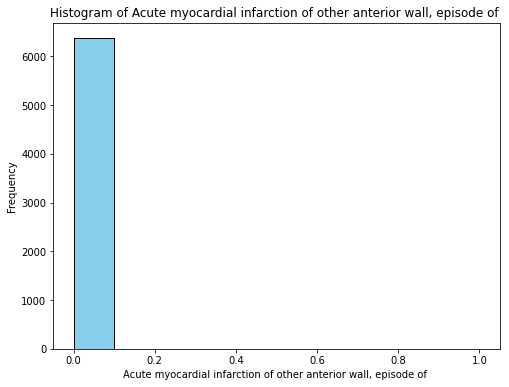

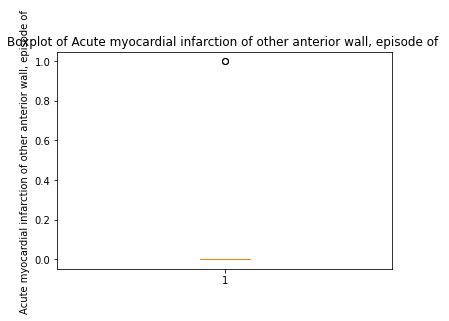

Summary statistics for column: Acute myocardial infarction of other anterior wall, initial epi
count    6377.000000
mean        0.008154
std         0.089939
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other anterior wall, initial epi, dtype: float64


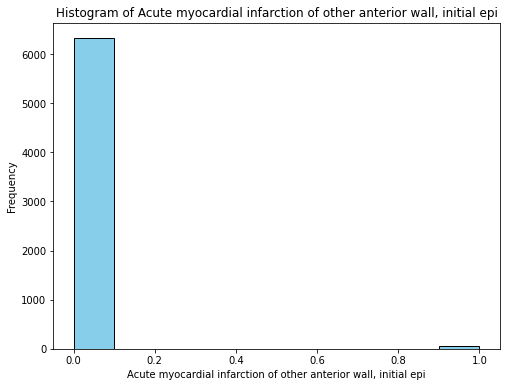

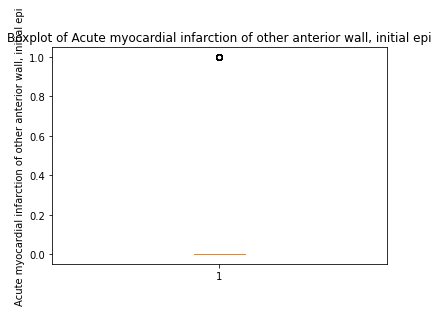

Summary statistics for column: Acute myocardial infarction of other anterior wall, subsequent 
count    6377.000000
mean        0.002195
std         0.046807
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other anterior wall, subsequent , dtype: float64


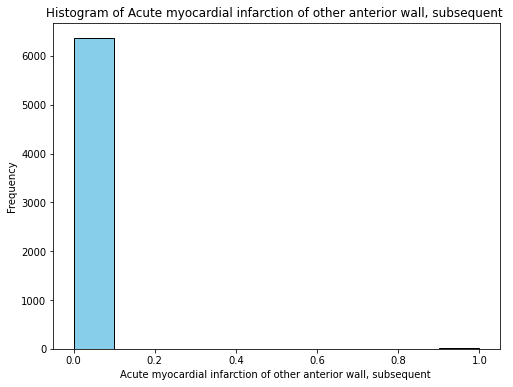

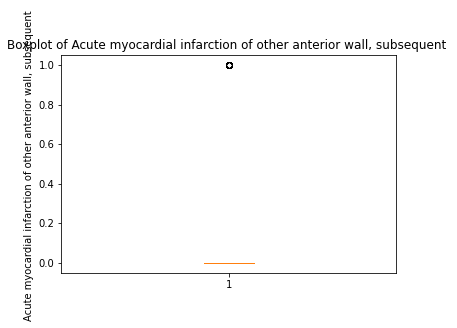

Summary statistics for column: Acute myocardial infarction of inferolateral wall, initial epis
count    6377.000000
mean        0.001882
std         0.043342
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of inferolateral wall, initial epis, dtype: float64


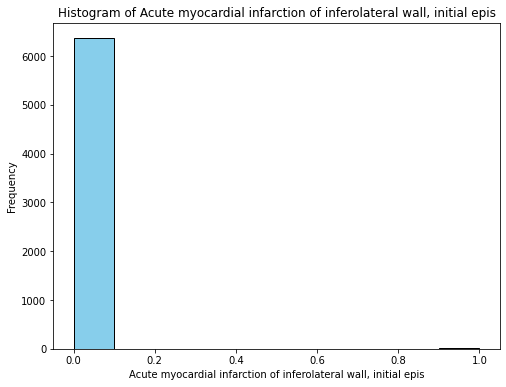

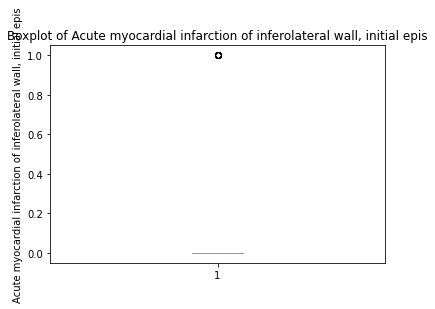

Summary statistics for column: Acute myocardial infarction of inferolateral wall, subsequent e
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of inferolateral wall, subsequent e, dtype: float64


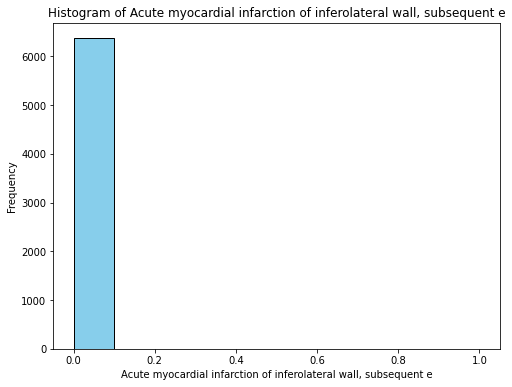

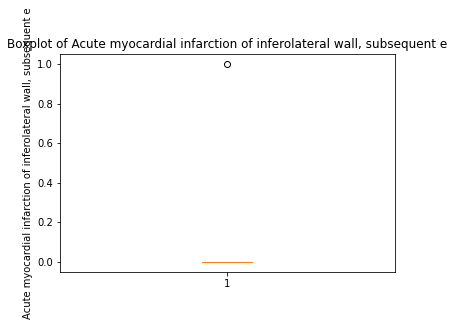

Summary statistics for column: Acute myocardial infarction of inferoposterior wall, initial ep
count    6377.000000
mean        0.002195
std         0.046807
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of inferoposterior wall, initial ep, dtype: float64


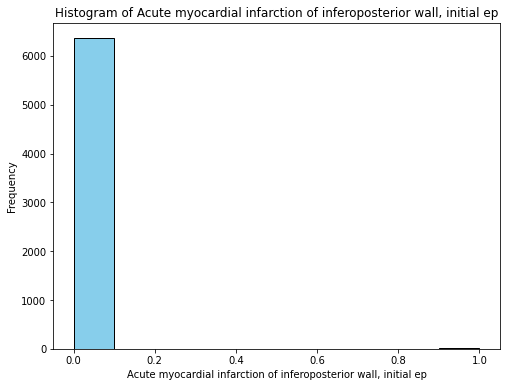

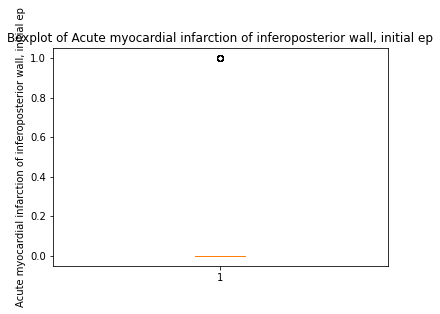

Summary statistics for column: Acute myocardial infarction of inferoposterior wall, subsequent
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of inferoposterior wall, subsequent, dtype: float64


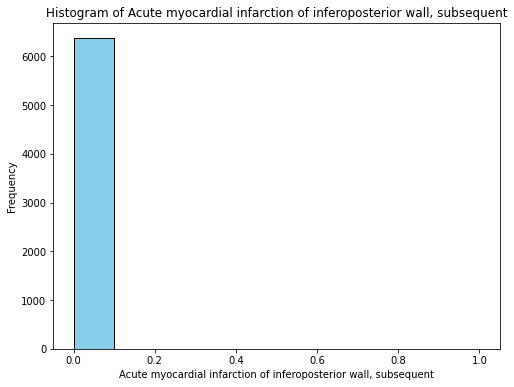

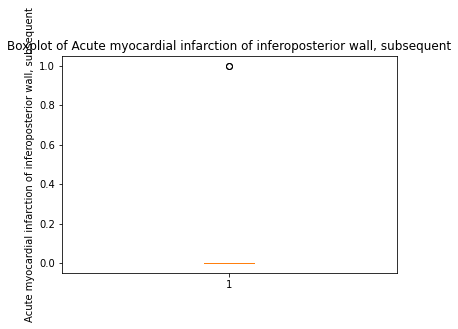

Summary statistics for column: Acute myocardial infarction of other inferior wall, initial epi
count    6377.000000
mean        0.011134
std         0.104936
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other inferior wall, initial epi, dtype: float64


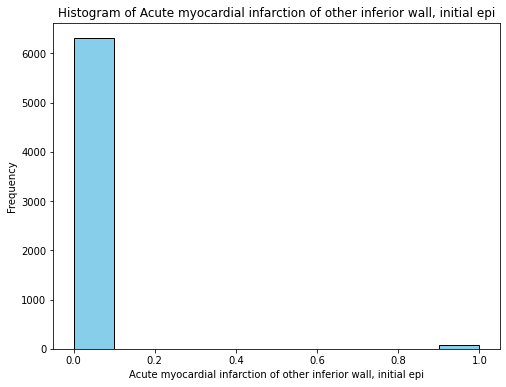

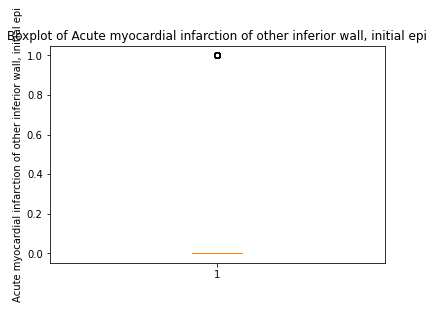

Summary statistics for column: Acute myocardial infarction of other inferior wall, subsequent 
count    6377.000000
mean        0.001568
std         0.039572
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other inferior wall, subsequent , dtype: float64


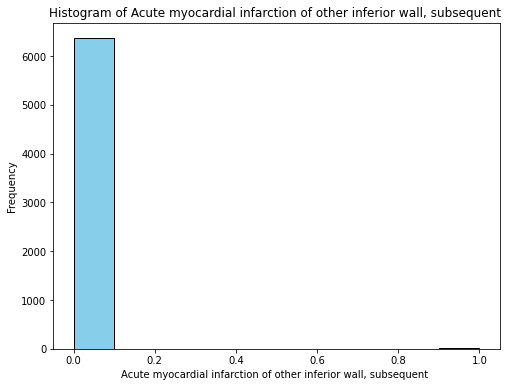

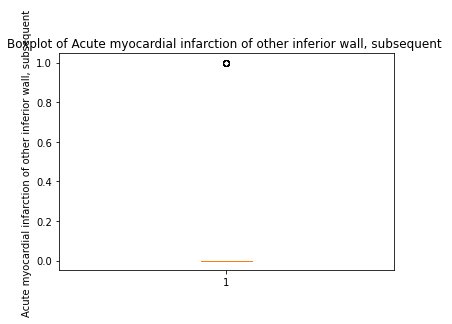

Summary statistics for column: Acute myocardial infarction of other lateral wall, initial epis
count    6377.000000
mean        0.000784
std         0.027992
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other lateral wall, initial epis, dtype: float64


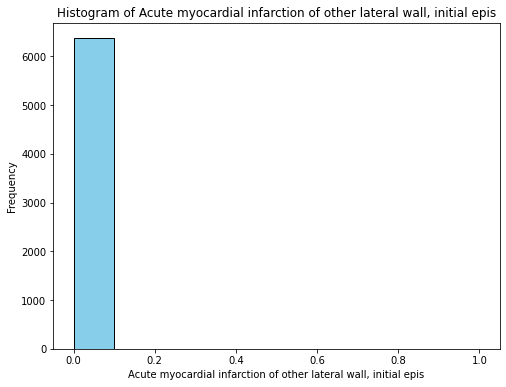

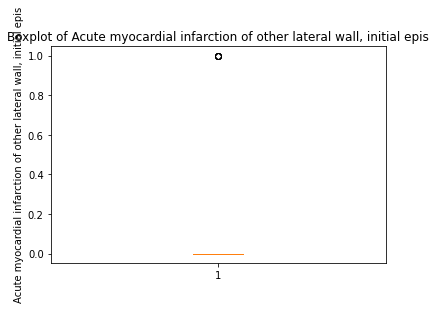

Summary statistics for column: Acute myocardial infarction of other specified sites, initial e
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other specified sites, initial e, dtype: float64


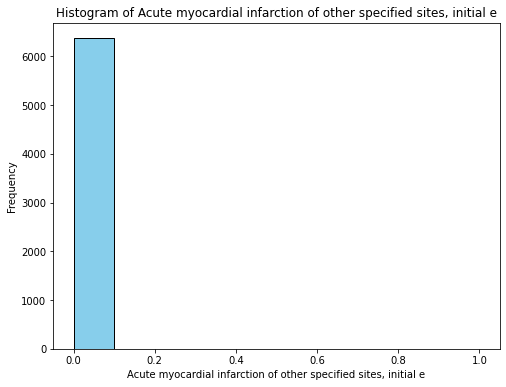

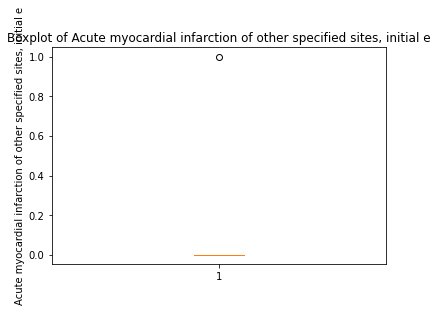

Summary statistics for column: Acute myocardial infarction of other specified sites, subsequen
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of other specified sites, subsequen, dtype: float64


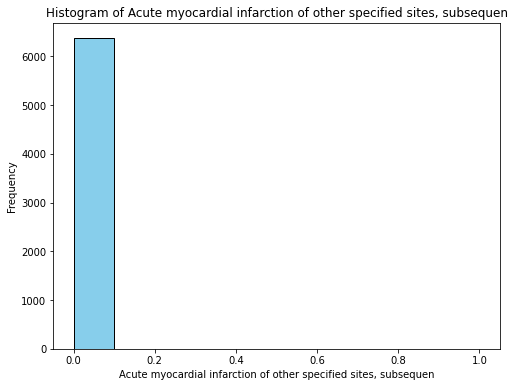

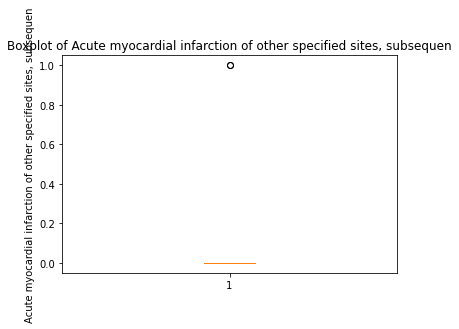

Summary statistics for column: Acute myocardial infarction of unspecified site, episode of car
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of unspecified site, episode of car, dtype: float64


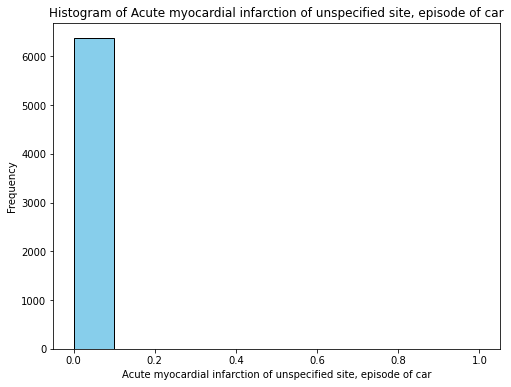

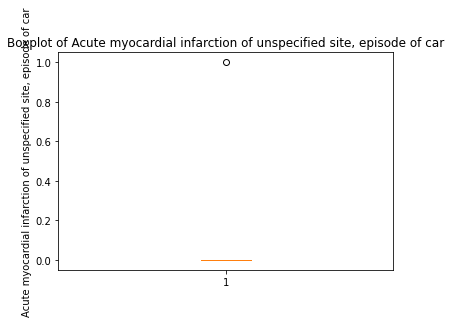

Summary statistics for column: Acute myocardial infarction of unspecified site, initial episod
count    6377.000000
mean        0.005802
std         0.075956
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of unspecified site, initial episod, dtype: float64


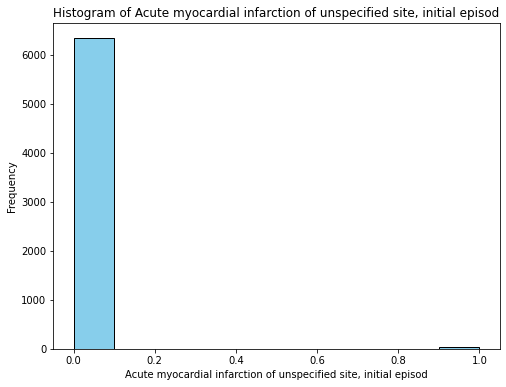

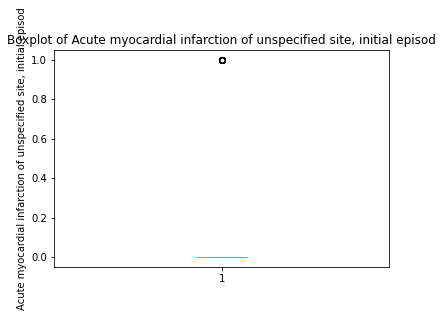

Summary statistics for column: Acute myocardial infarction of unspecified site, subsequent epi
count    6377.000000
mean        0.003450
std         0.058639
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction of unspecified site, subsequent epi, dtype: float64


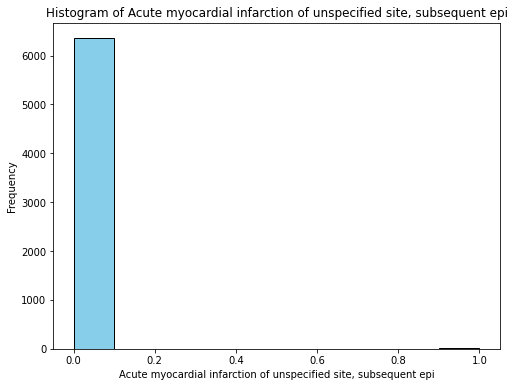

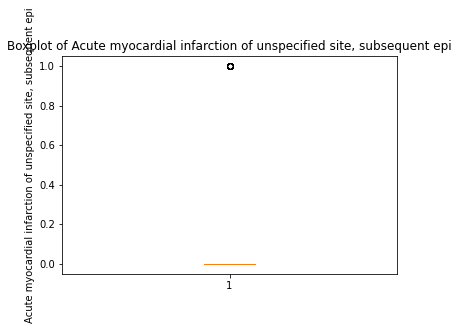

Summary statistics for column: Postmyocardial infarction syndrome
count    6377.000000
mean        0.001411
std         0.037544
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Postmyocardial infarction syndrome, dtype: float64


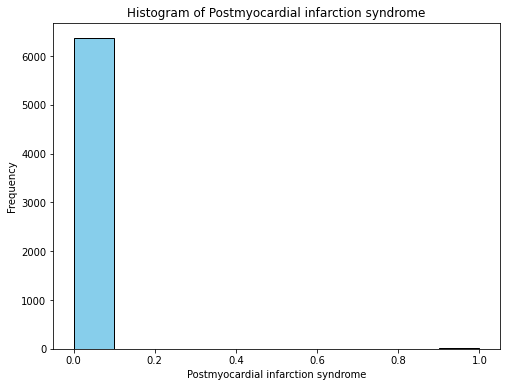

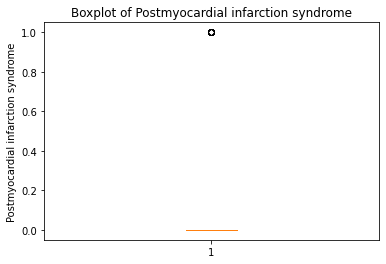

Summary statistics for column: Acute coronary occlusion without myocardial infarction
count    6377.000000
mean        0.000941
std         0.030662
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute coronary occlusion without myocardial infarction, dtype: float64


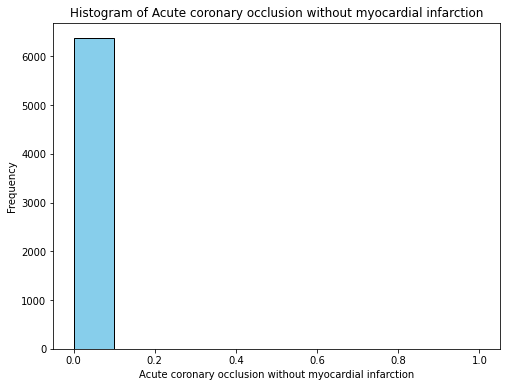

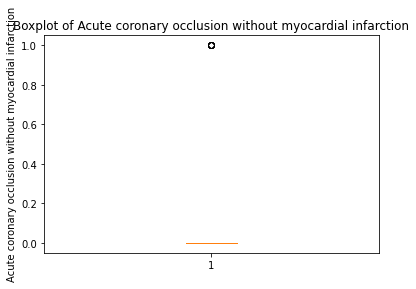

Summary statistics for column: Old myocardial infarction
count    6377.000000
mean        0.169515
std         0.375236
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Old myocardial infarction, dtype: float64


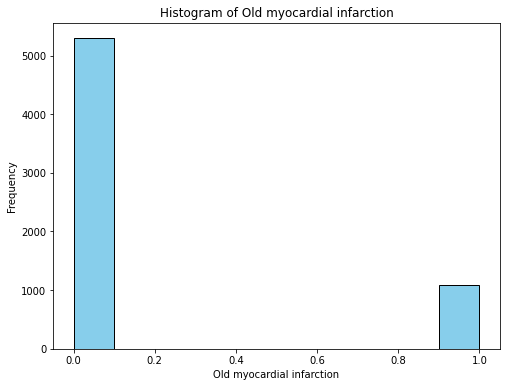

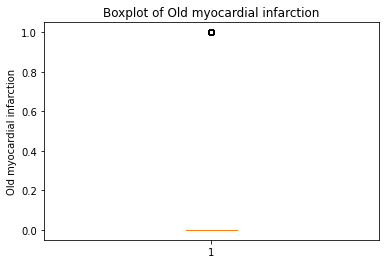

Summary statistics for column: Certain sequelae of myocardial infarction, not elsewhere classi
count    6377.000000
mean        0.001098
std         0.033116
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Certain sequelae of myocardial infarction, not elsewhere classi, dtype: float64


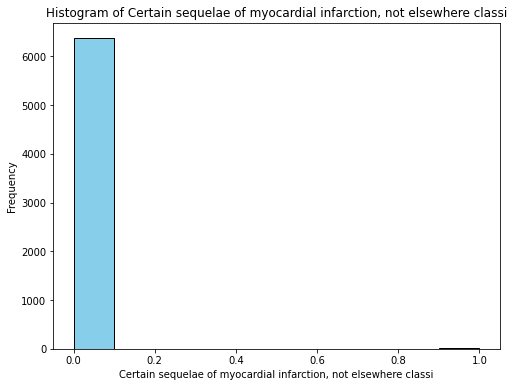

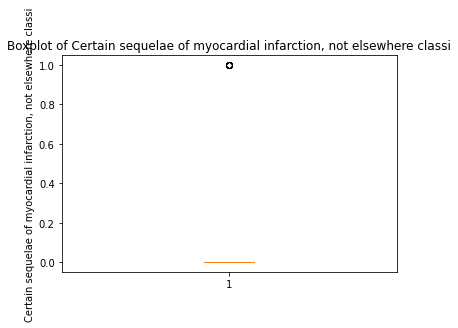

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving left main 
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving left main , dtype: float64


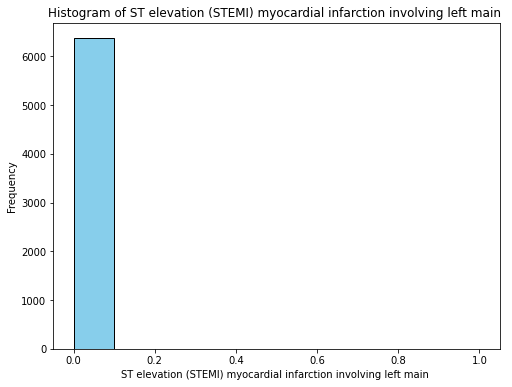

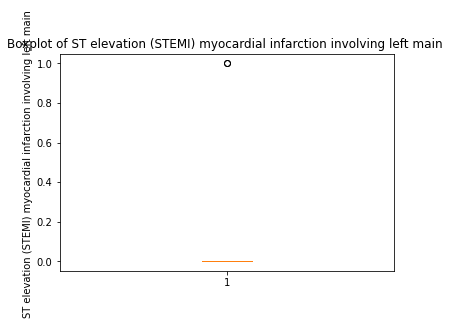

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving left anter
count    6377.000000
mean        0.002039
std         0.045108
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving left anter, dtype: float64


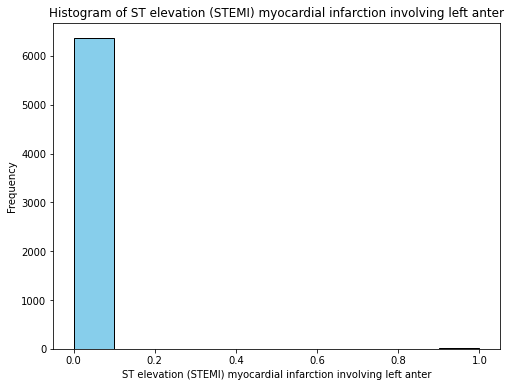

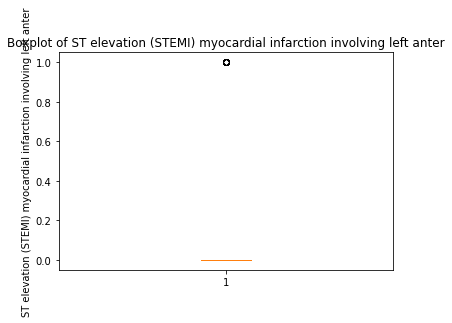

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving other coro
count    6377.000000
mean        0.007841
std         0.088207
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving other coro, dtype: float64


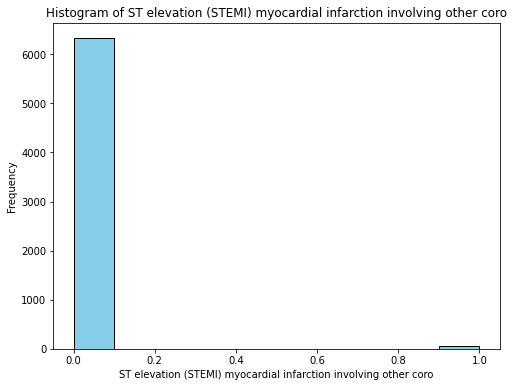

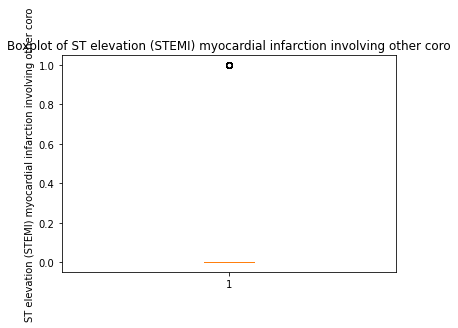

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving right coro
count    6377.000000
mean        0.002509
std         0.050031
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving right coro, dtype: float64


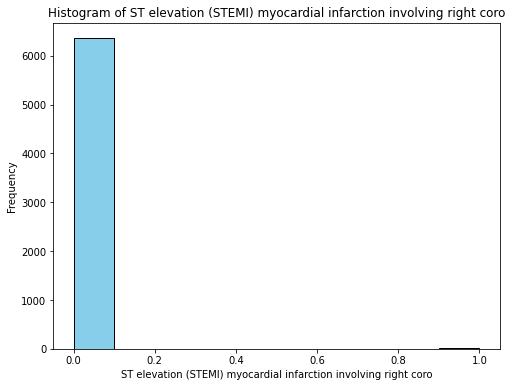

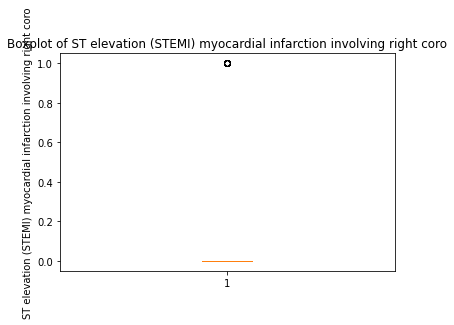

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving other coro-2
count    6377.000000
mean        0.009566
std         0.097343
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving other coro-2, dtype: float64


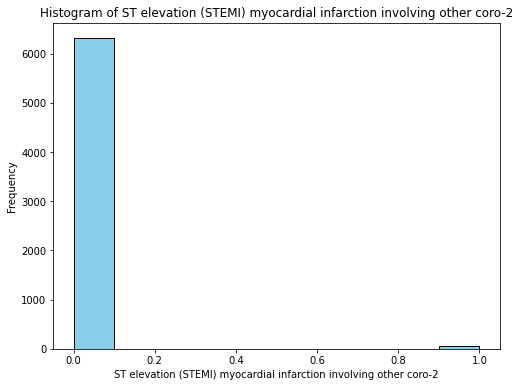

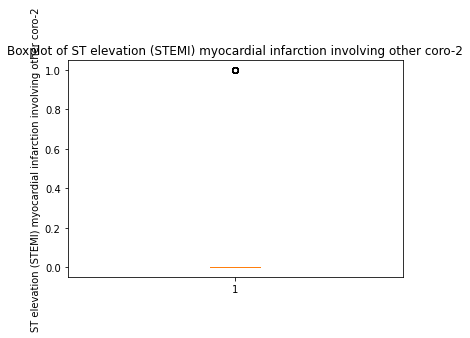

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving left circu
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving left circu, dtype: float64


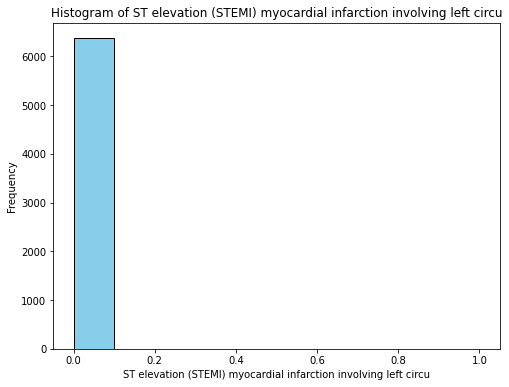

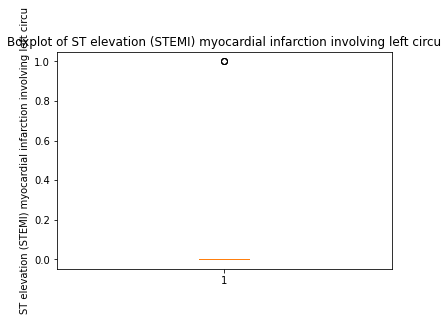

Summary statistics for column: ST elevation (STEMI) myocardial infarction involving other site
count    6377.000000
mean        0.001568
std         0.039572
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction involving other site, dtype: float64


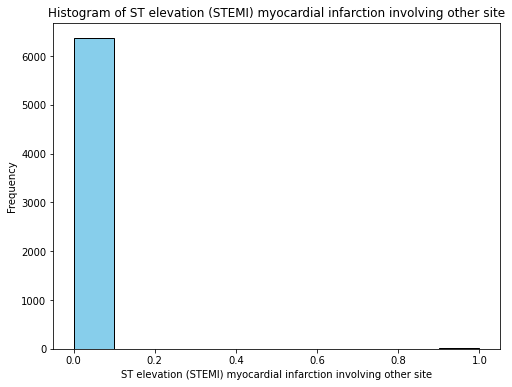

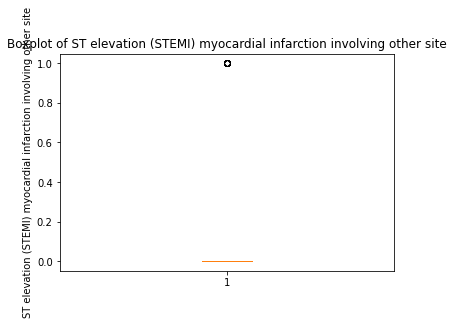

Summary statistics for column: ST elevation (STEMI) myocardial infarction of unspecified site
count    6377.000000
mean        0.005959
std         0.076970
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ST elevation (STEMI) myocardial infarction of unspecified site, dtype: float64


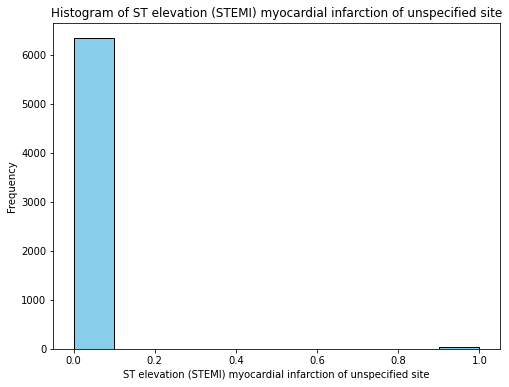

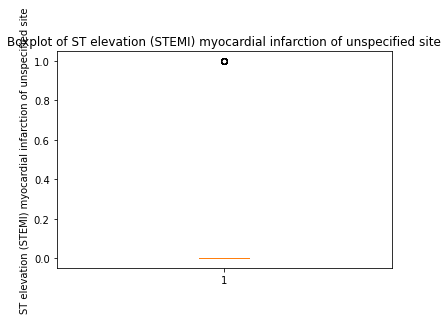

Summary statistics for column: Non-ST elevation (NSTEMI) myocardial infarction
count    6377.000000
mean        0.101145
std         0.301544
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Non-ST elevation (NSTEMI) myocardial infarction, dtype: float64


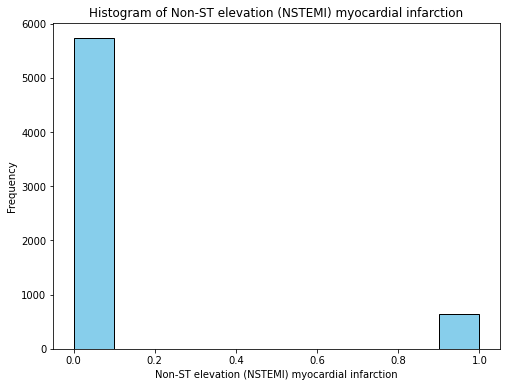

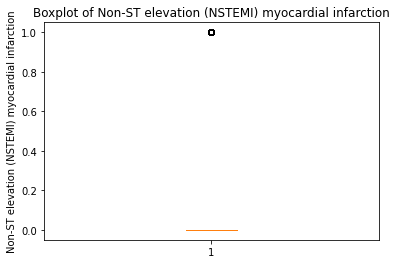

Summary statistics for column: Acute myocardial infarction, unspecified
count    6377.000000
mean        0.000627
std         0.025039
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute myocardial infarction, unspecified, dtype: float64


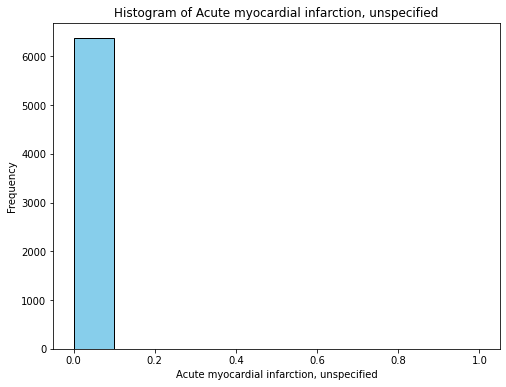

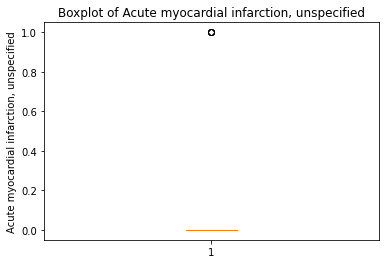

Summary statistics for column: Myocardial infarction type 2
count    6377.000000
mean        0.035283
std         0.184509
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Myocardial infarction type 2, dtype: float64


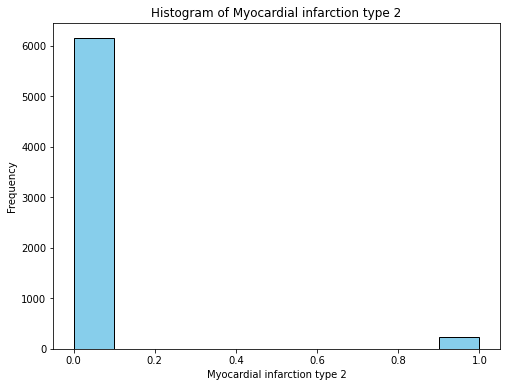

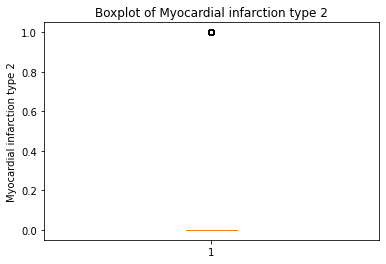

Summary statistics for column: Other myocardial infarction type
count    6377.000000
mean        0.000627
std         0.025039
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other myocardial infarction type, dtype: float64


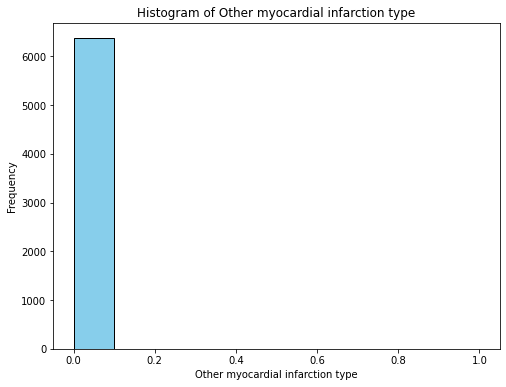

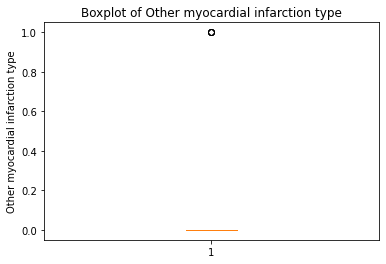

Summary statistics for column: Subsequent ST elevation (STEMI) myocardial infarction of inferi
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Subsequent ST elevation (STEMI) myocardial infarction of inferi, dtype: float64


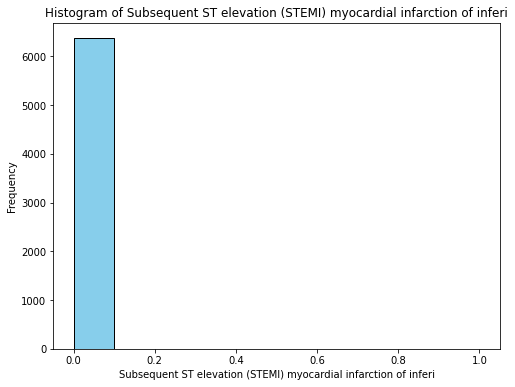

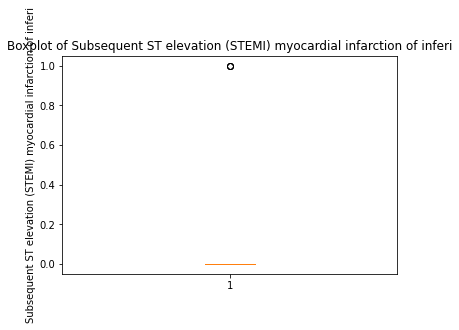

Summary statistics for column: Subsequent non-ST elevation (NSTEMI) myocardial infarction
count    6377.000000
mean        0.004234
std         0.064936
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Subsequent non-ST elevation (NSTEMI) myocardial infarction, dtype: float64


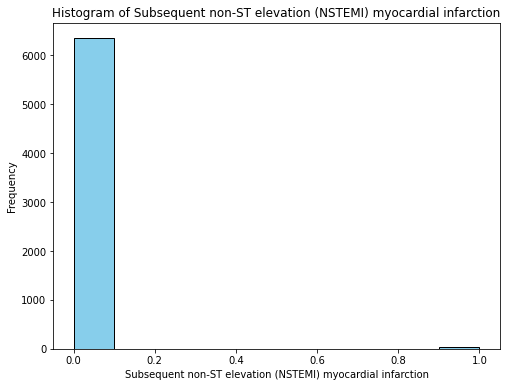

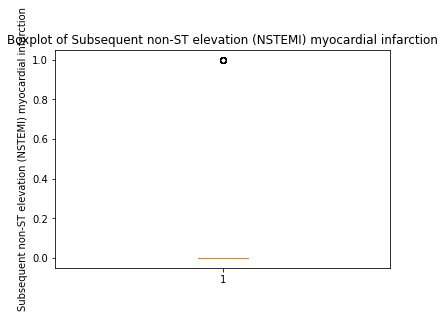

Summary statistics for column: Subsequent ST elevation (STEMI) myocardial infarction of other 
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Subsequent ST elevation (STEMI) myocardial infarction of other , dtype: float64


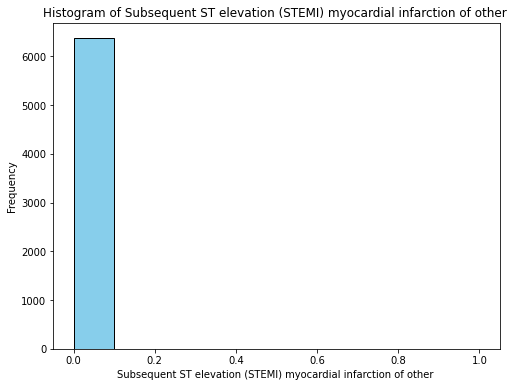

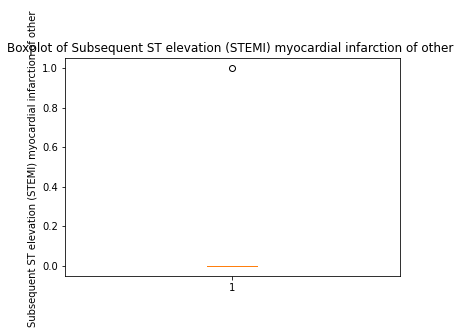

Summary statistics for column: Subsequent ST elevation (STEMI) myocardial infarction of unspec
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Subsequent ST elevation (STEMI) myocardial infarction of unspec, dtype: float64


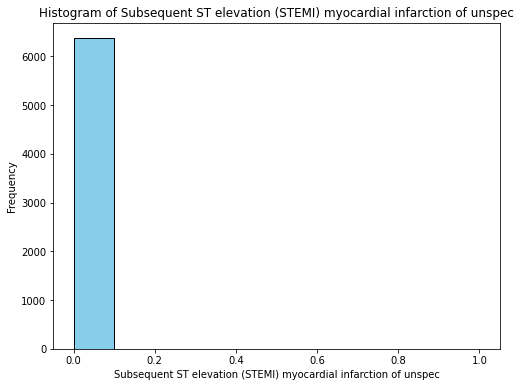

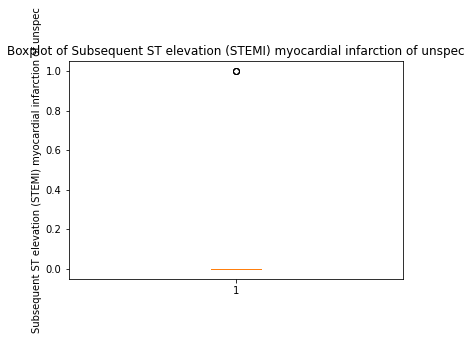

Summary statistics for column: Ventricular septal defect as current complication following acu
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Ventricular septal defect as current complication following acu, dtype: float64


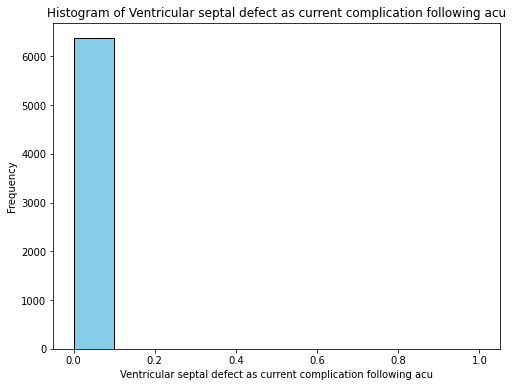

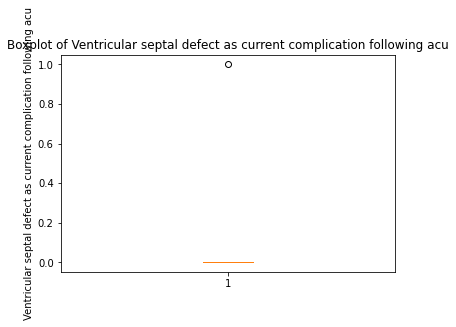

Summary statistics for column: Rupture of papillary muscle as current complication following a
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Rupture of papillary muscle as current complication following a, dtype: float64


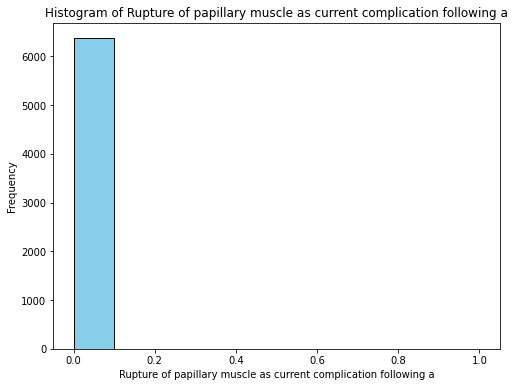

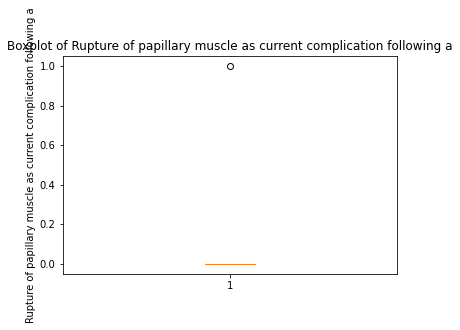

Summary statistics for column: Thrombosis of atrium, auricular appendage, and ventricle as cur
count    6377.000000
mean        0.001725
std         0.041500
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Thrombosis of atrium, auricular appendage, and ventricle as cur, dtype: float64


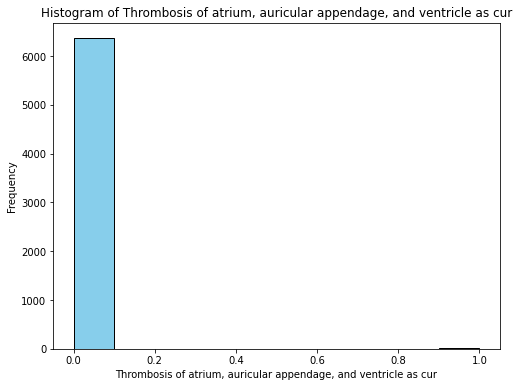

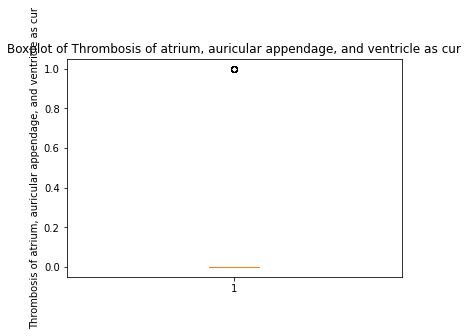

Summary statistics for column: Acute coronary thrombosis not resulting in myocardial infarctio
count    6377.000000
mean        0.001255
std         0.035400
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute coronary thrombosis not resulting in myocardial infarctio, dtype: float64


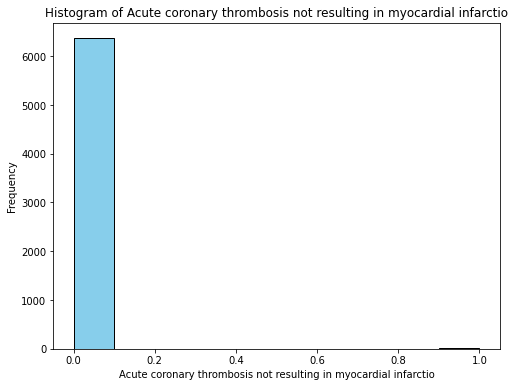

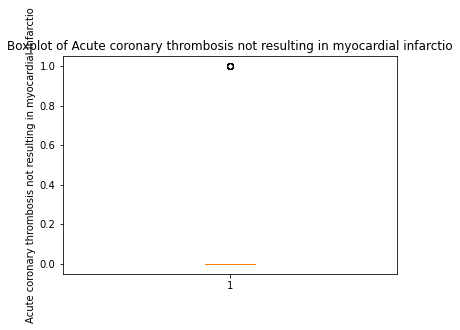

Summary statistics for column: Old myocardial infarction-2
count    6377.000000
mean        0.163086
std         0.369473
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Old myocardial infarction-2, dtype: float64


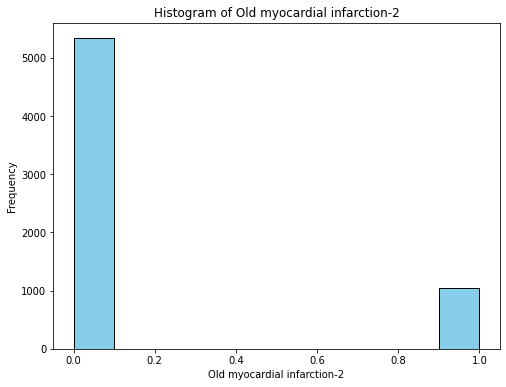

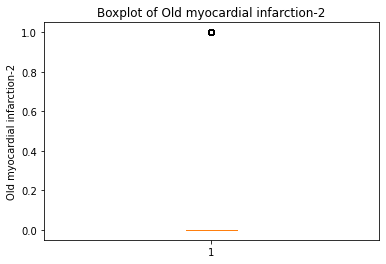

Summary statistics for column: Rheumatic heart failure (congestive)
count    6377.000000
mean        0.003136
std         0.055919
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Rheumatic heart failure (congestive), dtype: float64


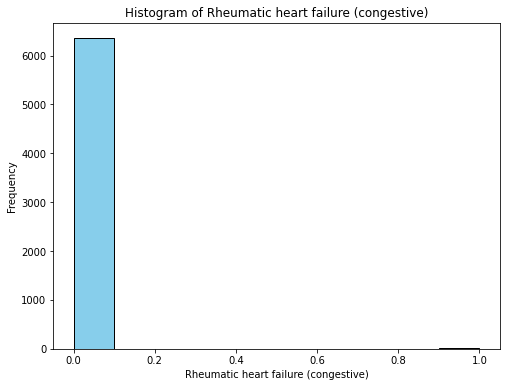

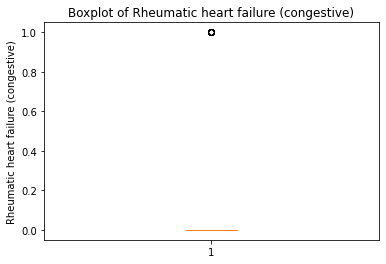

Summary statistics for column: Congestive heart failure, unspecified
count    6377.000000
mean        0.292614
std         0.454998
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: Congestive heart failure, unspecified, dtype: float64


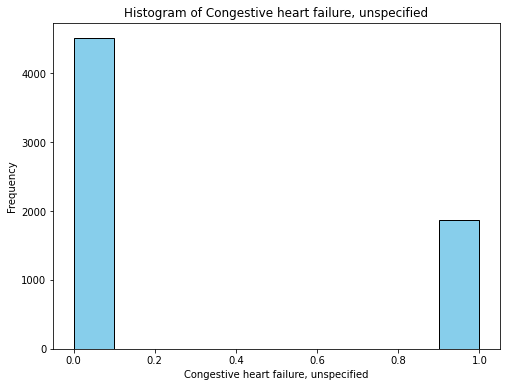

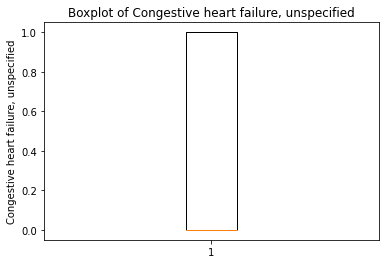

Summary statistics for column: Unspecified systolic (congestive) heart failure
count    6377.000000
mean        0.022581
std         0.148576
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified systolic (congestive) heart failure, dtype: float64


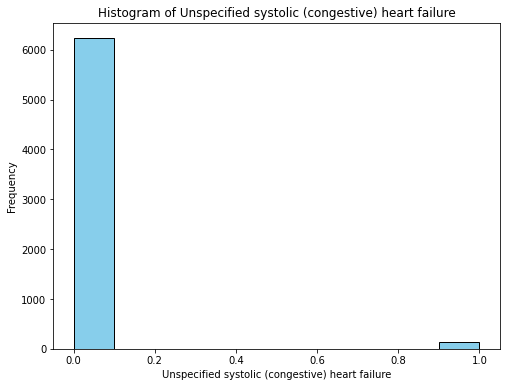

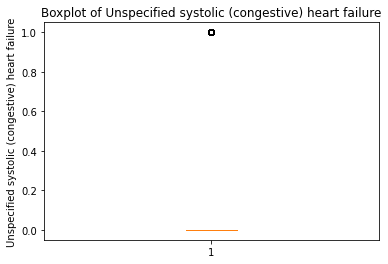

Summary statistics for column: Acute systolic (congestive) heart failure
count    6377.000000
mean        0.026031
std         0.159240
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute systolic (congestive) heart failure, dtype: float64


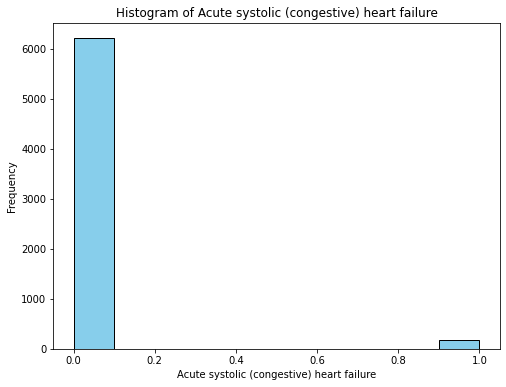

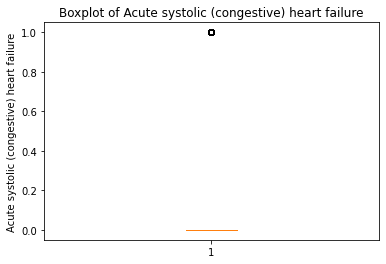

Summary statistics for column: Chronic systolic (congestive) heart failure
count    6377.000000
mean        0.094872
std         0.293061
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic systolic (congestive) heart failure, dtype: float64


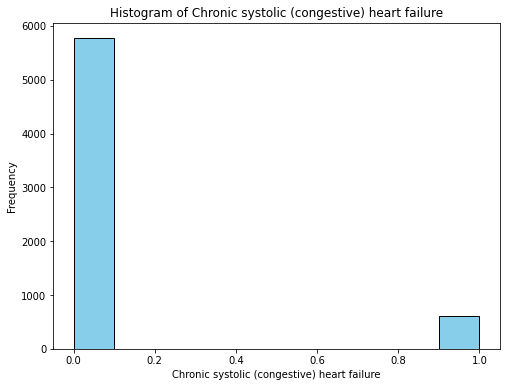

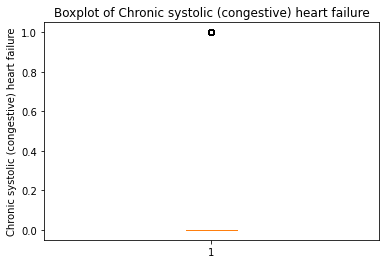

Summary statistics for column: Acute on chronic systolic (congestive) heart failure
count    6377.000000
mean        0.090952
std         0.287563
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute on chronic systolic (congestive) heart failure, dtype: float64


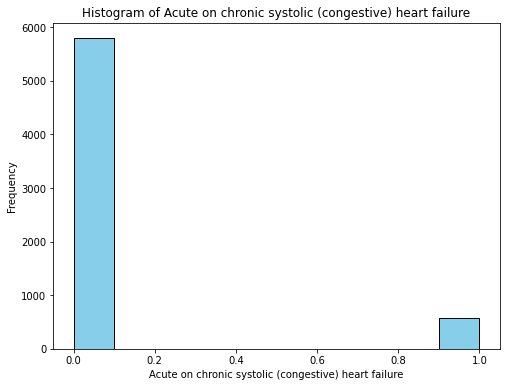

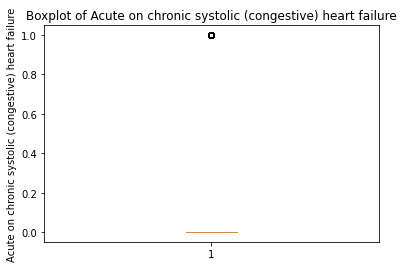

Summary statistics for column: Unspecified diastolic (congestive) heart failure
count    6377.000000
mean        0.020229
std         0.140794
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified diastolic (congestive) heart failure, dtype: float64


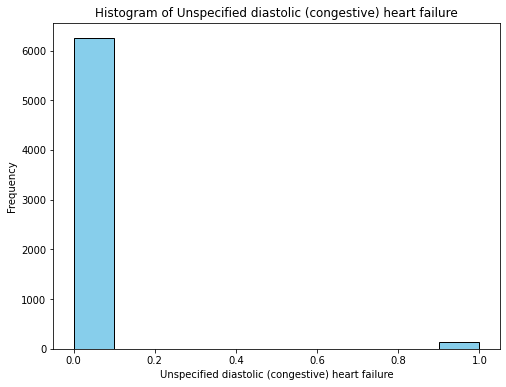

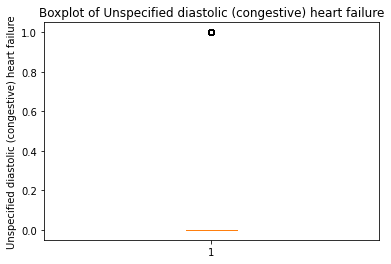

Summary statistics for column: Acute diastolic (congestive) heart failure
count    6377.000000
mean        0.009566
std         0.097343
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute diastolic (congestive) heart failure, dtype: float64


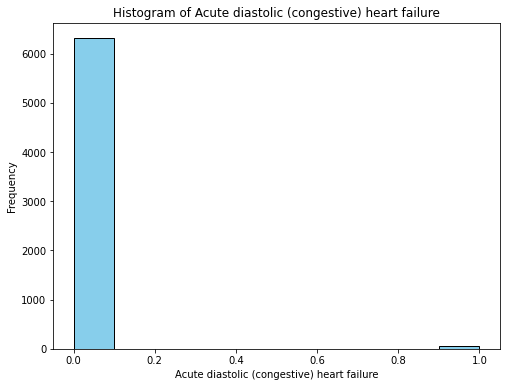

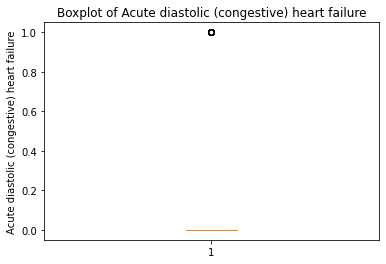

Summary statistics for column: Chronic diastolic (congestive) heart failure
count    6377.000000
mean        0.073546
std         0.261050
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic diastolic (congestive) heart failure, dtype: float64


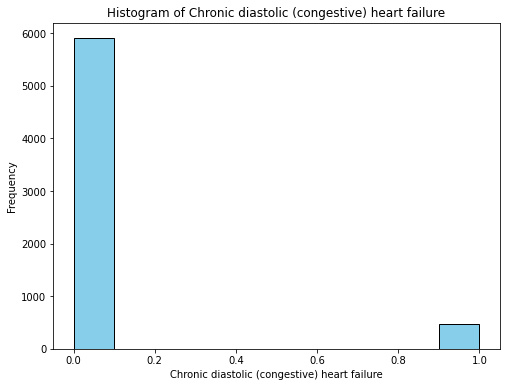

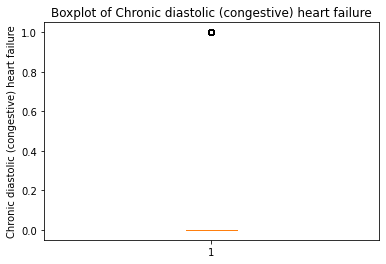

Summary statistics for column: Acute on chronic diastolic (congestive) heart failure
count    6377.000000
mean        0.066803
std         0.249699
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute on chronic diastolic (congestive) heart failure, dtype: float64


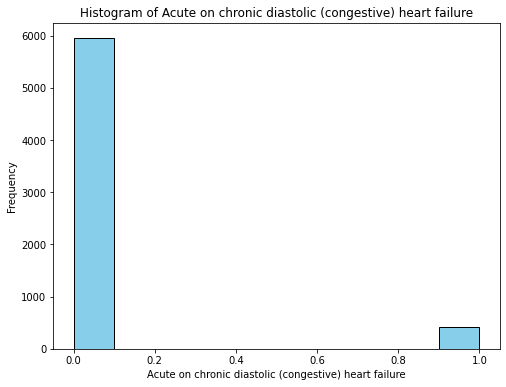

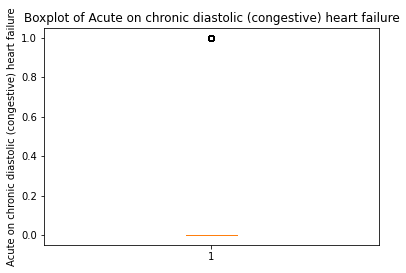

Summary statistics for column: Unspecified combined systolic (congestive) and diastolic (conge
count    6377.000000
mean        0.001255
std         0.035400
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified combined systolic (congestive) and diastolic (conge, dtype: float64


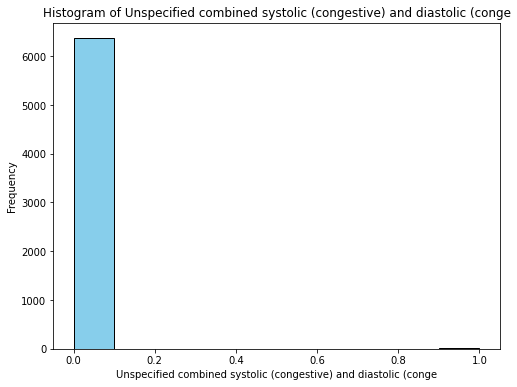

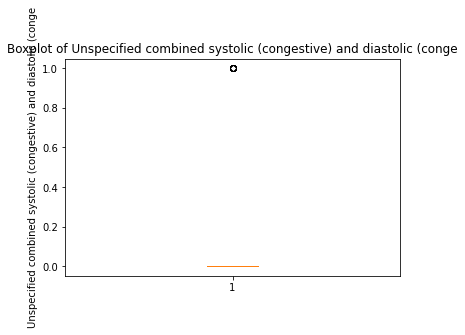

Summary statistics for column: Acute combined systolic (congestive) and diastolic (congestive)
count    6377.000000
mean        0.002979
std         0.054507
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute combined systolic (congestive) and diastolic (congestive), dtype: float64


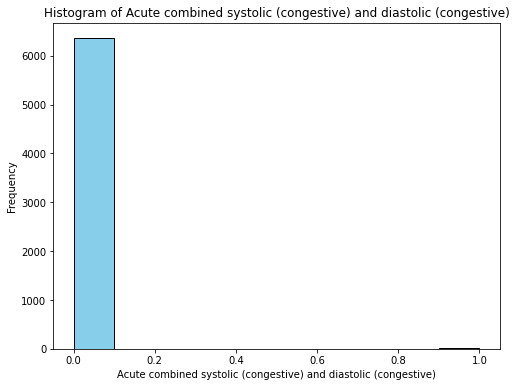

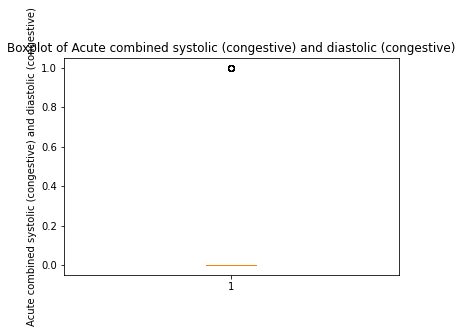

Summary statistics for column: Chronic combined systolic (congestive) and diastolic (congestiv
count    6377.000000
mean        0.012231
std         0.109926
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic combined systolic (congestive) and diastolic (congestiv, dtype: float64


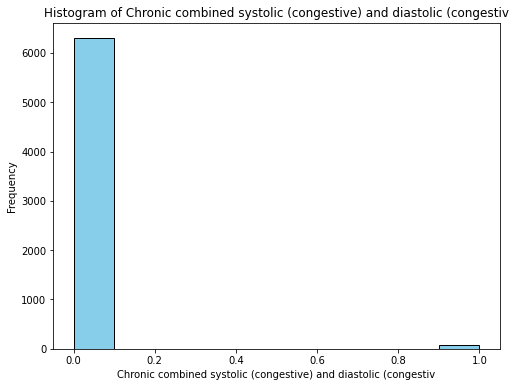

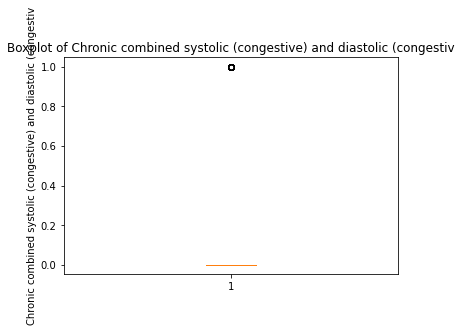

Summary statistics for column: Acute on chronic combined systolic (congestive) and diastolic (
count    6377.000000
mean        0.022738
std         0.149079
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Acute on chronic combined systolic (congestive) and diastolic (, dtype: float64


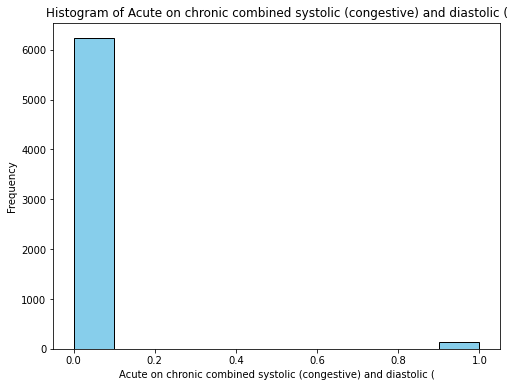

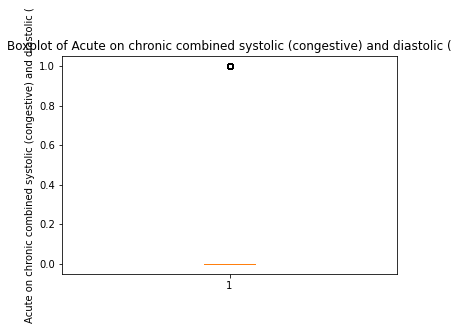

Summary statistics for column: Atrial fibrillation
count    6377.000000
mean        0.263290
std         0.440453
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: Atrial fibrillation, dtype: float64


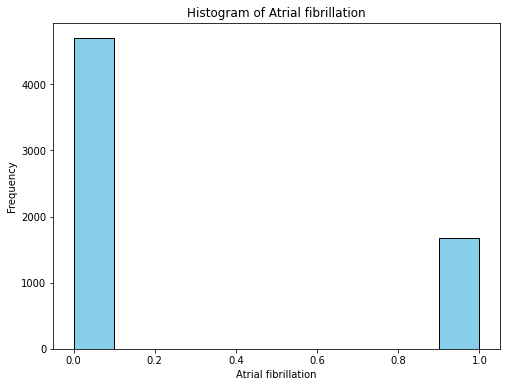

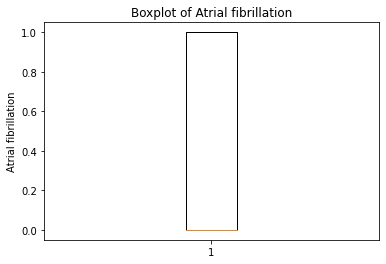

Summary statistics for column: Paroxysmal atrial fibrillation
count    6377.000000
mean        0.107574
std         0.309866
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Paroxysmal atrial fibrillation, dtype: float64


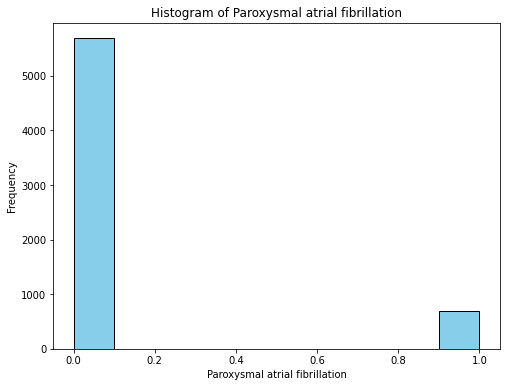

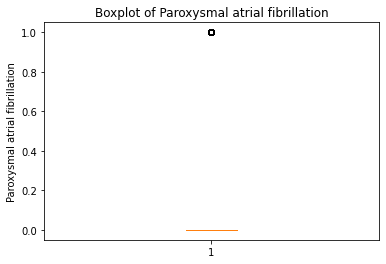

Summary statistics for column: Persistent atrial fibrillation
count    6377.000000
mean        0.019288
std         0.137546
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Persistent atrial fibrillation, dtype: float64


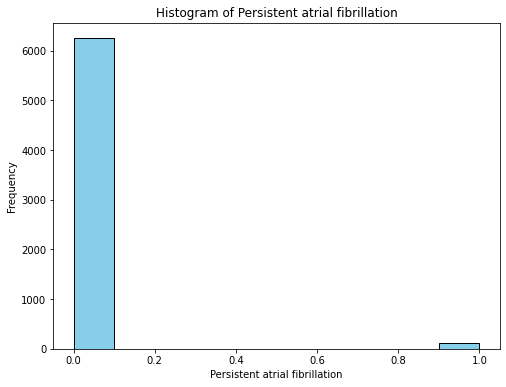

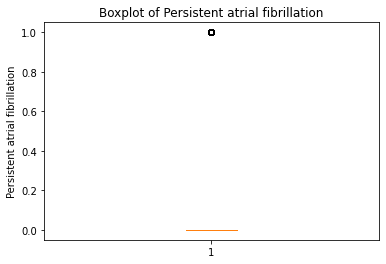

Summary statistics for column: Longstanding persistent atrial fibrillation
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Longstanding persistent atrial fibrillation, dtype: float64


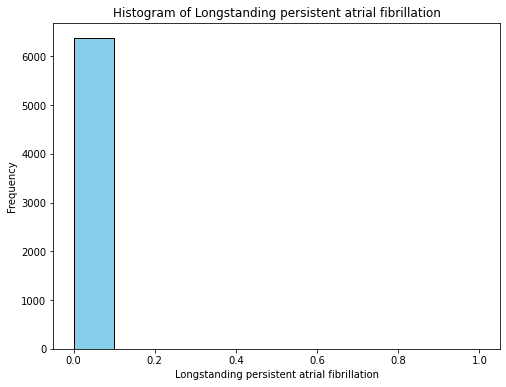

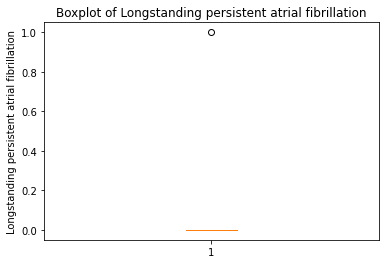

Summary statistics for column: Other persistent atrial fibrillation
count    6377.000000
mean        0.001568
std         0.039572
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other persistent atrial fibrillation, dtype: float64


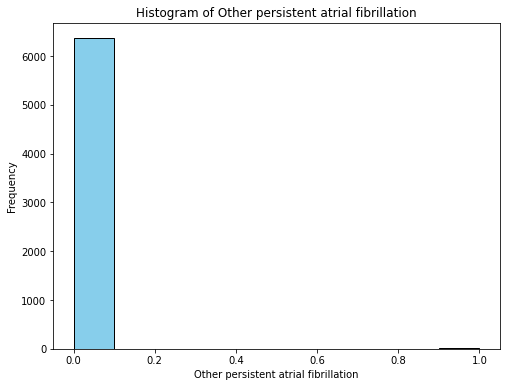

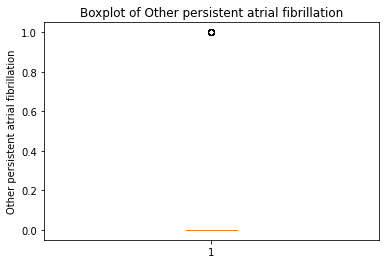

Summary statistics for column: Chronic atrial fibrillation
count    6377.000000
mean        0.045319
std         0.208019
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic atrial fibrillation, dtype: float64


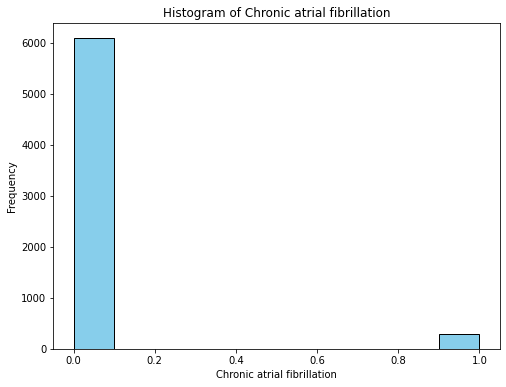

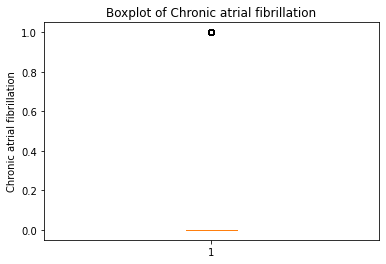

Summary statistics for column: Chronic atrial fibrillation, unspecified
count    6377.000000
mean        0.003607
std         0.059952
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic atrial fibrillation, unspecified, dtype: float64


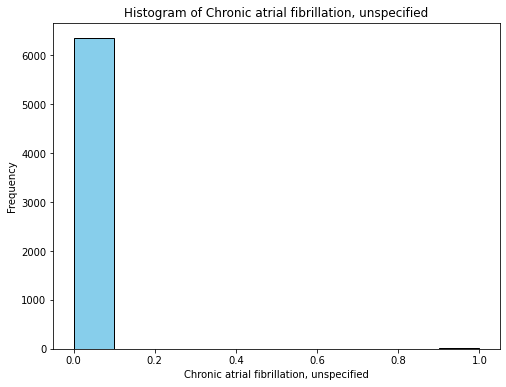

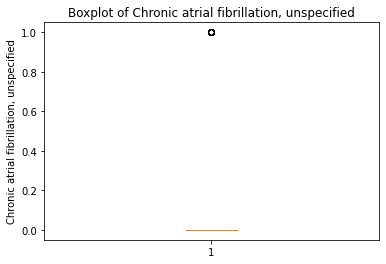

Summary statistics for column: Permanent atrial fibrillation
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Permanent atrial fibrillation, dtype: float64


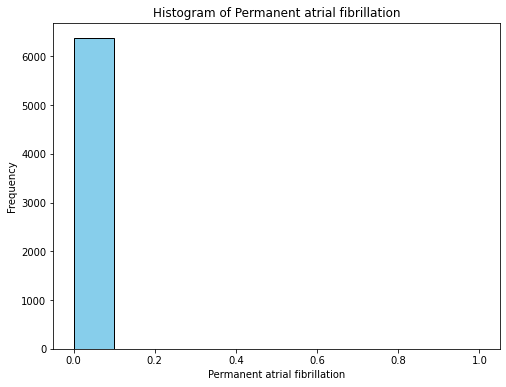

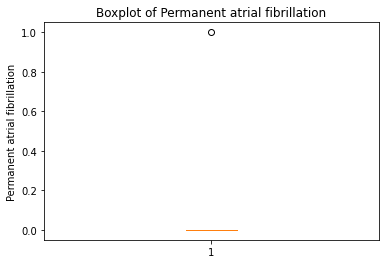

Summary statistics for column: Unspecified atrial fibrillation
count    6377.000000
mean        0.181904
std         0.385795
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified atrial fibrillation, dtype: float64


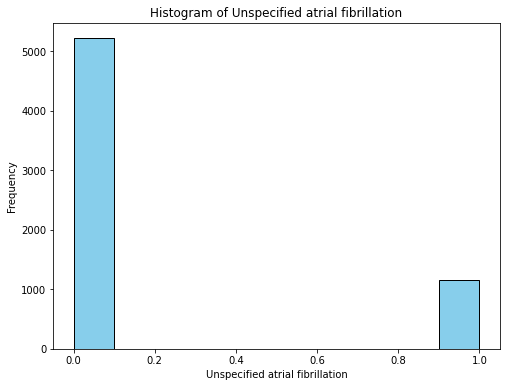

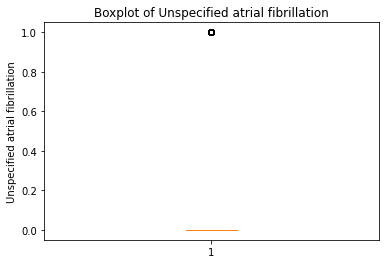

Summary statistics for column: Chronic obstructive pulmonary disease with (acute) lower respir
count    6377.000000
mean        0.010820
std         0.103464
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease with (acute) lower respir, dtype: float64


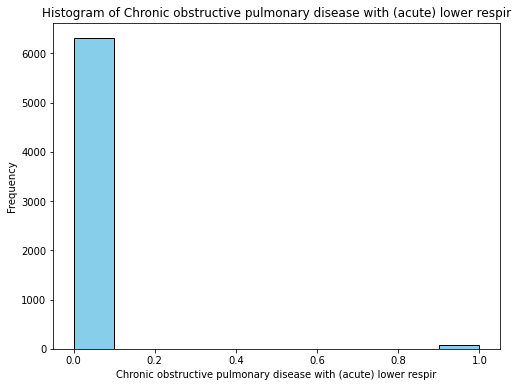

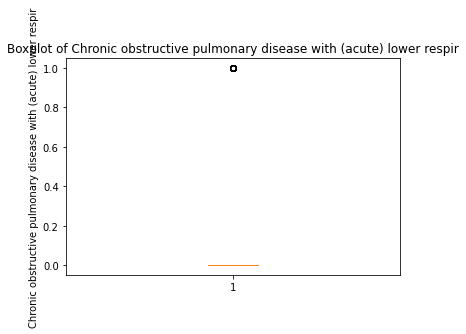

Summary statistics for column: Chronic obstructive pulmonary disease with (acute) exacerbation
count    6377.000000
mean        0.025090
std         0.156411
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease with (acute) exacerbation, dtype: float64


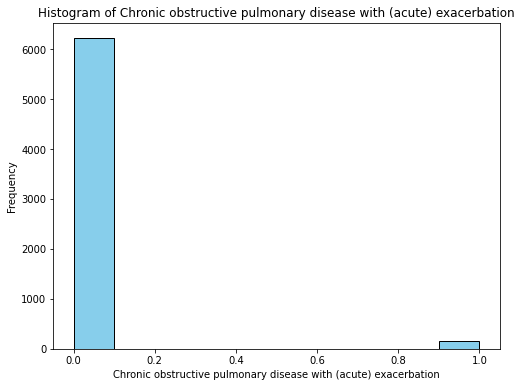

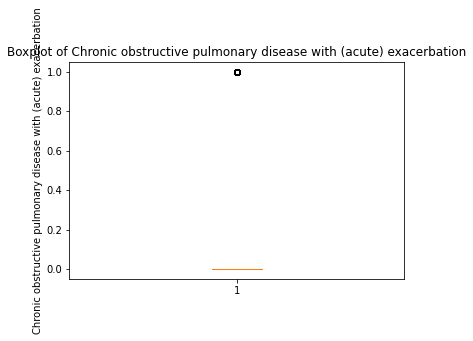

Summary statistics for column: Chronic obstructive pulmonary disease, unspecified
count    6377.000000
mean        0.104438
std         0.305852
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease, unspecified, dtype: float64


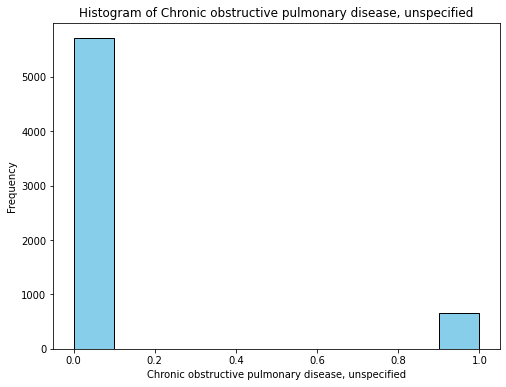

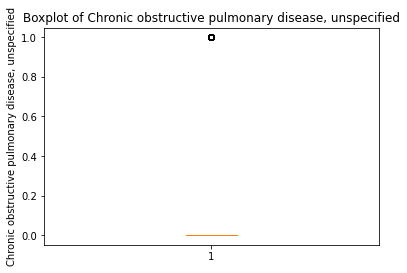

Summary statistics for column: Heat stroke and sunstroke
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Heat stroke and sunstroke, dtype: float64


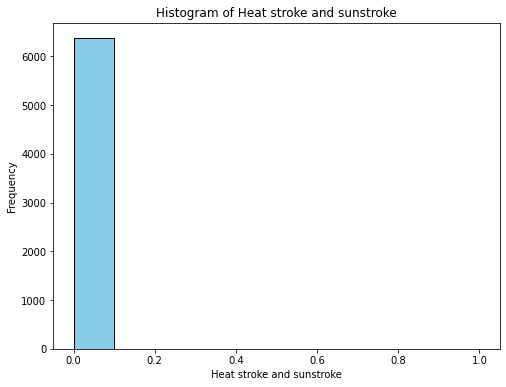

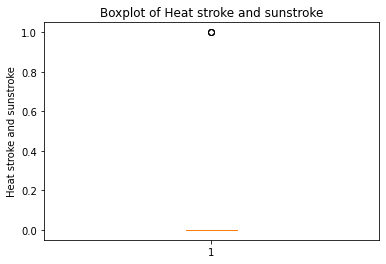

Summary statistics for column: Cerebellar stroke syndrome
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Cerebellar stroke syndrome, dtype: float64


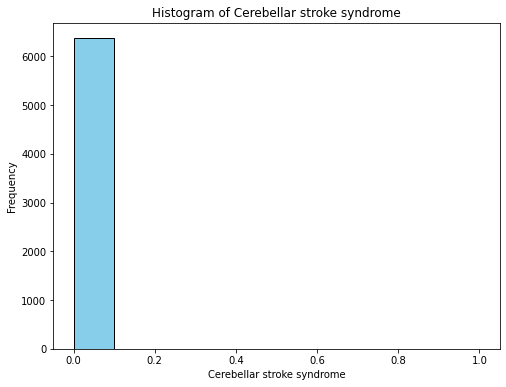

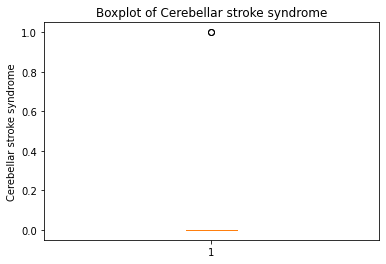

Summary statistics for column: Heatstroke and sunstroke, initial encounter-2
count    6377.000000
mean        0.000627
std         0.025039
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Heatstroke and sunstroke, initial encounter-2, dtype: float64


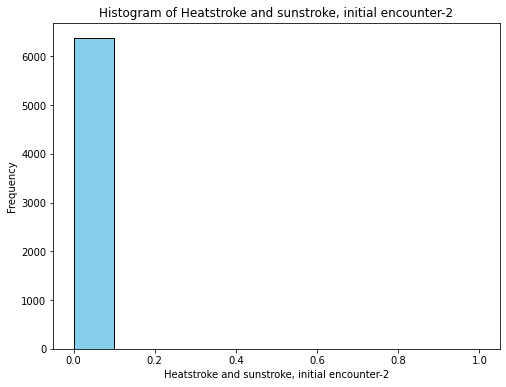

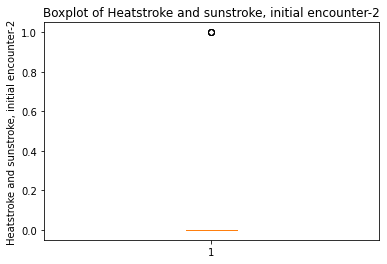

Summary statistics for column: Family history of stroke (cerebrovascular)
count    6377.000000
mean        0.018661
std         0.135335
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Family history of stroke (cerebrovascular), dtype: float64


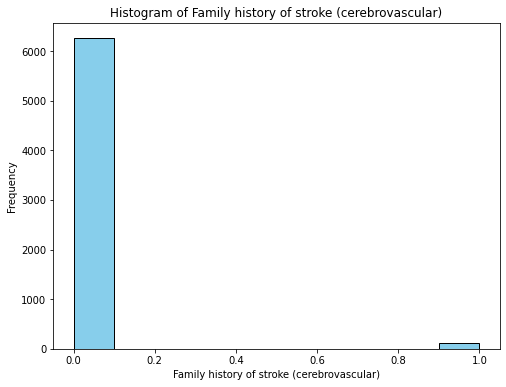

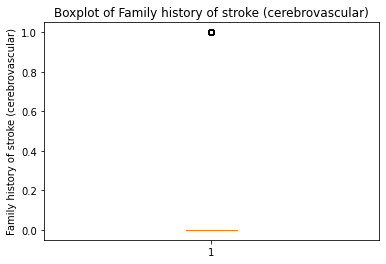

Summary statistics for column: Family history of stroke
count    6377.000000
mean        0.018661
std         0.135335
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Family history of stroke, dtype: float64


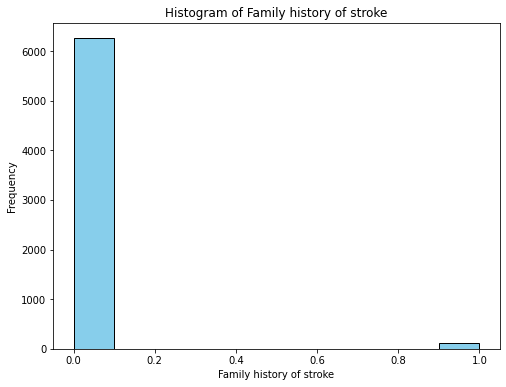

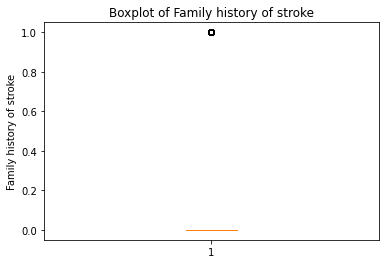

Summary statistics for column: Mixed hyperlipidemia
count    6377.000000
mean        0.000784
std         0.027992
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Mixed hyperlipidemia, dtype: float64


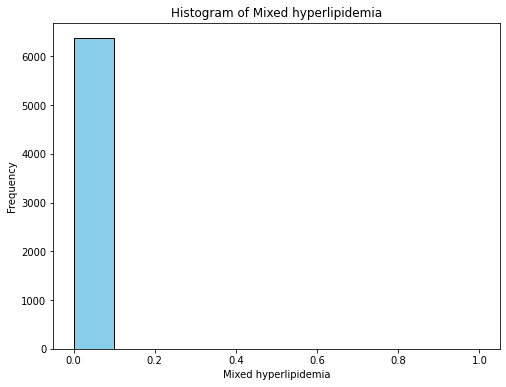

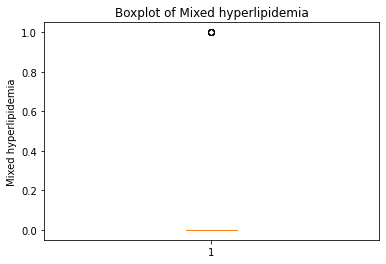

Summary statistics for column: Other and unspecified hyperlipidemia
count    6377.000000
mean        0.411008
std         0.492055
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: Other and unspecified hyperlipidemia, dtype: float64


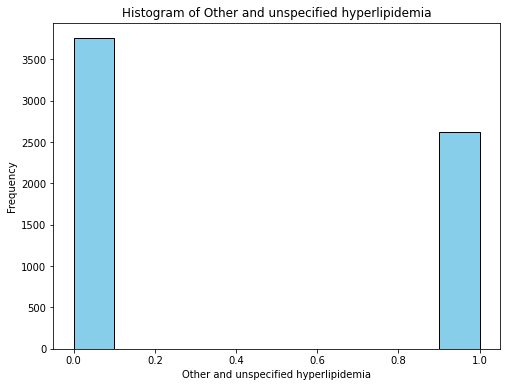

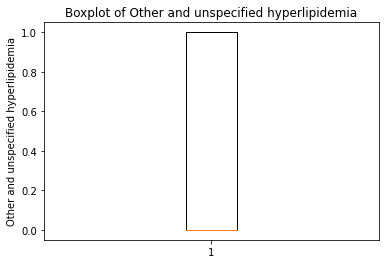

Summary statistics for column: Mixed hyperlipidemia-2
count    6377.000000
mean        0.005332
std         0.072829
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Mixed hyperlipidemia-2, dtype: float64


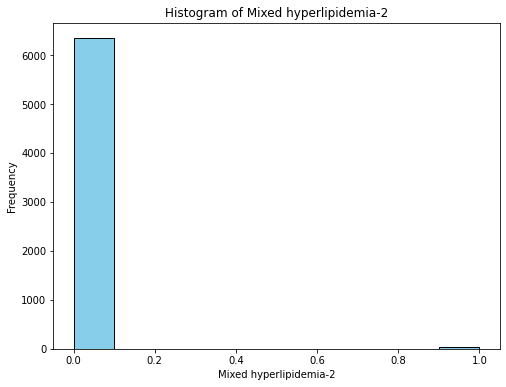

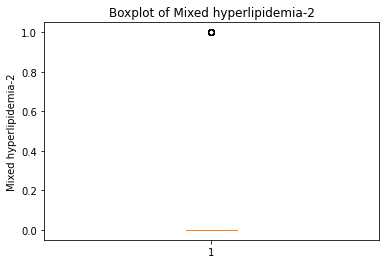

Summary statistics for column: Other hyperlipidemia
count    6377.000000
mean        0.000627
std         0.025039
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other hyperlipidemia, dtype: float64


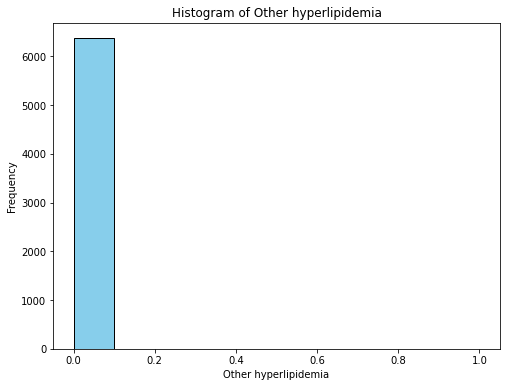

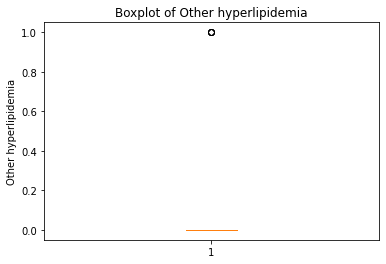

Summary statistics for column: Other hyperlipidemia-2
count    6377.000000
mean        0.011918
std         0.108525
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other hyperlipidemia-2, dtype: float64


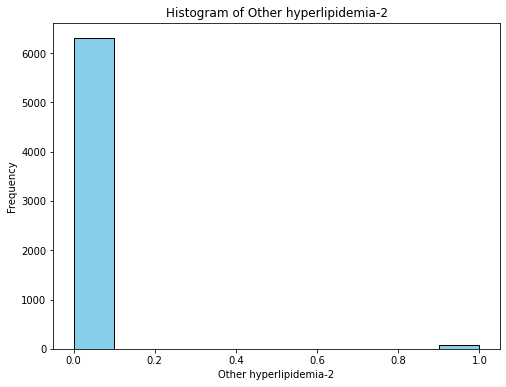

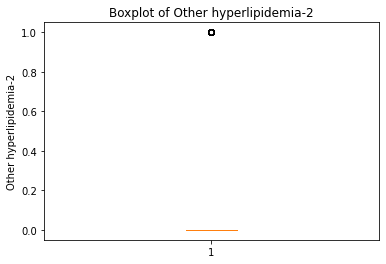

Summary statistics for column: Hyperlipidemia, unspecified
count    6377.000000
mean        0.413204
std         0.492447
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: Hyperlipidemia, unspecified, dtype: float64


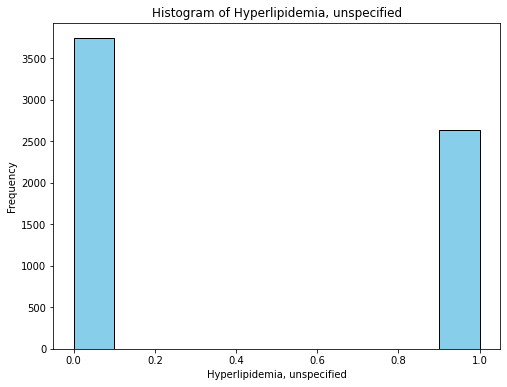

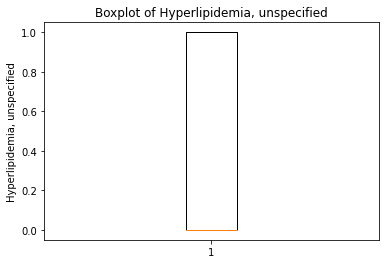

Summary statistics for column: Chronic obstructive pulmonary disease with (acute) lower respir-2
count    6377.000000
mean        0.010820
std         0.103464
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease with (acute) lower respir-2, dtype: float64


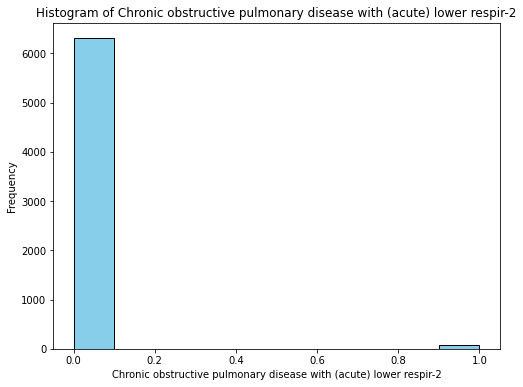

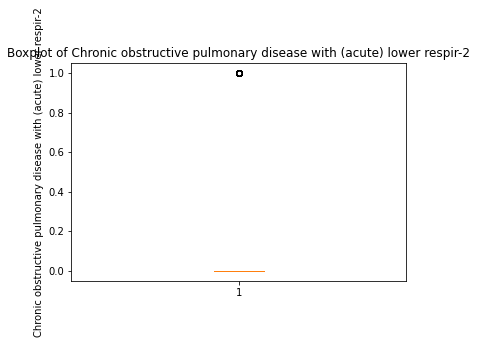

Summary statistics for column: Chronic obstructive pulmonary disease with (acute) exacerbation-2
count    6377.000000
mean        0.025090
std         0.156411
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease with (acute) exacerbation-2, dtype: float64


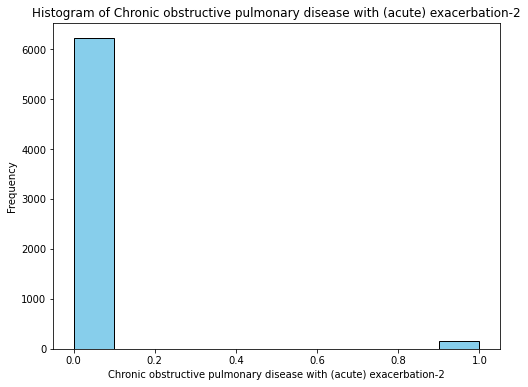

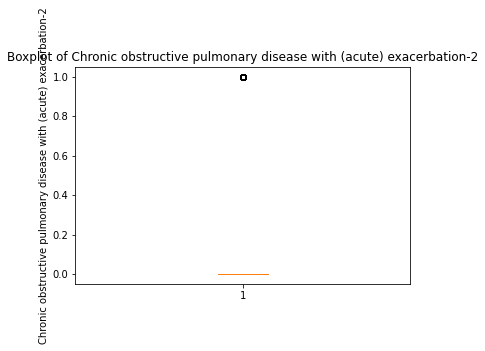

Summary statistics for column: Chronic obstructive pulmonary disease, unspecified-2
count    6377.000000
mean        0.104438
std         0.305852
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Chronic obstructive pulmonary disease, unspecified-2, dtype: float64


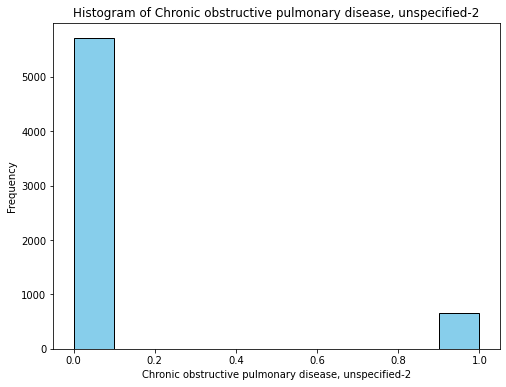

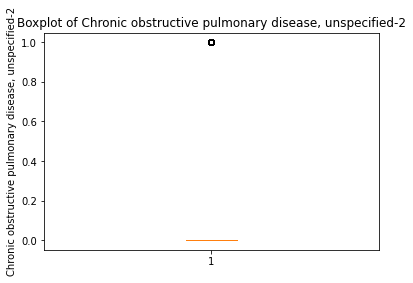

Summary statistics for column: Senile dementia, uncomplicated
count    6377.000000
mean        0.001568
std         0.039572
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Senile dementia, uncomplicated, dtype: float64


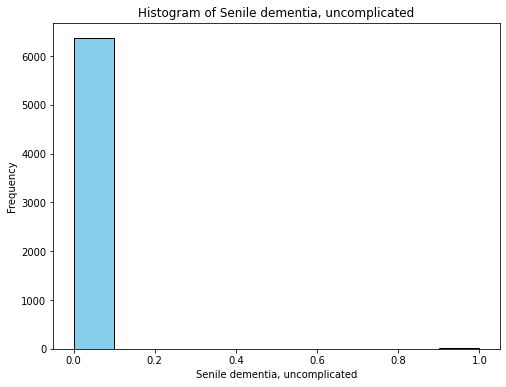

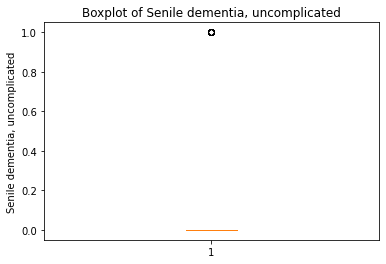

Summary statistics for column: Presenile dementia, uncomplicated
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Presenile dementia, uncomplicated, dtype: float64


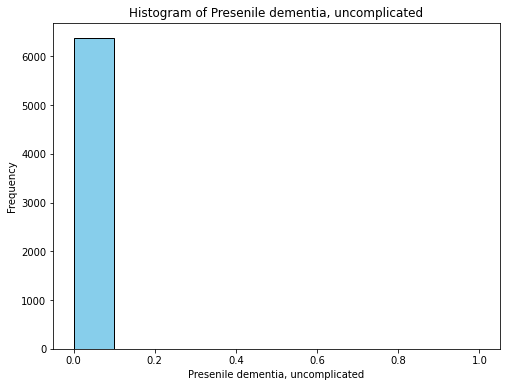

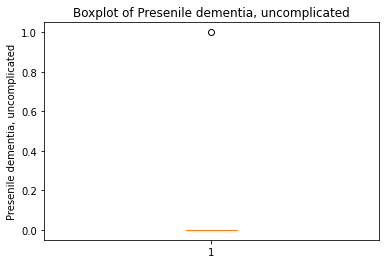

Summary statistics for column: Presenile dementia with delusional features
count    6377.000000
mean        0.000784
std         0.027992
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Presenile dementia with delusional features, dtype: float64


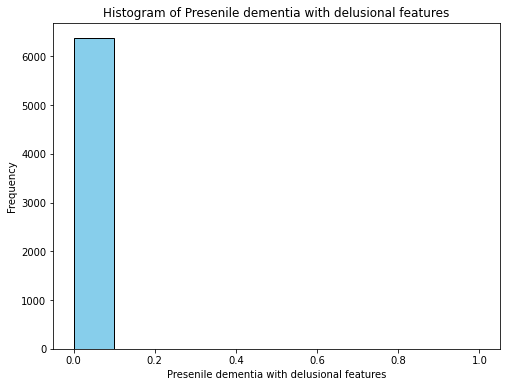

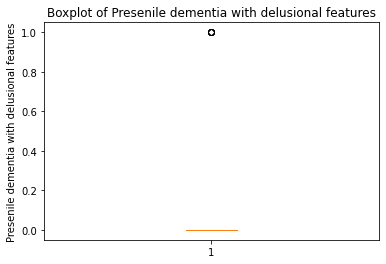

Summary statistics for column: Senile dementia with delirium
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Senile dementia with delirium, dtype: float64


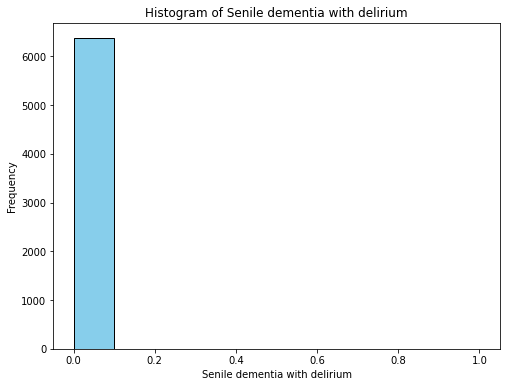

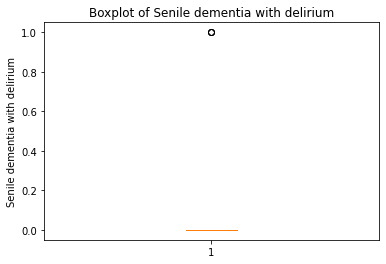

Summary statistics for column: Vascular dementia, uncomplicated
count    6377.000000
mean        0.010350
std         0.101214
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Vascular dementia, uncomplicated, dtype: float64


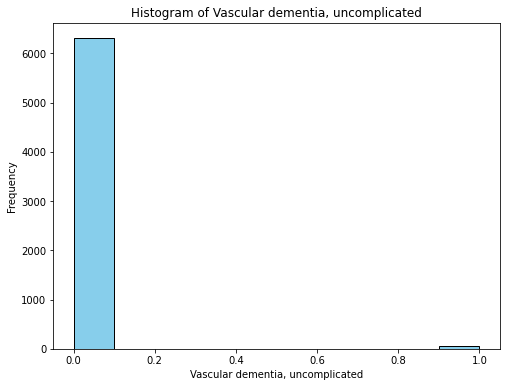

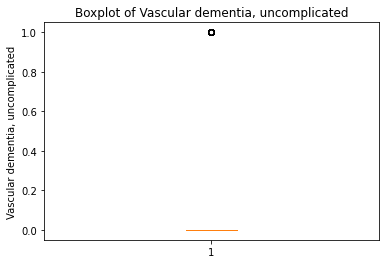

Summary statistics for column: Vascular dementia, with delirium
count    6377.000000
mean        0.002666
std         0.051567
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Vascular dementia, with delirium, dtype: float64


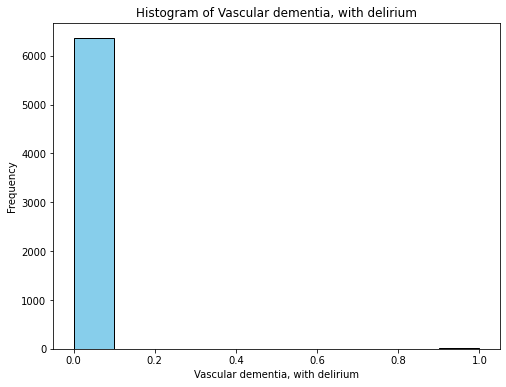

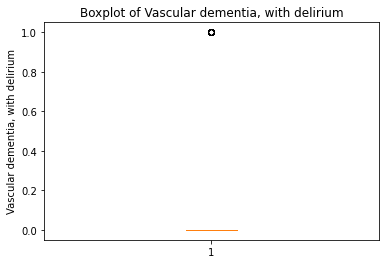

Summary statistics for column: Vascular dementia, with delusions
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Vascular dementia, with delusions, dtype: float64


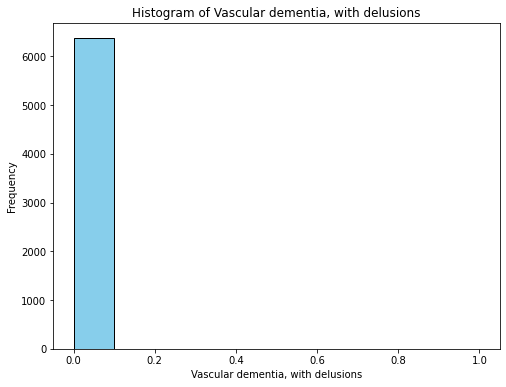

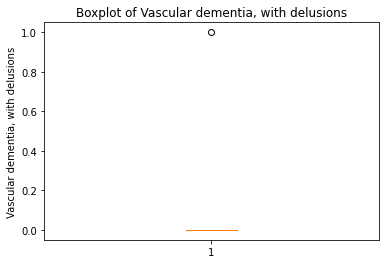

Summary statistics for column: Alcohol-induced persisting dementia
count    6377.000000
mean        0.000784
std         0.027992
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Alcohol-induced persisting dementia, dtype: float64


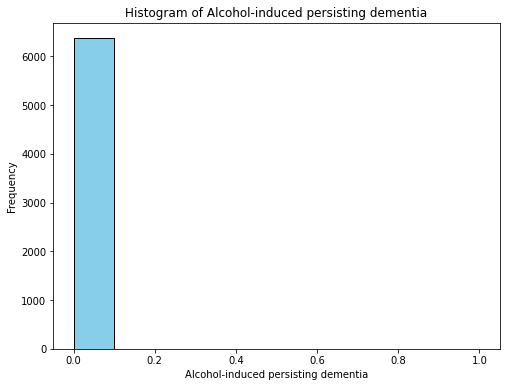

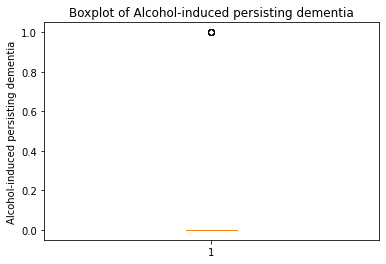

Summary statistics for column: Drug-induced persisting dementia
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Drug-induced persisting dementia, dtype: float64


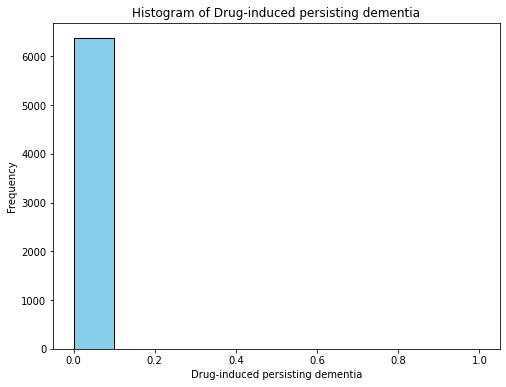

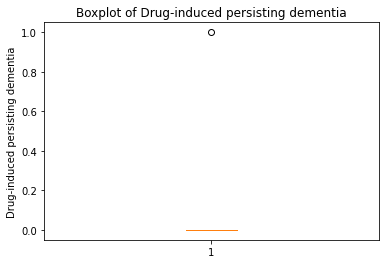

Summary statistics for column: Dementia in conditions classified elsewhere without behavioral 
count    6377.000000
mean        0.015995
std         0.125466
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia in conditions classified elsewhere without behavioral , dtype: float64


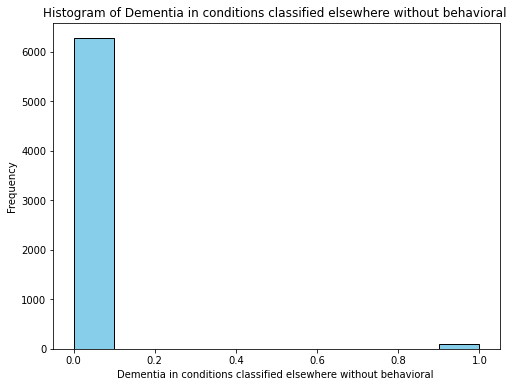

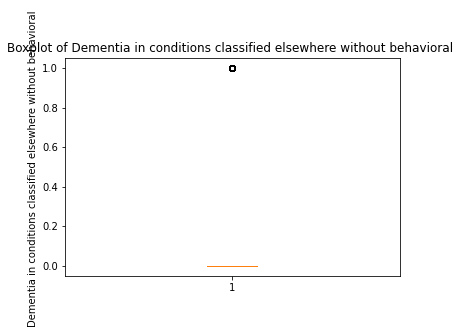

Summary statistics for column: Dementia in conditions classified elsewhere with behavioral dis
count    6377.000000
mean        0.002823
std         0.053058
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia in conditions classified elsewhere with behavioral dis, dtype: float64


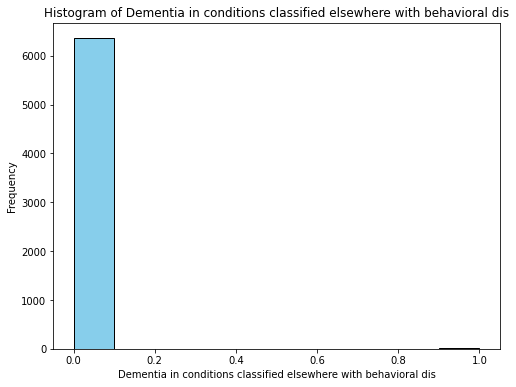

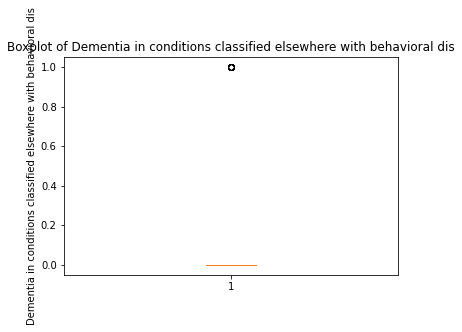

Summary statistics for column: Dementia, unspecified, without behavioral disturbance
count    6377.000000
mean        0.031833
std         0.175569
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia, unspecified, without behavioral disturbance, dtype: float64


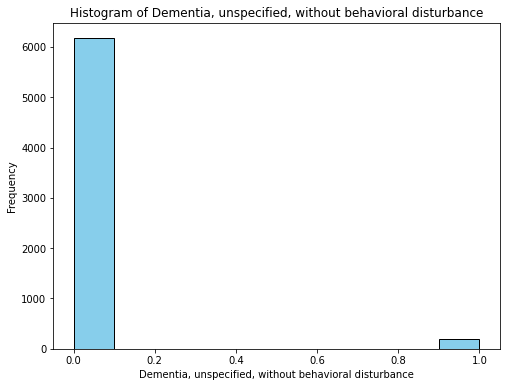

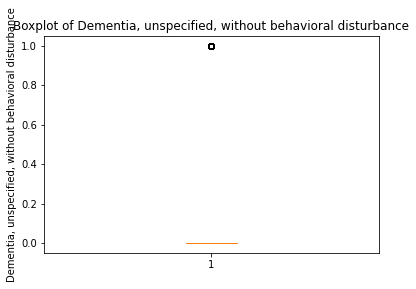

Summary statistics for column: Dementia, unspecified, with behavioral disturbance
count    6377.000000
mean        0.002039
std         0.045108
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia, unspecified, with behavioral disturbance, dtype: float64


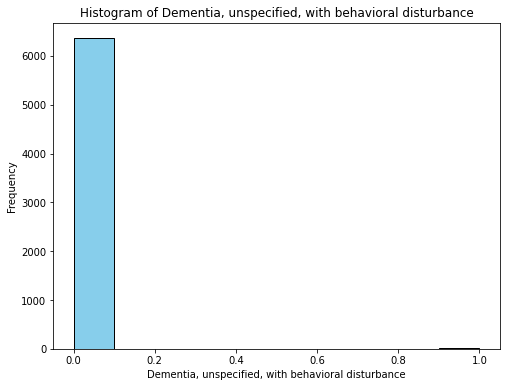

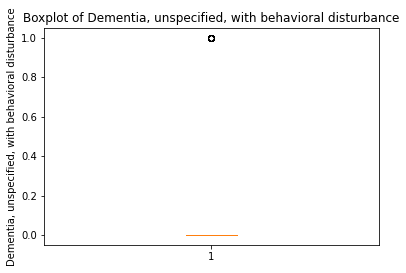

Summary statistics for column: Other frontotemporal dementia
count    6377.000000
mean        0.000314
std         0.017708
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other frontotemporal dementia, dtype: float64


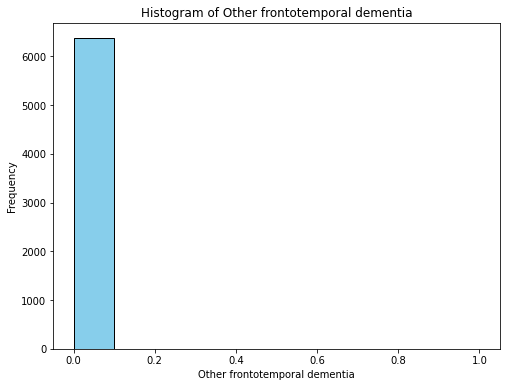

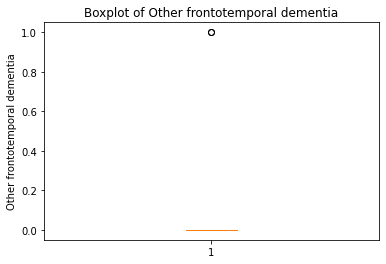

Summary statistics for column: Dementia with lewy bodies
count    6377.000000
mean        0.003450
std         0.058639
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia with lewy bodies, dtype: float64


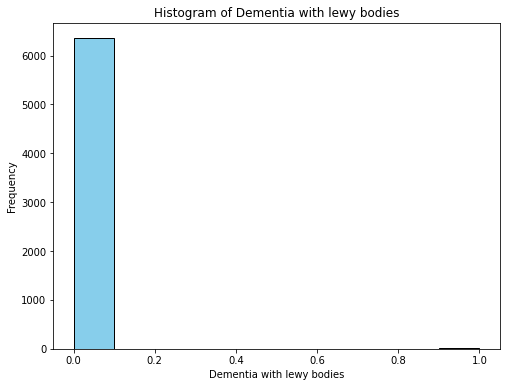

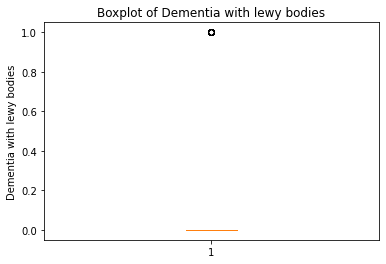

Summary statistics for column: Vascular dementia without behavioral disturbance
count    6377.000000
mean        0.009252
std         0.095749
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Vascular dementia without behavioral disturbance, dtype: float64


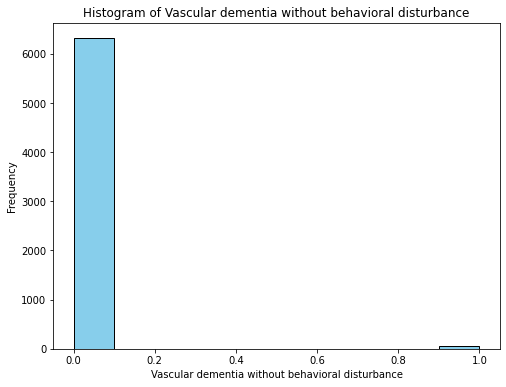

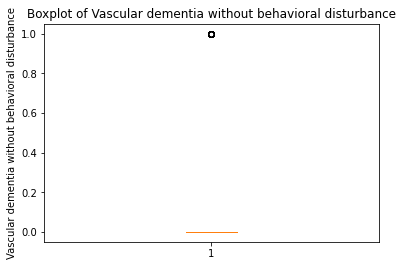

Summary statistics for column: Vascular dementia with behavioral disturbance
count    6377.000000
mean        0.001882
std         0.043342
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Vascular dementia with behavioral disturbance, dtype: float64


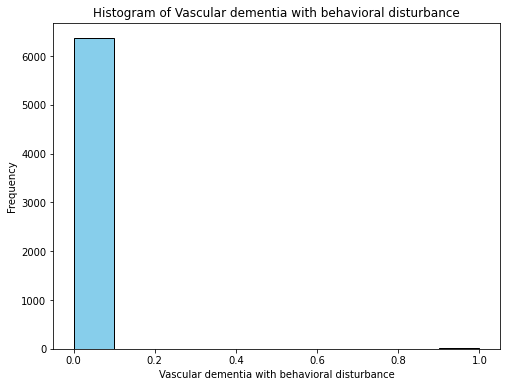

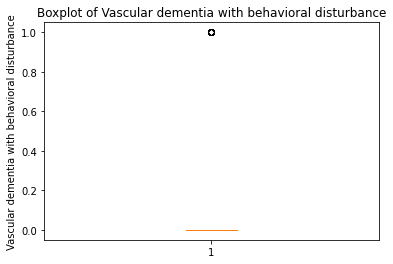

Summary statistics for column: Dementia in other diseases classified elsewhere without behavio
count    6377.000000
mean        0.012859
std         0.112674
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia in other diseases classified elsewhere without behavio, dtype: float64


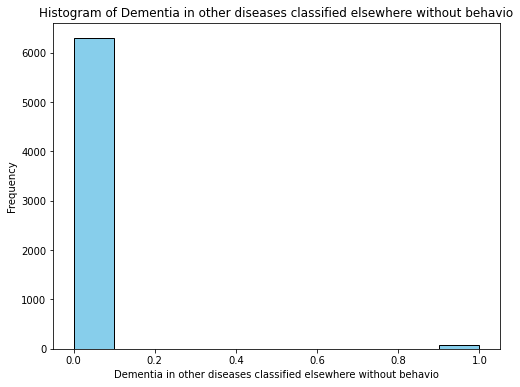

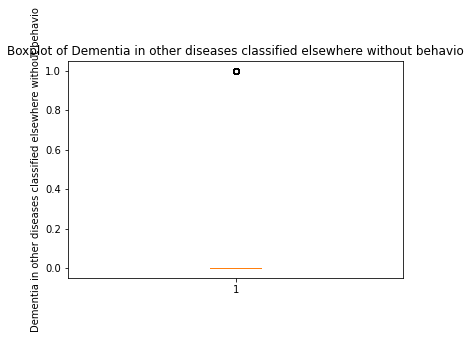

Summary statistics for column: Dementia in other diseases classified elsewhere with behavioral
count    6377.000000
mean        0.002666
std         0.051567
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia in other diseases classified elsewhere with behavioral, dtype: float64


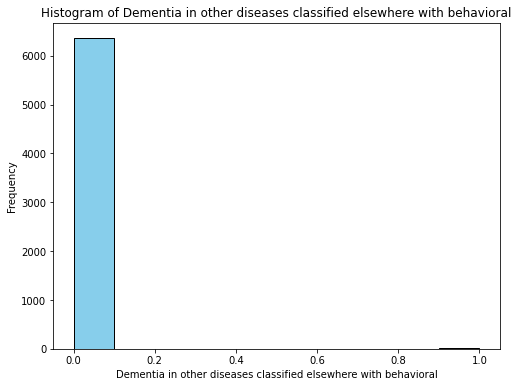

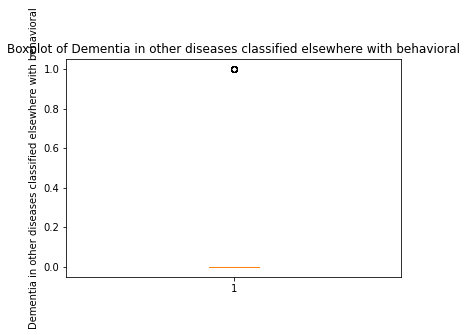

Summary statistics for column: Unspecified dementia without behavioral disturbance
count    6377.000000
mean        0.037635
std         0.190327
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified dementia without behavioral disturbance, dtype: float64


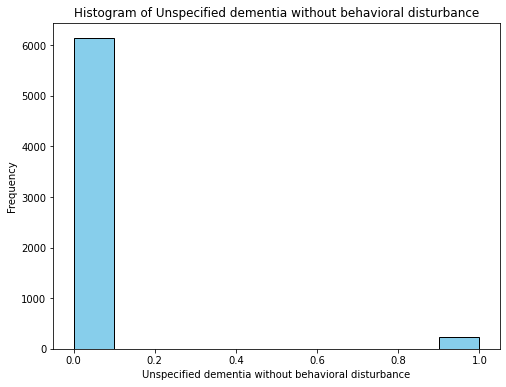

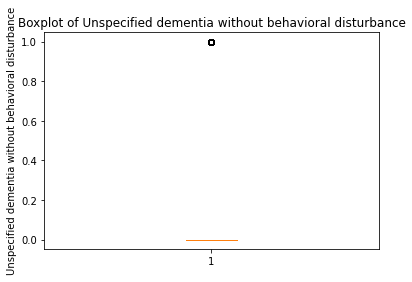

Summary statistics for column: Unspecified dementia with behavioral disturbance
count    6377.000000
mean        0.003136
std         0.055919
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Unspecified dementia with behavioral disturbance, dtype: float64


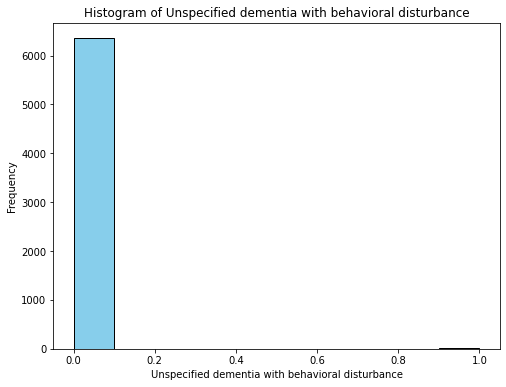

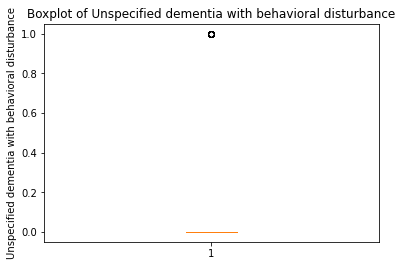

Summary statistics for column: Alcohol dependence with alcohol-induced persisting dementia
count    6377.000000
mean        0.000784
std         0.027992
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Alcohol dependence with alcohol-induced persisting dementia, dtype: float64


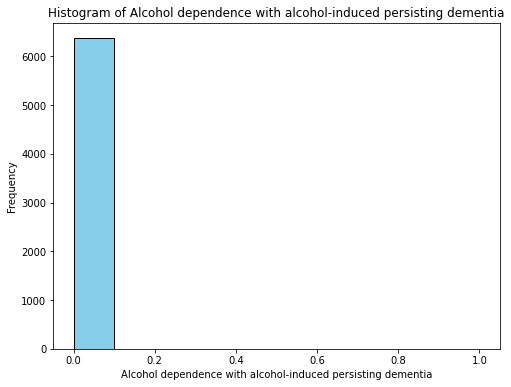

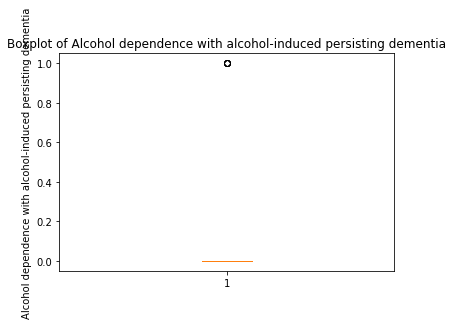

Summary statistics for column: Alcohol use, unspecified with alcohol-induced persisting dement
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Alcohol use, unspecified with alcohol-induced persisting dement, dtype: float64


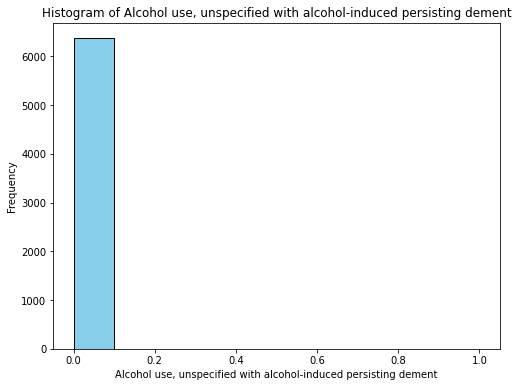

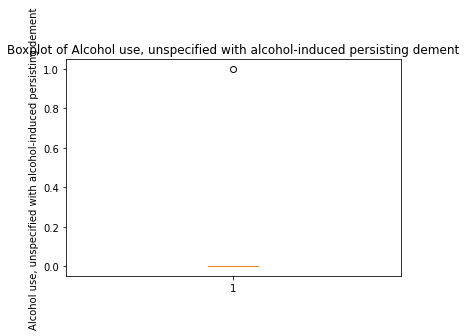

Summary statistics for column: Other psychoactive substance abuse with psychoactive substance-
count    6377.000000
mean        0.000157
std         0.012523
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other psychoactive substance abuse with psychoactive substance-, dtype: float64


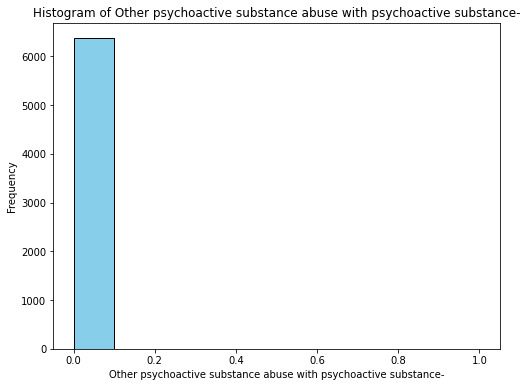

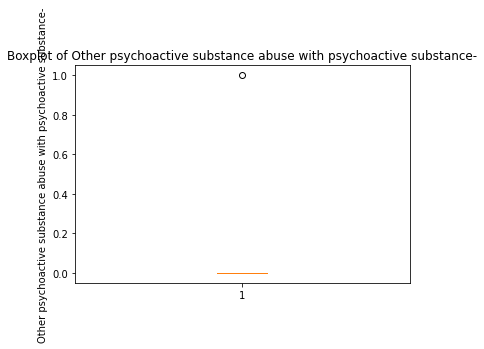

Summary statistics for column: Other frontotemporal dementia-2
count    6377.000000
mean        0.000470
std         0.021686
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Other frontotemporal dementia-2, dtype: float64


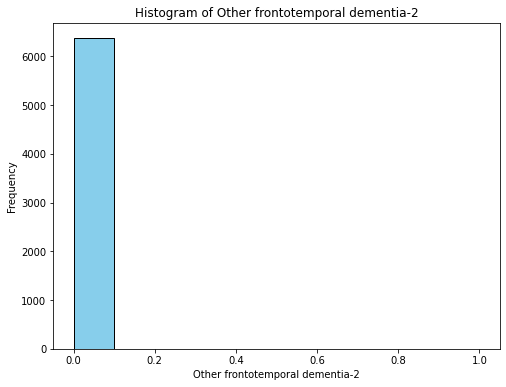

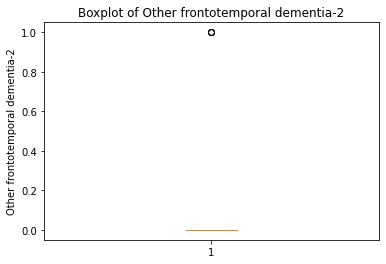

Summary statistics for column: Dementia with Lewy bodies
count    6377.000000
mean        0.002195
std         0.046807
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Dementia with Lewy bodies, dtype: float64


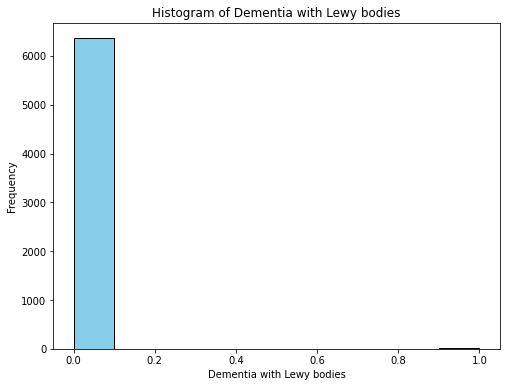

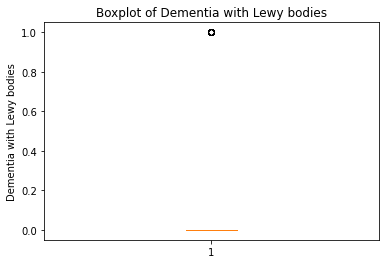

In [75]:
# Univariate Analysis for Numerical Columns
save_dir = './hsbar_plots/'
import os
os.makedirs(save_dir, exist_ok=True)

for column in df.select_dtypes(include='number'):
    # Summary statistics
    print("Summary statistics for column:", column)
    print(df[column].describe())
    
    # Histogram
    plt.figure(figsize=(8, 6))
    plt.hist(df[column], bins=10, color='skyblue', edgecolor='black')
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.savefig(os.path.join(save_dir, col + '_histplot.png'))
    plt.show()
    
    # Boxplot
    plt.figure(figsize=(6, 4))
    plt.boxplot(df[column])
    plt.title(f'Boxplot of {column}')
    plt.ylabel(column)
    plt.savefig(os.path.join(save_dir, col + '_hbplot.png'))
    plt.show()

In [76]:
#checking for missing values:
missing_cols=df.isnull().sum()

# Displaying columns with missing values and their count:
print("\nColumns with missing values:")
print(missing_cols[missing_cols > 0])


Columns with missing values:
Heart rate Alarm - High                     3
Heart Rate Alarm - Low                      4
Arterial Blood Pressure systolic         2478
Non Invasive Blood Pressure systolic       45
Arterial Blood Pressure diastolic        2477
Non Invasive Blood Pressure diastolic      45
Respiratory Rate                            2
Respiratory Rate (Set)                   2470
Respiratory Rate (spontaneous)           2300
Respiratory Rate (Total)                 2286
SpO2 Desat Limit                           13
INR                                       236
Prothrombin time                          236
Anion gap                                  17
Creatinine (serum)                         14
Temperature                              3840
Potassium, Whole Blood-2                 1441
Potassium (whole blood)                  2802
Sodium (whole blood)                     3362
Sodium, Whole Blood                      2121
Chloride, Whole Blood                    2267
Chlo

In [77]:
#Calculating percentage of missing values in each cols with percentage>30:
missing_perc=df.isna().mean()*100
cols= missing_perc[missing_perc>30].index.tolist()
print(cols)

['Arterial Blood Pressure systolic', 'Arterial Blood Pressure diastolic', 'Respiratory Rate (Set)', 'Respiratory Rate (spontaneous)', 'Respiratory Rate (Total)', 'Temperature', 'Potassium (whole blood)', 'Sodium (whole blood)', 'Sodium, Whole Blood', 'Chloride, Whole Blood', 'Chloride (whole blood)', 'Glucose (whole blood)', 'Hemoglobin']


In [78]:
#Code to drop columns having missing values more than 30%
df=df.drop(cols, axis=1)

In [79]:
#INR and PT are same thing as per the analysis shared and they have equal missing values hence INR can be deleted.
drop_cols='INR'
df=df.drop(drop_cols, axis=1)

In [80]:
#Myocardial Infarction (MI) basically says where in the heart muscle did the damage from the heart attack happen
#We consolidate it into one binary column that looks at whether the patient had a MI or not(regardless of which wall of the heart muscle was affected)
MI_cols=['Acute myocardial infarction of anterolateral wall, episode of c','Acute myocardial infarction of other anterior wall, episode of ','Acute myocardial infarction of inferolateral wall, episode of c','Acute myocardial infarction of inferoposterior wall, episode of','Acute myocardial infarction of other inferior wall, episode of ','Acute myocardial infarction of other lateral wall, episode of c','Acute myocardial infarction of other specified sites, episode o','Acute myocardial infarction of unspecified site, episode of car']
df['patient_with_MI']=df[MI_cols].max(axis=1)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21972\1878155378.py:4: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['patient_with_MI']=df[MI_cols].max(axis=1)


In [81]:
#Since we have one col with all merged data we can delete the original cols
df=df.drop(MI_cols, axis=1)

In [82]:
#These are manifestations of the heart attack on the EKG, again they can all be consolidated into one column. 
#We don’t really need to know which EKG pattern there was.
MI_types_cols=['ST elevation (STEMI) myocardial infarction of anterior wall','ST elevation (STEMI) myocardial infarction involving other coro','Non-ST elevation (NSTEMI) myocardial infarction','Acute myocardial infarction, unspecified','Other type of myocardial infarction','Myocardial infarction type 2','Other myocardial infarction type']
df['Types_of_MI']=df[MI_types_cols].max(axis=1)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21972\430894503.py:4: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Types_of_MI']=df[MI_types_cols].max(axis=1)


In [83]:
df=df.drop(MI_types_cols, axis=1)

In [84]:
#Complications and Sequelae: These are complications of MI and can be deleted
complications=['Certain current complications following ST elevation (STEMI) an','Old myocardial infarction-2','Old myocardial infarction','Certain sequelae of myocardial infarction, not elsewhere classi','Postmyocardial infarction syndrome']
df=df.drop(complications, axis=1)

In [85]:
#Consolidating heart failure columns
heart_failure=['Congestive heart failure, unspecified','Systolic (congestive) heart failure','Diastolic (congestive) heart failure','Combined systolic (congestive) and diastolic (congestive) heart']
df['Types_of_Heart_Failure']=df[heart_failure].max(axis=1)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21972\4014268343.py:3: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Types_of_Heart_Failure']=df[heart_failure].max(axis=1)


In [86]:
df=df.drop(heart_failure, axis=1)

In [87]:
Stroke_syndrome=['Brain stem stroke syndrome','Cerebellar stroke syndrome','National Institutes of Health Stroke Scale (NIHSS) score']
df['Types_of_Stroke_syndrome']=df[Stroke_syndrome].max(axis=1)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21972\3229738309.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Types_of_Stroke_syndrome']=df[Stroke_syndrome].max(axis=1)


In [88]:
df=df.drop(Stroke_syndrome, axis=1)

In [89]:
high_lipids=['Mixed hyperlipidemia','Other and unspecified hyperlipidemia']
df['Hyperlipidemia']=df[high_lipids].max(axis=1)

In [90]:
df=df.drop(high_lipids, axis=1)

In [91]:
Dementia=['Senile dementia, uncomplicated','Presenile dementia with delirium','Vascular dementia, uncomplicated','Frontotemporal dementia']
df['Patient_with_dementia']=df[Dementia].max(axis=1)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_21972\104598763.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Patient_with_dementia']=df[Dementia].max(axis=1)


In [92]:
df=df.drop(Dementia, axis=1)

In [93]:
absent = df.iloc[:,2:20]

In [94]:
df.shape

(6377, 166)

In [95]:
# Displaying columns with missing values after drop:
missing_cols=df.isnull().sum()
print("\nColumns with missing values:")
print(missing_cols[missing_cols > 0])

percentage_missing_column = (df.isnull().sum() / len(df)) * 100
print("\nPercentage of missing values in each column:")
print(percentage_missing_column[percentage_missing_column > 0])


Columns with missing values:
Heart rate Alarm - High                     3
Heart Rate Alarm - Low                      4
Non Invasive Blood Pressure systolic       45
Non Invasive Blood Pressure diastolic      45
Respiratory Rate                            2
SpO2 Desat Limit                           13
Prothrombin time                          236
Anion gap                                  17
Creatinine (serum)                         14
Potassium, Whole Blood-2                 1441
Bicarbonate                                 3
dtype: int64

Percentage of missing values in each column:
Heart rate Alarm - High                   0.047044
Heart Rate Alarm - Low                    0.062725
Non Invasive Blood Pressure systolic      0.705661
Non Invasive Blood Pressure diastolic     0.705661
Respiratory Rate                          0.031363
SpO2 Desat Limit                          0.203858
Prothrombin time                          3.700800
Anion gap                                 0.2665

In [96]:
new_cols= df.columns
print(new_cols)

Index(['subject_id', 'gender', 'age', 'mortality', 'ethnicity', 'Heart Rate',
       'Heart rate Alarm - High', 'Heart Rate Alarm - Low',
       'Non Invasive Blood Pressure systolic',
       'Non Invasive Blood Pressure diastolic',
       ...
       'Other psychoactive substance use, unspecified with psychoactive',
       'Other frontotemporal dementia-2', 'Dementia with Lewy bodies',
       'Age Group', 'patient_with_MI', 'Types_of_MI', 'Types_of_Heart_Failure',
       'Types_of_Stroke_syndrome', 'Hyperlipidemia', 'Patient_with_dementia'],
      dtype='object', length=166)


In [97]:
#For a few selected and important variables we have assigned extreme valid range from research. 
#The value outwards this range is eliminated

filter_criteria = {
    "Heart Rate": {"min": 30, "max": 200},
    "Respiratory Rate": {"min": 7, "max": 40},
    "Hemoglobin-2": {"min": 9, "max": 20},
    "SpO2 Desat Limit": {"min": 50, "max": 100},
    "Platelet Count": {"min": 10, "max": 700},
    "Non Invasive Blood Pressure systolic": {"min": 100, "max": 250},
    "Non Invasive Blood Pressure diastolic": {"min": 40, "max": 90},  
    "Heart rate Alarm - High": {"min": 70,  "max" : 220 },
    "Heart Rate Alarm - Low": {"min": 30,  "max" : 200 }
}

# The below commented code is for removing any row which has the value greater or less than the valid range
for var, criteria in filter_criteria.items():
    df = df[(df[var] >= criteria["min"]) & (df[var] <= criteria["max"])]

In [98]:
df.shape

(2030, 166)

### Imputing missing values with median

In [99]:
missing_cols=df.isnull().sum()
for column in missing_cols[missing_cols > 0].index:
    median_value = df[column].median()  # Calculate median for the current column
    df[column].fillna(median_value, inplace=True)


In [100]:
missing_cols=df.isnull().sum()
print("\nColumns with missing values:")
print(missing_cols[missing_cols > 0])

percentage_missing_column = (df.isnull().sum() / len(df)) * 100
print("\nPercentage of missing values in each column:")
print(percentage_missing_column[percentage_missing_column > 0])


Columns with missing values:
Series([], dtype: int64)

Percentage of missing values in each column:
Series([], dtype: float64)


In [101]:
df.describe()

,subject_id,gender,age,mortality,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,...,"Alcohol use, unspecified with alcohol-induced persisting dement",Other psychoactive substance abuse with psychoactive substance-,Other frontotemporal dementia-2,Dementia with Lewy bodies,patient_with_MI,Types_of_MI,Types_of_Heart_Failure,Types_of_Stroke_syndrome,Hyperlipidemia,Patient_with_dementia
count,2.030000e+03,2030.000000,2030.000000,2030.000000,2030.000000,2030.000000,2030.000000,2030.000000,2030.000000,2030.000000,...,2030.0,2030.0,2030.0,2030.000000,2030.000000,2030.000000,2030.000000,2030.0,2030.000000,2030.000000
mean,1.493560e+07,0.302956,68.547291,0.088670,102.567980,125.028079,58.578374,135.039901,75.659113,28.856650,...,0.0,0.0,0.0,0.000985,0.000493,0.107882,0.224138,0.0,0.401478,0.005419
std,2.870413e+06,0.459649,12.390058,0.284337,18.452851,10.706934,10.394489,18.540882,10.038322,4.894817,...,0.0,0.0,0.0,0.031381,0.022195,0.310307,0.417116,0.0,0.490318,0.073430
min,1.000535e+07,0.000000,19.000000,0.000000,56.000000,75.000000,40.000000,100.000000,46.000000,15.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
25%,1.244846e+07,0.000000,61.000000,0.000000,90.000000,120.000000,50.000000,121.000000,69.000000,25.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
50%,1.488940e+07,0.000000,69.000000,0.000000,99.000000,120.000000,60.000000,132.000000,77.000000,28.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
75%,1.739370e+07,1.000000,77.750000,0.000000,112.000000,130.000000,60.000000,146.000000,84.000000,32.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000
max,1.999509e+07,1.000000,91.000000,1.000000,180.000000,180.000000,165.000000,225.000000,90.000000,40.000000,...,0.0,0.0,0.0,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000


In [102]:
df.to_csv("Team3_cleandata.csv")

### Outliers

In [103]:
#Required numeric columns to check outliers
outliers_column = df.iloc[: ,2:20]
outliers_column = outliers_column.drop(columns=['mortality'])
outliers_column.head()

,age,ethnicity,Heart Rate,Heart rate Alarm - High,Heart Rate Alarm - Low,Non Invasive Blood Pressure systolic,Non Invasive Blood Pressure diastolic,Respiratory Rate,SpO2 Desat Limit,Prothrombin time,Anion gap,Creatinine (serum),"Potassium, Whole Blood-2",Bicarbonate,GCS - Eye Opening,Hemoglobin-2,Hematocrit
3,76,WHITE,103,160.0,85.0,157.0,88.0,25.0,88.0,13.8,12.0,1.0,5.7,29.0,4,12.4,38.3
4,80,ASIAN - SOUTH EAST ASIAN,155,130.0,50.0,121.0,88.0,35.0,85.0,16.1,20.0,5.0,7.1,29.0,2,14.9,46.5
5,59,OTHER,102,155.0,40.0,134.0,72.0,20.0,85.0,16.3,13.0,0.8,5.1,27.0,4,14.8,44.0
6,91,BLACK/AFRICAN AMERICAN,106,130.0,50.0,164.0,88.0,30.0,90.0,25.9,15.0,1.0,3.5,38.0,4,12.7,42.8
7,52,WHITE,91,120.0,50.0,127.0,71.0,22.0,85.0,16.5,12.0,0.8,5.6,30.0,4,14.8,45.3


16
[27, 19, 22, 23, 30, 24, 30, 33, 22, 34, 29, 29, 30, 23, 32, 27, 33, 33, 25]
The number of outliers in age is 19 



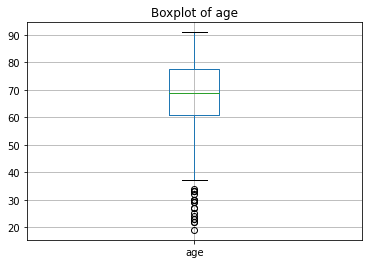

[155, 158, 157, 159, 154, 160, 180, 154, 147, 149, 147, 177, 147, 151, 149, 152, 152, 164, 168, 154, 151, 174, 162, 158, 164, 146, 152, 159, 174, 156, 147, 154, 150, 151, 153, 148, 151, 149, 166, 150, 161, 162, 158, 166, 148, 158, 152, 175, 162, 166, 153, 146, 155, 56, 149, 148, 147, 166, 159, 155, 163, 150, 164, 146, 56, 150, 161, 170, 148, 169, 56, 161]
The number of outliers in Heart Rate is 72 



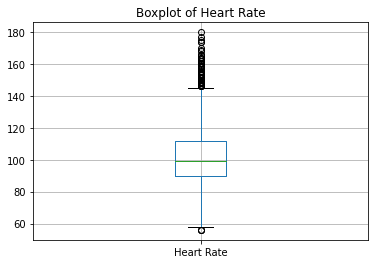

[160.0, 155.0, 150.0, 155.0, 150.0, 170.0, 100.0, 160.0, 100.0, 160.0, 155.0, 100.0, 100.0, 100.0, 175.0, 160.0, 100.0, 150.0, 160.0, 100.0, 150.0, 160.0, 150.0, 100.0, 100.0, 100.0, 150.0, 100.0, 150.0, 100.0, 160.0, 100.0, 150.0, 150.0, 155.0, 160.0, 150.0, 100.0, 100.0, 160.0, 100.0, 160.0, 100.0, 160.0, 150.0, 150.0, 175.0, 100.0, 160.0, 100.0, 100.0, 160.0, 160.0, 150.0, 100.0, 160.0, 100.0, 160.0, 150.0, 160.0, 150.0, 150.0, 160.0, 150.0, 100.0, 150.0, 150.0, 100.0, 150.0, 100.0, 100.0, 100.0, 160.0, 100.0, 150.0, 100.0, 165.0, 100.0, 100.0, 150.0, 100.0, 160.0, 160.0, 160.0, 100.0, 160.0, 150.0, 160.0, 150.0, 180.0, 160.0, 100.0, 100.0, 160.0, 160.0, 100.0, 160.0, 100.0, 160.0, 75.0, 160.0, 150.0, 155.0, 160.0, 150.0, 155.0, 100.0, 150.0, 160.0, 150.0, 100.0, 160.0, 100.0, 150.0, 155.0, 100.0, 155.0, 160.0, 160.0, 150.0, 160.0, 160.0, 180.0, 100.0, 100.0, 160.0, 150.0, 150.0, 155.0, 160.0, 160.0, 150.0, 150.0, 100.0, 100.0, 160.0, 150.0, 150.0, 150.0, 100.0, 160.0, 100.0, 160.0,

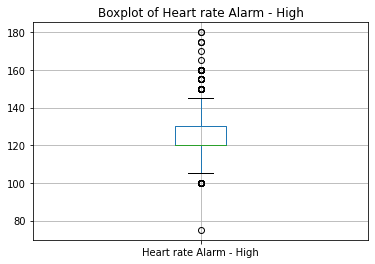

[85.0, 150.0, 90.0, 90.0, 90.0, 145.0, 130.0, 130.0, 110.0, 120.0, 120.0, 110.0, 90.0, 90.0, 110.0, 150.0, 130.0, 130.0, 110.0, 120.0, 100.0, 80.0, 80.0, 80.0, 120.0, 90.0, 90.0, 114.1, 90.0, 90.0, 90.0, 130.0, 115.0, 130.0, 90.0, 90.0, 120.0, 120.0, 85.0, 160.0, 80.0, 120.0, 120.0, 110.0, 90.0, 140.0, 100.0, 80.0, 80.0, 90.0, 90.0, 165.0, 80.0, 80.0, 130.0, 90.0, 90.0, 115.0, 120.0, 90.0]
The number of outliers in Heart Rate Alarm - Low is 60 



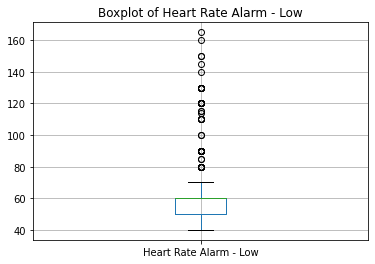

[184.0, 184.0, 198.0, 191.0, 193.0, 203.0, 198.0, 185.0, 185.0, 186.0, 219.0, 190.0, 200.0, 190.0, 185.0, 214.0, 202.0, 189.0, 184.0, 225.0, 185.0, 199.0, 188.0, 193.0, 204.0, 195.0, 190.0, 187.0, 186.0, 202.0, 200.0, 200.0, 207.0, 189.0]
The number of outliers in Non Invasive Blood Pressure systolic is 34 



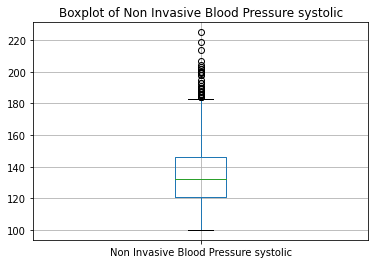

[46.0, 46.0]
The number of outliers in Non Invasive Blood Pressure diastolic is 2 



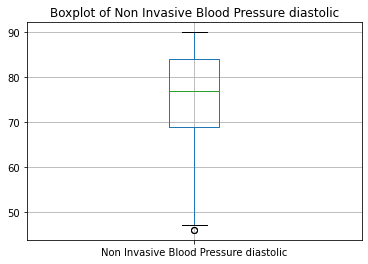

[]
The number of outliers in Respiratory Rate is 0 



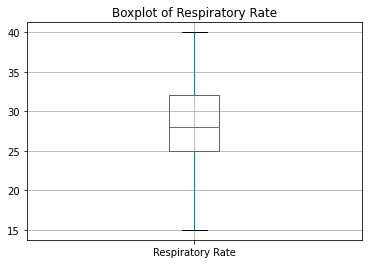

[95.0, 95.0, 93.0, 100.0, 95.0, 95.0, 95.0, 95.0, 100.0, 95.0, 100.0, 100.0, 100.0, 100.0, 100.0, 98.0]
The number of outliers in SpO2 Desat Limit is 16 



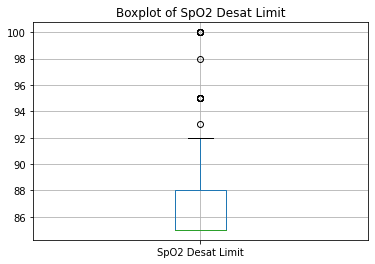

[25.9, 31.8, 84.7, 72.3, 23.2, 28.2, 31.4, 34.3, 33.1, 40.9, 23.5, 52.3, 22.9, 36.2, 37.2, 42.3, 39.8, 25.3, 68.4, 37.2, 25.4, 27.1, 35.9, 26.1, 42.0, 72.9, 28.0, 36.6, 30.8, 37.9, 31.8, 63.5, 38.4, 999999.0, 23.9, 23.2, 26.8, 29.1, 25.3, 35.8, 23.9, 117.7, 28.2, 28.6, 64.7, 35.8, 999999.0, 54.7, 112.4, 78.9, 77.4, 35.7, 51.1, 43.2, 30.8, 47.3, 38.0, 38.1, 22.8, 61.3, 92.8, 26.1, 26.3, 36.1, 80.8, 51.7, 33.6, 37.1, 150.0, 23.7, 27.5, 999999.0, 29.4, 91.1, 35.4, 59.2, 108.5, 27.0, 29.7, 26.9, 47.4, 26.5, 108.0, 23.1, 40.4, 36.0, 27.2, 41.5, 67.2, 48.1, 28.1, 30.6, 27.6, 30.6, 26.5, 37.4, 58.0, 41.2, 33.0, 23.5, 38.6, 29.1, 38.7, 40.9, 43.7, 24.0, 48.2, 49.5, 53.5, 25.9, 23.1, 24.5, 37.6, 30.3, 31.9, 41.7, 23.6, 22.8, 23.1, 999999.0, 29.2, 43.3, 30.3, 24.3, 26.1, 33.5, 49.2, 999999.0, 47.1, 46.3, 32.4, 44.5, 23.5, 41.4, 24.0, 55.5, 53.1, 28.8, 39.4, 25.1, 56.7, 63.3, 58.4, 23.3, 28.7, 29.5, 28.5, 23.8, 43.7, 64.1, 25.8, 36.0, 49.7, 150.0, 24.0, 33.0, 45.7, 47.1, 48.8, 50.0, 23.1, 83.1, 2

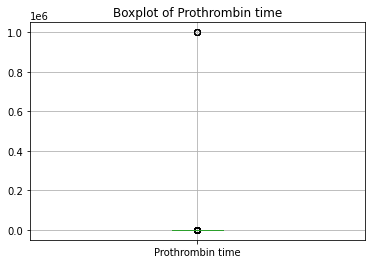

[27.0, 41.0, 27.0, 32.0, 31.0, 39.0, 38.0, 29.0, 26.0, 26.0, 28.0, 52.0, 30.0, 27.0, 31.0, 42.0, 39.0, 56.0, 29.0, 33.0, 25.0, 25.0, 27.0, 40.0, 33.0, 34.0, 30.0, 41.0, 26.0, 29.0, 25.0, 25.0, 25.0, 25.0, 28.0, 26.0, 29.0, 26.0, 26.0, 35.0, 29.0, 29.0, 25.0, 25.0, 29.0, 28.0, 34.0, 34.0, 29.0, 32.0, 26.0, 28.0, 27.0, 29.0, 46.0, 42.0, 27.0, 38.0, 31.0, 39.0, 31.0, 35.0, 43.0, 25.0, 25.0, 34.0, 27.0, 28.0, 26.0, 42.0, 25.0, 27.0, 26.0, 38.0]
The number of outliers in Anion gap is 74 



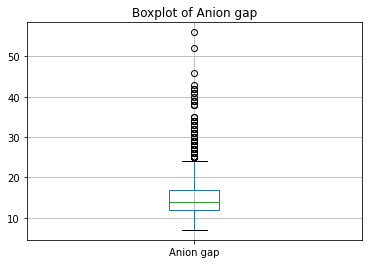

[5.0, 3.4, 3.2, 4.8, 2.7, 5.7, 5.1, 5.3, 2.7, 6.1, 4.9, 2.5, 2.9, 3.2, 2.9, 4.5, 4.1, 4.5, 4.9, 4.9, 2.7, 3.9, 4.3, 3.5, 10.1, 2.4, 3.2, 4.3, 3.1, 4.3, 2.4, 3.1, 6.9, 2.4, 5.1, 2.6, 2.9, 3.9, 4.2, 3.3, 4.0, 5.8, 2.7, 5.4, 2.7, 3.3, 3.8, 2.6, 3.2, 5.8, 2.4, 7.8, 6.9, 4.6, 4.4, 4.1, 2.6, 6.5, 3.5, 3.1, 2.8, 6.3, 4.0, 6.9, 2.4, 9.3, 3.1, 3.8, 5.9, 7.5, 4.2, 2.7, 4.8, 2.8, 3.8, 6.0, 2.9, 11.0, 7.6, 6.7, 7.7, 5.3, 2.5, 5.6, 2.7, 2.8, 5.9, 5.5, 2.5, 3.2, 2.6, 7.0, 3.1, 3.2, 2.4, 2.4, 2.4, 8.2, 5.7, 8.4, 5.4, 4.9, 4.1, 4.0, 3.8, 4.5, 7.9, 2.5, 3.2, 7.2, 2.6, 3.3, 6.5, 3.2, 2.7, 8.4, 5.4, 6.3, 5.4, 4.0, 2.9, 7.7, 3.1, 2.4, 3.0, 6.0, 3.3, 2.6, 3.8, 4.6, 8.3, 3.6, 5.8, 4.1, 4.4, 6.9, 3.8, 14.2, 2.9, 2.5, 2.9, 4.6, 3.0, 4.3, 3.4, 2.6, 3.8, 3.6, 4.4, 3.4, 3.9, 5.9, 13.7, 2.7, 2.9, 2.5, 2.4, 2.5, 7.4, 3.8, 4.1, 2.8, 999999.0, 3.6, 3.9, 3.2, 4.4, 4.5, 2.5, 4.2, 3.4, 5.1, 5.0, 3.2, 6.4, 3.3, 5.2, 4.4, 2.4, 2.7, 2.6, 2.4, 9.4, 4.9, 3.1, 7.9, 3.2, 2.5, 9.3, 4.4, 5.1, 3.0, 3.2, 2.8, 5.0, 4.5, 2.5, 4.9, 

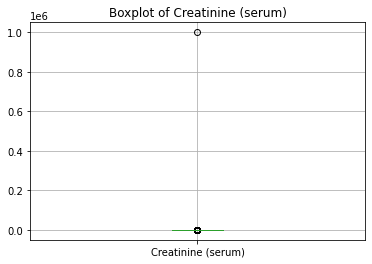

[7.1, 3.5, 3.5, 3.2, 7.9, 7.6, 9.4, 3.3, 2.3, 3.2, 3.5, 8.9, 6.7, 3.3, 3.3, 7.8, 8.1, 6.9, 3.5, 7.2, 3.5, 6.8, 3.4, 6.7, 3.5, 7.1, 3.3, 3.5, 7.2, 7.5, 6.9, 7.8, 7.4, 3.5, 7.3, 6.8, 3.5, 3.2, 7.9, 7.5, 3.1, 8.7, 6.9, 3.3, 7.1, 6.7, 8.6, 3.3, 3.4, 3.3, 6.7, 3.3, 3.3, 3.0, 8.5, 1.8, 7.1, 6.9, 6.9, 6.8, 9.7, 7.0, 7.1, 6.7, 6.9, 6.7, 8.2, 3.3, 8.3, 2.8, 6.9, 7.7, 6.7, 10.7, 6.8, 134.0, 3.4, 7.6, 3.1, 2.8, 6.8, 3.2, 7.4, 3.4, 7.1, 7.2, 7.0, 7.2, 3.0, 7.2, 6.8, 3.3, 8.2, 8.8, 3.4, 6.8, 6.7, 6.9, 7.2, 6.9, 6.7, 6.9, 6.9, 3.5, 7.3, 3.4, 7.3, 7.0, 6.7, 3.3, 3.2, 3.4, 6.8, 8.0, 6.7, 6.8, 7.1, 6.9, 3.2, 6.8]
The number of outliers in Potassium, Whole Blood-2 is 120 



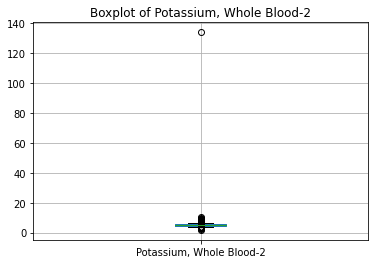

[44.0, 40.0, 39.0, 17.0, 41.0, 39.0, 47.0, 20.0, 40.0, 18.0, 21.0, 14.0, 45.0, 15.0, 39.0, 39.0, 18.0, 21.0, 21.0, 14.0, 18.0, 43.0, 46.0, 19.0, 43.0, 17.0, 39.0, 21.0, 21.0, 21.0, 41.0, 47.0, 39.0, 39.0, 20.0, 19.0, 39.0, 41.0, 44.0, 49.0, 41.0, 40.0, 43.0, 20.0, 41.0, 20.0, 19.0, 50.0, 21.0, 40.0, 19.0, 18.0, 49.0, 40.0, 17.0, 40.0, 21.0, 43.0, 50.0, 45.0, 20.0, 41.0, 39.0, 47.0, 21.0, 40.0, 21.0, 19.0, 40.0, 45.0]
The number of outliers in Bicarbonate is 70 



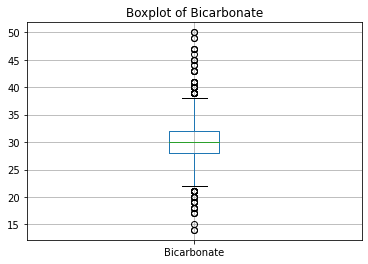

[2, 3, 3, 2, 3, 1, 1, 1, 2, 3, 2, 1, 3, 2, 1, 2, 1, 1, 3, 3, 3, 1, 2, 3, 2, 3, 2, 3, 1, 1, 2, 2, 1, 3, 2, 1, 2, 2, 3, 1, 1, 3, 2, 3, 1, 1, 1, 2, 2, 2, 3, 3, 2, 2, 1, 2, 1, 3, 1, 3, 3, 1, 3, 3, 1, 1]
The number of outliers in GCS - Eye Opening is 66 



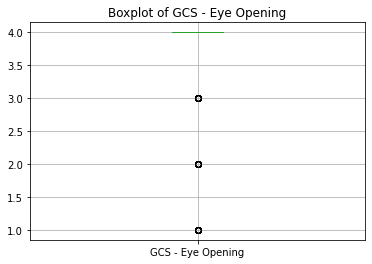

[18.6, 18.7]
The number of outliers in Hemoglobin-2 is 2 



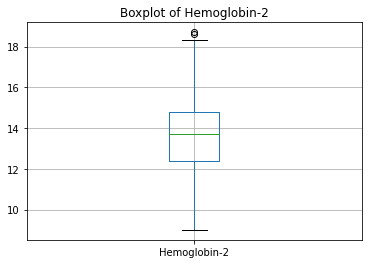

[55.3, 54.7, 54.7, 26.6, 54.2, 55.8, 56.8]
The number of outliers in Hematocrit is 7 



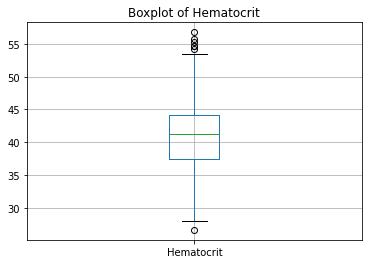

In [104]:
save_dir = './outlier_plots/'
import os
os.makedirs(save_dir, exist_ok=True)

#when the multiplier is 1.5
def outlier_detector(column_name):
    q1 = np.percentile(outliers_column[column_name], 25)
    q3 = np.percentile(outliers_column[column_name], 75)    
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = [x for x in outliers_column[column_name] if x < lower_bound or x > upper_bound]
    print(outliers)
    return len(outliers)  

numeric_cols = outliers_column.select_dtypes(include=['number']).columns
print(len(numeric_cols))
numeric_cols_for_matrix = numeric_cols

iqr_multiple = []

# Creating box plots for numeric columns
for col in numeric_cols:
    number_of_outliers = outlier_detector(col)
    print(f"The number of outliers in {col} is {number_of_outliers} \n")
    
    plt.figure()
    df.boxplot(column=col)
    
    plt.title('Boxplot of ' + col)
    plt.savefig(os.path.join(save_dir, col + '_boxplot.png'))
    
    plt.show()

### Pair Wise Analysis

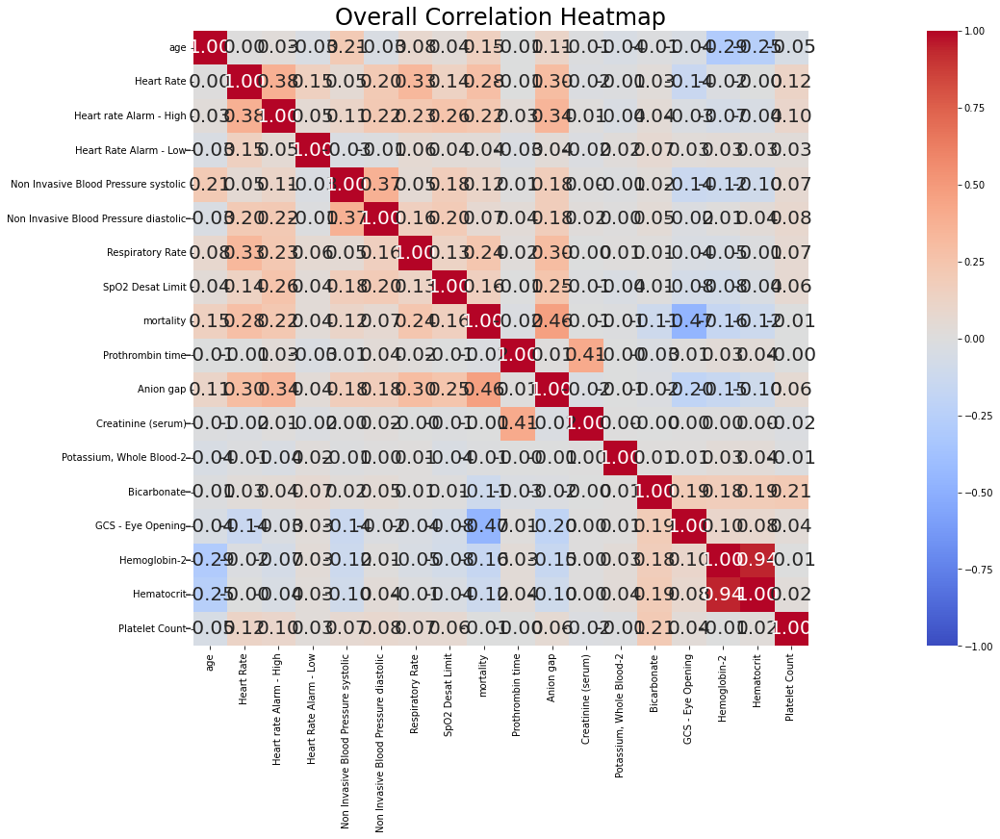

In [105]:
#Code for correlation Heat Map and Scatter plot- Numerical
selected_columns = ['age', 'Heart Rate', 'Heart rate Alarm - High', 'Heart Rate Alarm - Low',
                    'Non Invasive Blood Pressure systolic', 'Non Invasive Blood Pressure diastolic',
                    'Respiratory Rate', 'SpO2 Desat Limit','mortality',
                    'Prothrombin time', 'Anion gap', 'Creatinine (serum)',
                    'Potassium, Whole Blood-2','Bicarbonate', 'GCS - Eye Opening', 'Hemoglobin-2',
                    'Hematocrit', 'Platelet Count']

#Compute correlation matrix
correlation_matrix = df[selected_columns].corr()

#Create heatmap
plt.figure(figsize=(44, 40))
plt.subplot(3, 1, 1)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 20}, square=True, vmin=-1, vmax=1)
plt.title('Overall Correlation Heatmap', fontsize=24)
plt.show()

# Filter correlation matrix for values above 0.5 or below -0.5
high_correlation = correlation_matrix[(correlation_matrix > 0.5) | (correlation_matrix < -0.5)]
variable_names = high_correlation.stack().index.tolist()
variable_names = set([item[0] for item in variable_names] + [item[1] for item in variable_names])
df_high_correlation = df[list(variable_names)]

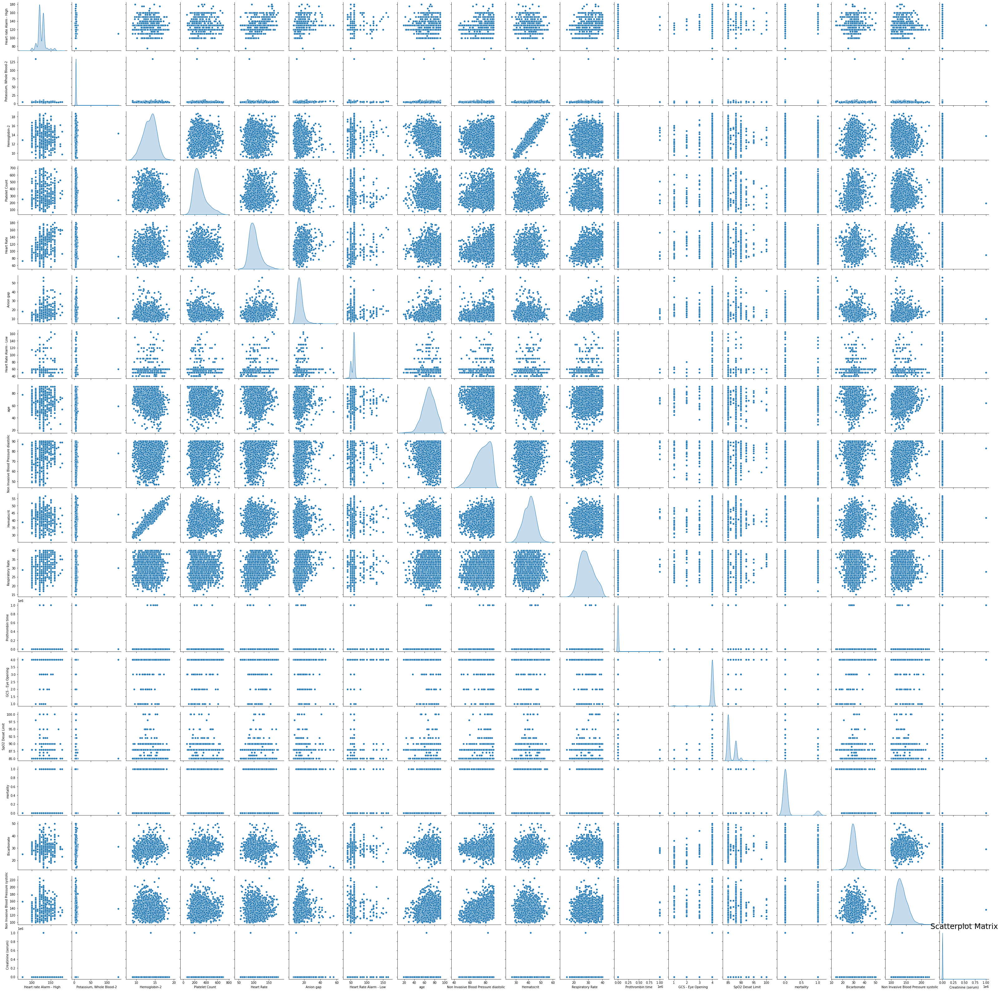

In [106]:
#Create correlation scatterplot Matrix
sns.pairplot(df_high_correlation, diag_kind='kde')
plt.title('Scatterplot Matrix', fontsize=24)
plt.show()

In [107]:
categorical_column = df.iloc[:,23:]
categorical_column = pd.concat([ df[['gender', 'ethnicity']], categorical_column], axis=1)
categorical_column.head()

,gender,ethnicity,"Acute myocardial infarction of other anterior wall, initial epi","Acute myocardial infarction of other anterior wall, subsequent","Acute myocardial infarction of inferolateral wall, initial epis","Acute myocardial infarction of inferolateral wall, subsequent e","Acute myocardial infarction of inferoposterior wall, initial ep","Acute myocardial infarction of inferoposterior wall, subsequent","Acute myocardial infarction of other inferior wall, initial epi","Acute myocardial infarction of other inferior wall, subsequent",...,"Other psychoactive substance use, unspecified with psychoactive",Other frontotemporal dementia-2,Dementia with Lewy bodies,Age Group,patient_with_MI,Types_of_MI,Types_of_Heart_Failure,Types_of_Stroke_syndrome,Hyperlipidemia,Patient_with_dementia
3,0,WHITE,0,0,0,0,0,0,0,0,...,absent,0,0,66-100,0,0,0,0,1,0
4,0,ASIAN - SOUTH EAST ASIAN,0,0,0,0,0,0,0,0,...,absent,0,0,66-100,0,1,1,0,0,0
5,0,OTHER,0,0,0,0,0,0,0,0,...,absent,0,0,51-65,0,0,0,0,0,0
6,1,BLACK/AFRICAN AMERICAN,0,0,0,0,0,0,0,0,...,absent,0,0,66-100,0,0,1,0,1,0
7,0,WHITE,0,0,0,0,0,0,0,0,...,absent,0,0,51-65,0,0,0,0,0,0


In [108]:
#Code for chi square- Categorical
from scipy.stats import chi2_contingency

categorical = df.iloc[:,23:]
categorical = pd.concat([ df[['gender', 'ethnicity']], categorical], axis=1)

def chi_square_test(data, columns):
    for col1 in columns:
        for col2 in columns:
            if col1 != col2:
                contingency_table = pd.crosstab(index=data[col1], columns=data[col2])
                chi2, p, _, _ = chi2_contingency(contingency_table)
                print(f"Chi-square test for {col1} and {col2}: Chi2 = {chi2:.4f}, P-value = {p:.4g}")
                if p > 0.05:
                    print(f"No significant association between {col1} and {col2}. Hence, The observed data does not provide enough evidence to reject the null hypothesis \n")
                else:
                    print(f"There is association between{col1} and {col2}.Hence, The observed data provides enough evidence to reject the null hypothesis \n")

# Assuming categorical variables are stored in the list 'categorical'
chi_square_test(df, categorical)

Chi-square test for gender and ethnicity: Chi2 = 48.3679, P-value = 0.009779
There is association betweengender and ethnicity.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for gender and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0006, P-value = 0.9801
No significant association between gender and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between gender and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant a

Chi-square test for gender and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between gender and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between gender and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between gender and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender a

Chi-square test for gender and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between gender and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between gender and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Unspecified atrial fibrillation: Chi2 = 0.1754, P-value = 0.6753
No significant association between gender and Unspecified atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between gender and Other chronic obstructive pulmon

Chi-square test for gender and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between gender and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between gender and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between gender and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between gender and Senile dementia with deli

Chi-square test for gender and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between gender and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between gender and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between gender and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for gender and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No sign

Chi-square test for ethnicity and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 61.8327, P-value = 0.0002363
There is association betweenethnicity and ST elevation (STEMI) myocardial infarction involving right coro.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 23.9513, P-value = 0.6841
No significant association between ethnicity and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for

Chi-square test for ethnicity and Acute on chronic diastolic (congestive) heart failure: Chi2 = 39.1848, P-value = 0.078
No significant association between ethnicity and Acute on chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.3925, P-value = 1
No significant association between ethnicity and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 7.0763, P-value = 1
No significant association between ethnicity and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethni

Chi-square test for ethnicity and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No si

Chi-square test for ethnicity and Vascular dementia with behavioral disturbance: Chi2 = 30.2457, P-value = 0.3516
No significant association between ethnicity and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between ethnicity and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ethnicity and Dementia in other diseases classified elsewhere without behavio: C

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Acute myocardial infarction of other

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Chronic systolic (congestive) heart failure: Chi2 = 3.0382, P-value = 0.08132
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0502, P-value = 0.8227
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Acute on chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No signifi

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute my

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, initial epi and Dementia in other diseases classified elsewhere without behavio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, initial epi and Dementia in other diseases classified elsewhere with behavioral:

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Acute coronary occlusion without myo

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, sub

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other anterior wall, subsequent  and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other anterior wall, subsequent  and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other ante

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and gender: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and ethnicity: Chi2 = 1.5724, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Acute myocardial infarction of other anterior wall, initial epi

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Atrial septal defect as current comp

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Unspecified atrial fibrillation: Chi2 = 0.0200, P-value = 0.8875
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Unspecified atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Other chronic obstructive pulmonary disease. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Acute my

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Vascular dementia, with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and V

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Age Group: Chi2 = 3.2612, P-value = 0.3531
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, initial epis and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, initial epis and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hy

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Atrial septal defect as current comp

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No signi

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wa

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_Heart_Failure: Chi2 = 0.4378, P-value = 0.5082
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferolateral wall, subsequent e and Types_of_Stroke_syndrome. Hence, The observed data does not p

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Thrombosis of atrium, auricular appe

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Exertion

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, initial ep and Vascular dementia without behavioral

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Acute myocardial infarction of other

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Acute on chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Other hyperlipidemia. Hence, The observed da

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of inferoposterior wall, subsequent and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of inferoposterior wall, subsequent and Sedative, hypnotic or anxiolytic use

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and ST elevation (STEMI) myocardial infarction i

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other in

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction o

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and Age Group: Chi2 = 7.0455, P-value = 0.07046
No significant association between Acute myocardial infarction of other inferior wall, initial epi and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, initial epi and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, initial epi and patient_with_MI. Hence, The observed data does not provide enough e

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 188.2506, P-value = 7.66e-43
There is association betweenAcute myocardial infarction of other inferior wall, subsequent  and Subsequent non-ST elevation (NSTEMI) myocardial infarction.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, subsequent  and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Subsequent ST elevation (STEMI) myocardial infarction

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, subsequent  and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, subsequent  and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No signi

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, subsequent  and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other inferior wall, subsequent  and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other inferior wall, subsequent  and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 55.5574, P-value = 9.077e-14
There is association betweenAcute myocardial infarction of other lateral wall, initial epis and Acute myocardial infarction of other anterior wall, subsequent .Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Acute myocardial infarction of inferolatera

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Acute systolic (congestive) heart failure: Chi2 = 4.4097, P-value = 0.03574
There is association betweenAcute myocardial i

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association betwe

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, initial epis and Unspecified dementia 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent


Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Acute myoca

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other lateral wall, subsequent e and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other lateral wall, subsequent e and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Thrombosis of atrium, auricular appendage, and ventricle as cur. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Acute coronary thrombosis not result

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, i

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, initial e and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, initial e and Unspecified dementia 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Pers

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Chronic obstructive pulmonary disease, unspecified-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-va

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of other specified sites, subsequen and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of other specified sites, subsequen and Age Group: Chi2 = 0.6204, P-value = 0.8917
No significant association between Acute myocardial infarction of other specified sites, subsequen and Age Group. Hence, The observed

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Hemopericardium as current complicat

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocard

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, initial episod and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, initial episod and Vascular dementia-2. Hence, The observed data does no

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Acute myocardial infarction of inferolateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Acute myocardial infarction of infer

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Acute on chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant associ

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Heatstroke and sunstroke, subsequent encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Heatstroke and sunstroke, sequela-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction of unspecified site, subsequent epi and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction of unspecified site, subsequent epi and Inhalant abuse with inhalant-induced

Chi-square test for Acute coronary occlusion without myocardial infarction and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
N

Chi-square test for Acute coronary occlusion without myocardial infarction and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Permanent atrial fibrillation. Hence, The obser

Chi-square test for Acute coronary occlusion without myocardial infarction and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Seni

Chi-square test for Acute coronary occlusion without myocardial infarction and Types_of_MI: Chi2 = 0.1079, P-value = 0.7426
No significant association between Acute coronary occlusion without myocardial infarction and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Types_of_Heart_Failure: Chi2 = 1.3148, P-value = 0.2515
No significant association between Acute coronary occlusion without myocardial infarction and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary occlusion without myocardial infarction and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary occlusion without myocardial infarction and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothe

Chi-square test for Acute myocardial infarction and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Rupture of chordae tendineae as current complication foll

Chi-square test for Acute myocardial infarction and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Ot

Chi-square test for Acute myocardial infarction and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute myocardial infarction and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute myocardial infarction and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Acute coronary occlusion without myo

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left mai

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left main  and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left main  and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial inf

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and gender: Chi2 = 0.0266, P-value = 0.8705
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and ethnicity: Chi2 = 15.8226, P-value = 0.9684
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Acute myocardial infarction of other anterior wall, 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Acute systolic (congestive) heart failure: Chi2 = 7.0797, P-value = 0.007796
There is association betweenST elevation (STE

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left anter and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left anter and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infa

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Acute coronary occlusion without myocardial infarction: 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Persistent atrial fibrillati

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior 

Chi-square test for ST elevation (STEMI) myocardial infarction of inferior wall and Patient_with_dementia: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of inferior wall and Patient_with_dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and gender: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and ethnicity: Chi2 = 61.8327, P-value = 0.0002363
There is association betweenST elevation (STEMI) myocardial infarction involving right coro and ethnicity.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-squ

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Thrombosis of atrium, auricular appe

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocard

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving right coro and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving right coro and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction in

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute myocardial infarctio

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute on chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Acute combined systolic (congestive) and diast

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Other hyperlipidemia-2. Hence, The obs

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Inhalant abuse with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other coro-2 and Inhalant dependence with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other coro-2 and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000,

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of other sites and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of other sites and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.00

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and ethnicity: Chi2 = 0.3925, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STE

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STE

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction invol

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving left circu and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving left circu and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No s

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Acute myocardial infarction of unspe

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Pers

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardi

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction involving other site and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction involving other site and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Rupture of papillary muscle as current co

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unsp

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unspecified site and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for ST elevation (STEMI) myocardial infarction of unspecified site and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between ST elevation (STEMI) myocardial infarction of unsp

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute myocardial infarction of other specified sites, initial e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute myocardial infarction of other

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Acute on chronic combined systolic (

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEM

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m and Age Group. Hence, The observed data

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Atrial septal defect as current comp

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of anteri and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of anteri and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute myocardial infarction of unspe

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute on chronic combined systolic (congestive) and diastolic (: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Acute on chronic combined systolic (congestive) and diastolic (. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Atrial fibrillation: Chi2 = 0.4446, 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Chronic obstructive pulmonary disease with (acute) exacerbation-2: C

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of inferi and Other psychoactive substance use, un

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Chronic obstructive pulmonary disease, unspecified: Chi2 = 3.

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent non-ST elevation (NSTEMI) myocardial infarction and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent non-ST elevation (NSTEMI) myocardial infarction and Dementia, unspecified, without behavioral disturbance: Chi2 =

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and gender: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Acute myocardial infarction of other anterior wall, initial epi

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Subs

No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough ev

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Unspecified dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of other  and Alcohol dependence with alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of other  and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and ST elevation (STEMI) myocardial infarction invol

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarct


Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Subsequent ST elevation (STEMI) myocardial infarction of unspec and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Subsequent ST elevation (STEMI) myocardial infarction of unspec and Dementia, unspecified, with behavioral disturbance: Chi

Chi-square test for Hemopericardium as current complication following acute myocard and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Acute myocardial infarction of other

Chi-square test for Hemopericardium as current complication following acute myocard and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Acute on chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant associ

Chi-square test for Hemopericardium as current complication following acute myocard and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Other hyperlipidemia. Hence, The observed da

Chi-square test for Hemopericardium as current complication following acute myocard and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Inhalant dependence with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No significant association between Hemopericardium as current complication following acute myocard and Inhalant use, unspecified with inhalant-induced persisting deme. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hemopericardium as current complication following acute myocard and Other psychoactive substance abuse with psychoactive substance

Chi-square test for Atrial septal defect as current complication following acute my and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Subsequent ST elevation (STEMI) myoc

Chi-square test for Atrial septal defect as current complication following acute my and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication follo

Chi-square test for Atrial septal defect as current complication following acute my and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Atrial septal defect as current complication following acute my and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial septal defect as current complication following acute my and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Ventricular septal defect as current complication following acu and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Acute myocardial infarction of inferolateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Acute myocardial infarction of infer

Chi-square test for Ventricular septal defect as current complication following acu and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between 

Chi-square test for Ventricular septal defect as current complication following acu and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Mi

Chi-square test for Ventricular septal defect as current complication following acu and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Inhalant abuse with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Ventricular septal defect as current complication following acu and Inhalant dependence with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Ventricular septal defect as current complication following acu and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No sig

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Subsequent ST elevation (STEMI) and no

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Chronic obstructive pulmonary diseas

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardium as current comp and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of cardiac wall without hemopericardium as current comp and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of cardiac wall without hemopericardiu

Chi-square test for Rupture of chordae tendineae as current complication following  and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chorda

Chi-square test for Rupture of chordae tendineae as current complication following  and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Ruptu

Chi-square test for Rupture of chordae tendineae as current complication following  and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Heatstroke and sunstroke, subsequent encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Rup

Chi-square test for Rupture of chordae tendineae as current complication following  and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of chordae tendineae as current complication following  and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of chordae tendineae as current complication following  and Sedative, hypnotic or anxiolytic use

No significant association between Rupture of papillary muscle as current complication following a and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Subsequent ST elevatio

Chi-square test for Rupture of papillary muscle as current complication following a and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Heatstroke and sunstroke-2. Henc

Chi-square test for Rupture of papillary muscle as current complication following a and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current complication following a and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rupture of papillary muscle as current complication following a and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Rupture of papillary muscle as current compli

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute myocardial infarction of other

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Heatstroke and sunstroke, sequela-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Alcohol dependence with alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Thrombosis of atrium, auricular appendage, and ventricle as cur and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Thrombosis of atrium, auricular appendage, and ventricle as cur and Sedative, hypnotic or anxiolytic dependence 

Chi-square test for Other current complications following acute myocardial infarcti and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and ST elevation (STEMI) myocardial infarction i

Chi-square test for Other current complications following acute myocardial infarcti and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications followin

Chi-square test for Other current complications following acute myocardial infarcti and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other current complications following acute myocardial infarcti and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Other current complications

Chi-square test for Other current complications following acute myocardial infarcti and Patient_with_dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other current complications following acute myocardial infarcti and Patient_with_dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and gender: Chi2 = 0.2643, P-value = 0.6072
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and ethnicity: Chi2 = 18.4746, P-value = 0.9136
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and ethnicity. Hence, The observed data does not provide enough evidence to reject the

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Thrombosis of atrium, auricular appendage, and ventricle as cur. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Other current complications followin

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myoca

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in myocardial infarctio and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute coronary thrombosis not resulting in myocardial infarctio and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute coronary thrombosis not resulting in my

Chi-square test for Rheumatic heart failure (congestive) and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Acu

Chi-square test for Rheumatic heart failure (congestive) and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Acute on chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Acute combined systolic

Chi-square test for Rheumatic heart failure (congestive) and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Hyperlipidemia, unspecified: Chi2 = 2.4738, P-value = 0.1158
No significant association between Rheumatic heart failure (congestive) and Hyperlipidemia, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Other chronic obstruct

Chi-square test for Rheumatic heart failure (congestive) and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Rheumatic heart failure (congestive) and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Rheumatic heart failure (congestive) and Inhalant abuse with i

Chi-square test for Unspecified systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association betwe

Chi-square test for Unspecified systolic (congestive) heart failure and Chronic atrial fibrillation: Chi2 = 0.0072, P-value = 0.9324
No significant association between Unspecified systolic (congestive) heart failure and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and Permanent atrial fibrillation. Hence, The observed data does not provide enough evid

Chi-square test for Unspecified systolic (congestive) heart failure and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and Vascular dementia, with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified systolic (congestive) heart failure and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified systolic (congestive) heart failure and Vascular dementia, with depressed mood. Hence, The observed data does not provide en

Chi-square test for Acute systolic (congestive) heart failure and ethnicity: Chi2 = 27.5832, P-value = 0.4867
No significant association between Acute systolic (congestive) heart failure and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, subsequent . Hence, The

Chi-square test for Acute systolic (congestive) heart failure and Unspecified systolic (congestive) heart failure: Chi2 = 3.9388, P-value = 0.04718
There is association betweenAcute systolic (congestive) heart failure and Unspecified systolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Chronic systolic (congestive) heart failure: Chi2 = 11.7744, P-value = 0.0006005
There is association betweenAcute systolic (congestive) heart failure and Chronic systolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.8087, P-value = 0.3685
No significant association between Acute systolic (congestive) heart failure and Acute on chronic systolic (congestive) heart failure. Hence, The obs

Chi-square test for Acute systolic (congestive) heart failure and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Heatstroke and sunstroke, initial encounter-2. Hence, The obs

Chi-square test for Acute systolic (congestive) heart failure and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute systolic (congestive) heart failure and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute systolic (congestive) heart failure and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null

Chi-square test for Chronic systolic (congestive) heart failure and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Chronic s

Chi-square test for Chronic systolic (congestive) heart failure and Atrial fibrillation: Chi2 = 2.2379, P-value = 0.1347
No significant association between Chronic systolic (congestive) heart failure and Atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Paroxysmal atrial fibrillation: Chi2 = 78.9883, P-value = 6.248e-19
There is association betweenChronic systolic (congestive) heart failure and Paroxysmal atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chroni

Chi-square test for Chronic systolic (congestive) heart failure and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 2.6395, P-value = 0.1042
No significant association between Chronic systolic (congestive) hear

Chi-square test for Chronic systolic (congestive) heart failure and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Chronic systolic (congestive) heart failure and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic systolic (congestive) heart failure and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Chronic s

Chi-square test for Acute on chronic systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 33.5629, P-value = 6

Chi-square test for Acute on chronic systolic (congestive) heart failure and Unspecified atrial fibrillation: Chi2 = 68.3135, P-value = 1.395e-16
There is association betweenAcute on chronic systolic (congestive) heart failure and Unspecified atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and Other chronic obstructive pulmonary disease. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 4.6349, P-value = 0.03133
There is association betweenAcute on chronic systolic (congestive) heart failure and Chronic obstructive

Chi-square test for Acute on chronic systolic (congestive) heart failure and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic systolic (congestive) heart failure and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic systolic (congestive) heart failure and Drug-induced persisting dementia. Hence, The

Chi-square test for Unspecified diastolic (congestive) heart failure and gender: Chi2 = 15.0899, P-value = 0.0001025
There is association betweenUnspecified diastolic (congestive) heart failure and gender.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and ethnicity: Chi2 = 13.0260, P-value = 0.9928
No significant association between Unspecified diastolic (congestive) heart failure and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 


Chi-square test for Unspecified diastolic (congestive) heart failure and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Thrombosis of atrium, auricular appendage, and ventricle as cur. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0000, P-value = 1
No significant asso

Chi-square test for Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Other heatstroke and sunstroke, subs

Chi-square test for Unspecified diastolic (congestive) heart failure and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Dementia in other diseases classified elsewhere without behavio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (congestive) heart failure and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified diastolic (congestive) heart failure and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified diastolic (cong

Chi-square test for Acute diastolic (congestive) heart failure and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Acute myocardial infa

Chi-square test for Acute diastolic (congestive) heart failure and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject 

Chi-square test for Acute diastolic (congestive) heart failure and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Presenile dementia with depressive features. Hence, The observed data does not provide 

Chi-square test for Acute diastolic (congestive) heart failure and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute diastolic (congestive) heart failure and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Types_of_Heart_Failure: Chi2 = 0.6861, P-value = 0.4075
No significant association between Acute diastolic (congestive) heart failure and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute diastolic (congestive) heart failure and Types_of_Stroke_syndro

Chi-square test for Chronic diastolic (congestive) heart failure and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.3174, P-value = 0.5732
No significant association between Chronic diastolic (congestive) heart failure and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Chronic diastolic (congestive) heart failure and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Chronic d

Chi-square test for Chronic diastolic (congestive) heart failure and Chronic obstructive pulmonary disease, unspecified: Chi2 = 30.5839, P-value = 3.197e-08
There is association betweenChronic diastolic (congestive) heart failure and Chronic obstructive pulmonary disease, unspecified.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Chronic diastolic (congestive) heart failure and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Chronic diastolic (congestive) heart failure and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null 

Chi-square test for Chronic diastolic (congestive) heart failure and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.5777, P-value = 0.4472
No significant association between Chronic diastolic (congestive) heart failure and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Chronic diastolic (congestive) heart failure and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic diastolic (congestive) heart failure and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Chronic diastolic (congestive) heart failure and Other frontotemporal dementia.

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 1.2077, P-value = 0.2718
No significant association between Acute on chronic diastolic (congestive) heart failure and Acute myocardial infarction of inferolateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Acute on chronic systolic (congestive) heart failure: Chi2 = 2.7828, P-value = 0.09528
No significant association between Acute on chronic diastolic (congestive) heart fa

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Mixed hyperlipidemia-2: Chi2 = 0.0831, P-value = 0.7732
No significant association between Acute on chronic diastolic (congestive) heart failure and Mixed hyperlipidemia-2. Hence, The observed data does not

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Unspecified dementia without behavioral disturbance: Chi2 = 3.3089, P-value = 0.0689
No significant association between Acute on chronic diastolic (congestive) heart failure and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic diastolic (congestive) heart failure and Unspecified dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic diastolic (congestive) heart failure and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chr

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and ST elevation (STEMI) myocardial infarction involving left anter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and ST elevation (STEMI) myocardial infa

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive)

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (cong

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Age Group: Chi2 = 0.6204, P-value = 0.8917
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified combined systolic (congestive) and diastolic (conge and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified combined systolic (congestive) and diastolic (conge and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hy

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Acute combined systolic (congestive) and diastolic (congestive) and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Acute combined systolic (congestive) and diastolic (congestive) and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Hemopericardium as current complicat

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 7.0304, P-value = 0.008014
There is association betweenAcute combined systolic (congestive) and diastolic (congestive) and Chronic obstructive pulmonary disease with (acute) exacerbation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Acute combined systolic (congestive) and diastolic (congestive) and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant as

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Acute combined systolic (congestive) and diastolic (congestive) and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Acute combined systolic (congestive) and diastolic (congestive) and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute combined systolic (congestive) and diastolic (congestive) and Dementia, unspecified, with behavioral disturbance: Chi2

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Acute myocardial infarction of infer

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Unspecified systolic (congestive) heart failure: Chi2 = 1.0703, P-value = 0.3009
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Chronic comb

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant ass

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant association between Chronic combined systolic (congestive) and diastolic (congestiv and Dementia in other diseases classified elsewhere without behavio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 41.5636, P-value = 1.141e-10
There is association betweenChronic combined systolic (congestive) and diastolic (congestiv and Dementia in other diseases classified elsewhere with behavioral.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic combined systolic (congestive) and diastolic (congestiv and Unspecified dementia: Chi2 = 0.0000, P-valu

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Acute myocardial infarction: Chi2 = 0.0000, P-value = 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Chronic combined systolic (congestiv

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Chronic obstructive pulmonary disease with (acute) exacerbation-2: C

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and Age Group: Chi2 = 2.3757, P-value = 0.4982
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Acute on chronic combined systolic (congestive) and diastolic ( and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Acute on chronic combined systolic (congestive) and diastolic ( and patient_with_MI. Hence, The observed data does not provide enough ev

Chi-square test for Atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.4446, P-value = 0.5049
No significant association between Atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.6749, P-value = 0.4113
No significant association between Atrial fibrillation and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provid

Chi-square test for Atrial fibrillation and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-va

Chi-square test for Atrial fibrillation and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Dementia with lewy bodies: Chi2 = 2.2275, P-value = 0.1356
No significant association between Atrial fibrillation and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and Vascular dementia-2. Hence, Th

Chi-square test for Atrial fibrillation and flutter and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Acute myocardial infarction of ot

Chi-square test for Atrial fibrillation and flutter and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Acute on chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the nu

Chi-square test for Atrial fibrillation and flutter and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Heatstroke and sunstroke, sequela-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter an

Chi-square test for Atrial fibrillation and flutter and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Atrial fibrillation and flutter and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Atrial fibrillation and flutter and Sedative, hypnotic or anxiolytic 

Chi-square test for Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.9399, P-value = 0.3323
No significant association between Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infarction involving left anter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infarction of inferior wall: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infarction of inferior wall. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.1650, P-value = 0.6846
No significant association between Paroxysmal atrial fibrillation and ST elevation (STEMI) myocardial infar

Chi-square test for Paroxysmal atrial fibrillation and Chronic atrial fibrillation: Chi2 = 15.8076, P-value = 7.012e-05
There is association betweenParoxysmal atrial fibrillation and Chronic atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Unspecified atrial fib

Chi-square test for Paroxysmal atrial fibrillation and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square

Chi-square test for Paroxysmal atrial fibrillation and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibrillation and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Types_of_MI: Chi2 = 29.3969, P-value = 5.897e-08
There is association betweenParoxysmal atrial fibrillation and Types_of_MI.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Types_of_Heart_Failure: Chi2 = 3.0100, P-value = 0.08275
No significant association between Paroxysmal atrial fibrillation and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Paroxysmal atrial fibrillation and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Paroxysmal atrial fibril

Chi-square test for Persistent atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Hemopericardium as current complication

Chi-square test for Persistent atrial fibrillation and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Heatstroke and sunstroke, initial encounter: Chi2 = 0.000

Chi-square test for Persistent atrial fibrillation and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Persistent atrial fibrillation and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Persistent atrial fibrillation and

Chi-square test for Longstanding persistent atrial fibrillation and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Acute myocardial infarction of inferolateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Longstand

Chi-square test for Longstanding persistent atrial fibrillation and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Chronic diastolic (congestive) heart failure. Hence,

Chi-square test for Longstanding persistent atrial fibrillation and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-squa

Chi-square test for Longstanding persistent atrial fibrillation and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Inhalant abuse with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Longstanding persistent atrial fibrillation and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Longstanding persistent atrial fibrillation and Inhalant d

Chi-square test for Other persistent atrial fibrillation and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and ST e

Chi-square test for Other persistent atrial fibrillation and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Chronic atrial fibrillation, unspecified: Chi2 = 71.7862, P-value = 2.398e-17
There is association betweenOther persistent atrial fibrillation and Chronic atrial fibrillation, unspecified.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atri

Chi-square test for Other persistent atrial fibrillation and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Vascular dementia, with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent a

Chi-square test for Other persistent atrial fibrillation and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Types_of_MI: Chi2 = 1.5984, P-value = 0.2061
No significant association between Other persistent atrial fibrillation and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Other persistent atrial fibrillation and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other persistent atrial fibrillation and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No signific

Chi-square test for Chronic atrial fibrillation and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Subsequent ST elevation (STEMI) myocardial infarction of an

Chi-square test for Chronic atrial fibrillation and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Chronic atrial fibrillation, unspecified: Chi2 = 0.9316, P-value = 0.3344
No significant association between Chronic atrial fibrillation and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fi

Chi-square test for Chronic atrial fibrillation and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 4.4089, P-value = 0.03575
There is association betweenChronic atrial fibrillation and Chronic obstructive pulmonary disease with (acute) exacerbation-2.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 8.7263, P-value = 0.003137
There is association betweenChronic atrial fibrillation and Chronic obstructive pulmonary disease, unspecified-2.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 


Chi-square test for Chronic atrial fibrillation and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation and Sedative, hypnotic or anxiolytic use, unspecified with se

Chi-square test for Chronic atrial fibrillation, unspecified and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillat

Chi-square test for Chronic atrial fibrillation, unspecified and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Acute on chronic diastolic (congestive) heart failure: Chi2 = 8.0094, P-value = 0.004654
There is association betweenChronic atrial fibrillation, unspecified and Acute on chronic diastolic (congestive) heart failure.Hence, The obse

Chi-square test for Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Other heatstroke and sunstroke, sequela. Hence, The o

Chi-square test for Chronic atrial fibrillation, unspecified and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic atrial fibrillation, unspecified and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Chronic atrial fibrillation, unspecified and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject 

Chi-square test for Permanent atrial fibrillation and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Acute myocardial infarction of inferolateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Acute myocardial infarction of inferolateral 

Chi-square test for Permanent atrial fibrillation and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Thrombosis of atrium, auricular appendage, an

Chi-square test for Permanent atrial fibrillation and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial f

Chi-square test for Permanent atrial fibrillation and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide 

Chi-square test for Permanent atrial fibrillation and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Permanent atrial fibrillation and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Permanent atrial fibrillation 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant asso

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and at

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and atrial flutter and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and atrial flutter and Dementia in conditions classified els

Chi-square test for Unspecified atrial fibrillation and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.2988, P-value = 0.5846
No significant association between Unspecified atrial fibrillation and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0200, P-value = 0.8875
No significant association between Unspecified atrial fibrillation and Acute myocardial infarc

Chi-square test for Unspecified atrial fibrillation and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0063, P-value = 0.9365
No significant association between Unspecified atrial fibrillation and Acute coronary thrombosis not resulting in myocardial infarctio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Rheumatic heart failure (congestive): Chi2 = 0.2110, P-value = 0.646
No significant association between Unspecified atrial fibrillation and Rheumatic heart failure (congestive). Hence, The ob

Chi-square test for Unspecified atrial fibrillation and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial

Chi-square test for Unspecified atrial fibrillation and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified atrial fibrillation and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Dementia in other diseases classified elsewhere without behavio: Chi2 = 6.4992, P-value = 0.01079
There is association betweenUnspecified atrial fibrillation and Dementia in other diseases classified elsewhere without behavio.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Unspecified atrial fibrillation and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.9586, P-value = 0.3275
No significant association between Unspecified atrial fibrillation and Dementia in other diseases classified elsewhere with behavioral. H

Chi-square test for Other chronic obstructive pulmonary disease and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Acute myocardia

Chi-square test for Other chronic obstructive pulmonary disease and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject 

Chi-square test for Other chronic obstructive pulmonary disease and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Chronic obstructive pulmonary disease, unspecified-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Presenile dementia with delusional features. Hence, The observe

Chi-square test for Other chronic obstructive pulmonary disease and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease and Types_of_MI: Chi2 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Hemopericardium as current complicat

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Heatstroke and sunstroke-2. Henc

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir and Dementia, unspecified, without behav

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Acute myocardial infarction of infer

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Acute systolic (congestive) heart failure: Chi2 = 6.3218, P-value = 0.01193
There is association betweenChronic obstructive pulmonary disease with (acute) exacerbation and Acute systolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Chronic systolic (congestive) heart failure: Chi2 = 2.6395, P-value = 0.1042
No significant association between Chronic ob

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant ass

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary diseas

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspeci

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Atrial fibrillation: Chi2 = 6.7157, P-value = 0.009557
There is association betweenChronic obstructive pulmonary disease, unspecified and Atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Paroxysmal atrial fibrillation: Chi2 = 44.0450, P-value = 3.209e-11
There is association betweenChronic obstructive pulmonary disease, unspecified and Paroxysmal atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 2014.2476, P-value = 0
There is association betweenChronic obstructive pulmonary disease, unspecified and Chronic obstructive pulmonary disease, unspecified-2.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and Presenile dementia with delusional

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Age Group: Chi2 = 11.2722, P-value = 0.01034
There is association betweenChronic obstructive pulmonary disease, unspecified and Age Group.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Types_of_MI: Chi2 = 45.0404, P-value = 1.93e-11
There is association betweenChronic obstructive pulmonary disease, unspecified and Types_of_MI.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified and Types_of_Heart

Chi-square test for Heat stroke and sunstroke and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The obs

Chi-square test for Heat stroke and sunstroke and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test fo

Chi-square test for Heat stroke and sunstroke and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Dementia, unspecified, without behavioral disturbance: Chi2 = 13.7612, P-value = 0.0002076
There is association betweenHeat stroke and sunstroke and Dementia, unspecified, without behavioral disturbance.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Heat stroke and sunstroke and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Heat stroke and sunstroke and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence

Chi-square test for Heatstroke and sunstroke and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstro

Chi-square test for Heatstroke and sunstroke and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and C

Chi-square test for Heatstroke and sunstroke and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Heatstroke and sunstroke, subsequent encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and

Chi-square test for Heatstroke and sunstroke and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000

Chi-square test for Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction of inferior wall: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction of inferior wall. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction involving right coro. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and ST elevation (STEMI) myocardial infarction involving other coro-2. He

Chi-square test for Heatstroke and sunstroke-2 and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Chronic atrial fi

Chi-square test for Heatstroke and sunstroke-2 and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Vascular dementia

Chi-square test for Heatstroke and sunstroke-2 and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke-2 and Hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke-2 and Hyperlipidem

Chi-square test for Heatstroke and sunstroke, initial encounter and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Heatstrok

Chi-square test for Heatstroke and sunstroke, initial encounter and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to rejec

Chi-square test for Heatstroke and sunstroke, initial encounter and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association be

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association be

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter and Dementia with Lewy bodies. Hence, The observe

Chi-square test for Heatstroke and sunstroke, sequela and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Subsequent ST elevation (STEMI)

Chi-square test for Heatstroke and sunstroke, sequela and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and 

Chi-square test for Heatstroke and sunstroke, sequela and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela and Vascular dementia without behavioral disturbance: Chi2 = 0.0000,

Chi-square test for Exertional heatstroke and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Acute myocardial infarction of other specified sites, initial e. Hence, The observed data doe

Chi-square test for Exertional heatstroke and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data doe

Chi-square test for Exertional heatstroke and Hyperlipidemia, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Hyperlipidemia, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke 

Chi-square test for Exertional heatstroke and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Ch

Chi-square test for Exertional heatstroke, initial encounter and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial enc

Chi-square test for Exertional heatstroke, initial encounter and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to r

Chi-square test for Exertional heatstroke, initial encounter and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, initial encounter and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, initial encounter and Vascular dement

Chi-square test for Exertional heatstroke, subsequent encounter and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Exertiona

Chi-square test for Exertional heatstroke, subsequent encounter and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Chronic diastolic (congestive) heart failure. Hence,

Chi-square test for Exertional heatstroke, subsequent encounter and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Hyperlipidemia, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Hyperlipidemia, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sub

Chi-square test for Exertional heatstroke, subsequent encounter and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Inhalant dependence with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent encounter and Inhalant use, unspecified with inhalant-induced persisting deme. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, subsequent encounter and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, subsequent e

Chi-square test for Exertional heatstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Subsequent non-ST elevation (NSTEMI) myocard

Chi-square test for Exertional heatstroke, sequela and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional h

Chi-square test for Exertional heatstroke, sequela and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Exertional heatstroke, sequela and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Exertional heatstroke, sequela and Vascular dementia with behavioral distu

Chi-square test for Other heatstroke and sunstroke and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Acute myocardial infarction of other sp

Chi-square test for Other heatstroke and sunstroke and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Acute on chronic combined systolic (congestive) and diastolic (: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Acute on chronic combined systolic (con

Chi-square test for Other heatstroke and sunstroke and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Chronic obstructive pulmonary disease, unspecified-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evi

Chi-square test for Other heatstroke and sunstroke and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association betwee

Chi-square test for Other heatstroke and sunstroke, initial encounter and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evi

Chi-square test for Other heatstroke and sunstroke, initial encounter and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, initial encounter and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, initial encounter and Dementia with lewy bodies. Hence, The observed data does 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Acute on chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Acute on chronic systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequen

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, subsequent encounter and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, subsequent encounter and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1

Chi-square test for Other heatstroke and sunstroke, sequela and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke

Chi-square test for Other heatstroke and sunstroke, sequela and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and Unspecified atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Unspecified atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null h

Chi-square test for Other heatstroke and sunstroke, sequela and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Vascular dementia, with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other heatstroke and sunstroke, sequela and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Other heatstroke and sunstroke, sequela and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and gender: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Acute coronary thrombosis not resulting in myocardial infarctio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide en

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, initial encounter-2 and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and ST elevation (STEMI) 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Longstanding persistent atrial fibrillation. Hence, The observed data does not prov

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Presenile dementia with depressive features. Hence,

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent encounter-2 and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, subsequent encounter-2 and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, subsequent e

Chi-square test for Heatstroke and sunstroke, sequela-2 and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Rupture o

Chi-square test for Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-sq

Chi-square test for Heatstroke and sunstroke, sequela-2 and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Heatstroke and sunstroke, sequela-2 and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Heatstroke and sunstroke, sequela-2 and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provid

Chi-square test for Family history of stroke (cerebrovascular) and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Acute myocardial infarction of other specified sites, initial e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Family history

Chi-square test for Family history of stroke (cerebrovascular) and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Family history

Chi-square test for Family history of stroke (cerebrovascular) and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Hyperlipidemia, unspecified: Chi2 = 9.9988, P-value = 0.001566
There is association betweenFamily history of stroke (cerebrovascular) and Hyperlipidemia, unspecified.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square 

Chi-square test for Family history of stroke (cerebrovascular) and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Inhalant use, unspecified with inhalant-induced persisting deme. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke (cerebrovascular) and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke (cerebrovascular) and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Family history

Chi-square test for Family history of stroke and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 2.7302, P-value = 0.09847
No significant association between Family history of stroke and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence,

Chi-square test for Family history of stroke and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Unspecified atrial fibrillation: Chi2 = 4.8315, P-value = 0.02794
There is association betweenFamily history of stroke and Unspecified atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Other chronic obstructive pulmonary dis

Chi-square test for Family history of stroke and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Dementia in conditions classified elsew

Chi-square test for Family history of stroke and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Hyperlipidemia: Chi2 = 6.4255, P-value = 0.01125
There is association betweenFamily history of stroke and Hyperlipidemia.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Family history of stroke and Patient_with_dementia: Chi2 = 0.0000, P-value = 1
No significant association between Family history of stroke and Patient_with_dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and gender: Chi2 = 0.3000, P-value = 0.5839
No significant association between Mixed hyperlipidemia-2 and gender. Hence, The observed data does not

Chi-square test for Mixed hyperlipidemia-2 and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Rupture of papillary muscle as current complication following a. Hence, The observed da

Chi-square test for Mixed hyperlipidemia-2 and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value 

Chi-square test for Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant association between Mixed hyperlipidemia-2 and Dementia in other diseases classified elsewhere without behavio. Hence, The observed data does not provide enough evidence to reject the null hypot

Chi-square test for Other hyperlipidemia and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Acute myocardial infarction of other specified sites, initial e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not 

Chi-square test for Other hyperlipidemia and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not 

Chi-square test for Other hyperlipidemia and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to r

Chi-square test for Other hyperlipidemia and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and Age Group: Chi2 = 0.6204, P-value = 0.8917
No significant association between Other hyperlipidemia and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia and patient_with_MI. Hence, The observed d

Chi-square test for Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed da

Chi-square test for Other hyperlipidemia-2 and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Unspecified atrial fibrillation: Chi2 = 1.7335, P-value = 0.188
No significant association between Other hyperlipidemia-2 and Unspecified atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Other chronic obstructive pulmonary disease. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Chronic obs

Chi-square test for Other hyperlipidemia-2 and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Other hyperlipidemia-2 and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other hyperlipidemia-2 and Dem

Chi-square test for Hyperlipidemia, unspecified and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 1.6918, P-value = 0.1934
No significant association between Hyperlipidemia, unspecified and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.6661, P-value = 0.4144
No significant association between Hyperlipidemia, unspecified and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Acute myocardial infarction of inferolateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Acute myocardial infarction of inferolateral wa

Chi-square test for Hyperlipidemia, unspecified and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 2.3888, P-value = 0.1222
No significant association between Hyperlipidemia, unspecified and Acute coronary thrombosis not resulting in myocardial infarctio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Rheumatic heart failure (congestive): Chi2 = 2.4738, P-value = 0.1158
No significant association between Hyperlipidemia, unspecified and Rheumatic heart failure (congestive). Hence, The observed data does not pr

Chi-square test for Hyperlipidemia, unspecified and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test fo

Chi-square test for Hyperlipidemia, unspecified and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia, unspecified and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Unspecified dementia without behavioral disturbance: Chi2 = 16.3070, P-value = 5.386e-05
There is association betweenHyperlipidemia, unspecified and Unspecified dementia without behavioral disturbance.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia, unspecified and Unspecified dementia with behavioral disturbance:

Chi-square test for Other chronic obstructive pulmonary disease-2 and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Acu

Chi-square test for Other chronic obstructive pulmonary disease-2 and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hyp

Chi-square test for Other chronic obstructive pulmonary disease-2 and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Chronic obstructive pulmonary disease, unspecified-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Presenile dementia with delusional features. Hence,

Chi-square test for Other chronic obstructive pulmonary disease-2 and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other chronic obstructive pulmonary disease-2 and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other chronic obstructive pulmonary disease-2 and Types_of_Heart_Failure: Chi2 = 0

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Ventricular septal defect 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Chr

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) lower respir-2 and Vascular dementia withou

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute myocardial infarctio

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Chronic diastolic (congestive) heart failure: Chi2 = 25.3217, P-value = 4.852e-07
There is association betweenChronic obstructive pulmonary disease with (acute) exacerbation-2 and Chronic diastolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Acute on chronic diastolic (congestive) heart failure: Chi2 = 34.2349, P-value = 4.885e-09
There is association b

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Hyperlipidemia, unspecified: Chi2 = 22.0180, P-value = 2.701e-06
There is association betweenChronic obstructive pulmonary disease with (acute) exacerbation-2 and Hyperlipidemia, unspecified.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Other ch

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease with (acute) exacerbation-2 and Sedative, hypnotic or anxi

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and ST elevation (STEMI) myocardial infarction involving right coro. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0513, P-value = 0.8209
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Chronic atrial fibrillation, unspecified: Chi2 = 2.3731, P-value = 0.1234
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Unspecified atrial fibrillati

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Chronic obstructive pulmonary disease, unspecified-2 and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Chronic obstructive pulmonary disease, unspecified-2 and Alcohol-induced persisting dementia. Hence, T

Chi-square test for Presenile dementia, uncomplicated and gender: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Acute myocardial infarction of

Chi-square test for Presenile dementia, uncomplicated and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Thrombosis of atrium, auricular appendage, and ventricle as cur. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Acute coronary thromb

Chi-square test for Presenile dementia, uncomplicated and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Heatstroke and sunstroke, initial encounter-2. Hence, The observed data does not provide enough evidence to r

Chi-square test for Presenile dementia, uncomplicated and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia, uncomplicated and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia, uncomplicated and Inhalant abuse with inhalant-induced de

Chi-square test for Presenile dementia with delusional features and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Presenile

Chi-square test for Presenile dementia with delusional features and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Heatstroke and sunstroke, sequela. Hence, The observed data does 

Chi-square test for Presenile dementia with delusional features and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Vascular dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Vascular dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with delusional features and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with delusional features and Dementia in other diseases classified elsew

Chi-square test for Presenile dementia with depressive features and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia

Chi-square test for Presenile dementia with depressive features and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Acute on chronic combined systolic (congestive) and diastolic (: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Acute on chronic combined systolic (congestive) and diastolic (. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Atria

Chi-square test for Presenile dementia with depressive features and Hyperlipidemia, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Hyperlipidemia, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Chronic obstructive pulmonary disease with (acute) lower respir-2. 

Chi-square test for Presenile dementia with depressive features and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive features and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Presenile dementia with depressive features and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Presenile dementia with depressive featur

Chi-square test for Senile dementia with delusional features and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with del

Chi-square test for Senile dementia with delusional features and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Heat stroke and sunstroke. Hence, The obser

Chi-square test for Senile dementia with delusional features and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delusional features and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delusional features and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothe

Chi-square test for Senile dementia with depressive features and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with dep

Chi-square test for Senile dementia with depressive features and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Acute on chronic diastolic (congestive) heart failure. Hence, The obs

Chi-square test for Senile dementia with depressive features and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Hyperlipi

Chi-square test for Senile dementia with depressive features and Inhalant dependence with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Inhalant dependence with inhalant-induced dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Inhalant use, unspecified with inhalant-induced persisting deme. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with depressive features and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with depressive features and Other

Chi-square test for Senile dementia with delirium and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Hemopericardium as current complication follo

Chi-square test for Senile dementia with delirium and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Heat stroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Heatstroke and s

Chi-square test for Senile dementia with delirium and Other frontotemporal dementia: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Other frontotemporal dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Senile dementia with delirium and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Senile dementia with delirium and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Vascular dementia, with delirium and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Acute myocardial infarction

Chi-square test for Vascular dementia, with delirium and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Acute on chronic combined systolic (congestive) and diastolic (: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Acute on chronic combined systolic (congestive) and diastolic (. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Atrial fibrillation: Chi2 = 0.5374, P-value = 0.4635
No significant association between Vascular dementia, with delirium and Atrial fibrillation. Hence, The observed data does not provide eno

Chi-square test for Vascular dementia, with delirium and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Chronic obstructive pulmonary disease with (acute) exacer

Chi-square test for Vascular dementia, with delirium and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delirium and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delirium and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square t

Chi-square test for Vascular dementia, with delusions and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Subsequent non-ST elevatio

Chi-square test for Vascular dementia, with delusions and Unspecified atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Unspecified atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Other chronic obstructive pulmonary disease. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to

Chi-square test for Vascular dementia, with delusions and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with delusions and Drug-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with delusions and Drug-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular demen

Chi-square test for Vascular dementia, with depressed mood and gender: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood

Chi-square test for Vascular dementia, with depressed mood and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Thrombosis of atrium, auricular appendage, and ventricle as cur. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Other current complications following acute myocardial infarcti: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Other current complications following acute myocardial infarcti. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed 

Chi-square test for Vascular dementia, with depressed mood and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesi

Chi-square test for Vascular dementia, with depressed mood and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia, with depressed mood and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia, with depressed mood and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular

Chi-square test for Alcohol-induced persisting dementia and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not 

Chi-square test for Alcohol-induced persisting dementia and Atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Persistent a

Chi-square test for Alcohol-induced persisting dementia and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject th

Chi-square test for Alcohol-induced persisting dementia and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol-induced persisting dementia and Patient_with_dementia: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol-induced persisting dementia and Patient_with_dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and gender: Chi2 = 0.0000, P-value = 1
No significant associa

Chi-square test for Drug-induced persisting dementia and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Thrombosis of atrium, auricular appendage, and ventricle as cur: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Thrombosis of atrium, auric

Chi-square test for Drug-induced persisting dementia and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Other heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Other heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced

Chi-square test for Drug-induced persisting dementia and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Drug-induced persisting dementia and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Drug-induced persisting dementia and Unspecified dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-squa

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and ST elevation (STEMI) myocardial infarction of inferior wall: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and ST elevation (STEMI) myocardial infarction of inferior wall. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and ST elevation (STEMI) myocardial infarction involving right coro. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and ST elevation (STEMI) myocardial infarction i

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavi

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified e

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere without behavioral  and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Types_of_MI: Chi2 = 1.3258, P-value = 0.2495
No significant association between Dementia in conditions classified elsewhere without behavioral  and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere without behavioral  and Types_of_Heart_Failure: Chi2 = 8.3931, P-value = 0.003767
There is association betweenDementia in conditions classified elsewhere without behavioral  and Types_of_Heart_Failure.Hence, The observed data provides enough evidence to r

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Rupture of cardiac wall without hemo

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions class

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified elsewhere with behavioral dis and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in conditions classified elsewhere with behavioral dis and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in conditions classified el

Chi-square test for Dementia, unspecified, without behavioral disturbance and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-valu

Chi-square test for Dementia, unspecified, without behavioral disturbance and Unspecified combined systolic (congestive) and diastolic (conge: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Unspecified combined systolic (congestive) and diastolic (conge. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-valu

Chi-square test for Dementia, unspecified, without behavioral disturbance and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Dementia, unspecified, without behavioral disturbance and Inhalant use, unspecified with inhalant-induced persisting deme: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Inhalant use, unspecified with inhalant-induced persisting deme. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, without behavioral disturbance and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, without behavioral disturbance and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-valu

Chi-square test for Dementia, unspecified, with behavioral disturbance and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No signific

Chi-square test for Dementia, unspecified, with behavioral disturbance and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Unspecified atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Unspecified atrial fibrillation. Hence, The o

Chi-square test for Dementia, unspecified, with behavioral disturbance and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia, unspecified, with behavioral disturbance and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia, unspecified, with behavioral disturbance and Alcohol-induced persisting dementia. Hence, The observed 

Chi-square test for Other frontotemporal dementia and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Acute myocardial infarction of other anterior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Acute coronary thrombosis not resulting in myocardial infarctio: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Acute coronary thrombosis not resulting in myocardial infarctio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to rejec

Chi-square test for Other frontotemporal dementia and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Heatstroke and sunstroke, subsequent encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Heatstroke and sunstroke, sequela-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test fo

Chi-square test for Other frontotemporal dementia and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Alcohol dependence with alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia and Sedative, hypnotic or anxiolytic dependence with seda

Chi-square test for Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction involving right coro. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and ST elevation (STEMI) myocardial infarction of other sites. Hence, The o

Chi-square test for Dementia with lewy bodies and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Chronic atrial fibrillation, u

Chi-square test for Dementia with lewy bodies and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Seni

Chi-square test for Dementia with lewy bodies and Types_of_MI: Chi2 = 0.0032, P-value = 0.9546
No significant association between Dementia with lewy bodies and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Types_of_Heart_Failure: Chi2 = 6.5268, P-value = 0.01063
There is association betweenDementia with lewy bodies and Types_of_Heart_Failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with lewy bodies and Hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with lewy bodies and Hyperlipidemia. Hence, Th

Chi-square test for Vascular dementia and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evi

Chi-square test for Vascular dementia and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association betw

Chi-square test for Vascular dementia and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Dementia in other diseases classified elsewhere without behavio. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia and Unspec

Chi-square test for Vascular dementia-2 and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provid

Chi-square test for Vascular dementia-2 and Atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Persis

Chi-square test for Vascular dementia-2 and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Chronic obstructive pulmonary disease, unspecified-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Chronic obstructive pulmonary disease, unspecified-2. Hence, The observed data does not provide enough evide

Chi-square test for Vascular dementia-2 and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia-2 and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia-2 and patient_with_MI. Hence, The observed data does not 

Chi-square test for Vascular dementia without behavioral disturbance and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant asso

Chi-square test for Vascular dementia without behavioral disturbance and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Exertional heatstroke. Hence, The observed data does not provide en

Chi-square test for Vascular dementia without behavioral disturbance and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia without behavioral disturbance and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia without behavioral disturbance and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dem

Chi-square test for Vascular dementia with behavioral disturbance and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Acute myocardial infarction of other inferior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Acute myocardial infarction of other inferior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Acute myocardial infarction of other inferior wall, subsequent . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between

Chi-square test for Vascular dementia with behavioral disturbance and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Acute on chronic diastolic (congestive)

Chi-square test for Vascular dementia with behavioral disturbance and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesi

Chi-square test for Vascular dementia with behavioral disturbance and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia with behavioral disturbance and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Vascular dementia with behavioral disturbance and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant association between Vascular dementia

Chi-square test for Dementia in other diseases classified elsewhere and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association betwe

Chi-square test for Dementia in other diseases classified elsewhere and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence 

Chi-square test for Dementia in other diseases classified elsewhere and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Vascular dementia, with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Vascular dementia, with depressed mood. Hence, The observed data does not provide en

Chi-square test for Dementia in other diseases classified elsewhere and Hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere and Patient_with_dementia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere and Patient_with_dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and gender: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant

Chi-square test for Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Exertional heatstroke, sequela. Hence, The o

Chi-square test for Dementia in other diseases classified elsewhere-2 and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere-2 and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere-2 and Unspecified dementia-2. Hence, The observed data doe

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Acute myocardial infarction of unspecified site, subsequent epi: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Acute myocardial infarction of unspecified site, subsequent epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Acute coronary occlusion without myo

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Acute on chronic combined systolic (congestive) and diastolic (: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Acute on chronic combined systolic (congestive) and diastolic (. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Atrial fibrillation: Chi2 = 0.1583, P-value = 0.6907
No significant association between Dementia in other diseases classified elsewhere without behavio and Atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseas

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Hyperlipidemia, unspecified: Chi2 = 0.3367, P-value = 0.5617
No significant association between Dementia in other diseases classified elsewhere without behavio and Hyperlipidemia, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia i

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Other frontotemporal dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere without behavio and Other frontotemporal dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere without behavio and Dementia with Lewy bodies: Chi2 = 161.4099, P-value = 5.567e-37
There is association betweenDementia

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere with behavioral and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere with behavioral and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Subsequent ST elevation (STEMI) myocardial inf

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere with behavioral and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Chronic obstructive pulmonary disease, unspecified: Chi2 = 2.9472, P-value = 0.08603
No significant association between Dementia in other diseases classified elsewhere with behavioral and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Heat stroke and sunstroke: Chi2 = 0.0000, P-value = 1
No

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Dementia in conditions classified elsewhere without behavioral : Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere with behavioral and Dementia in conditions classified elsewhere without behavioral . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Dementia in other diseases classified elsewhere with behavioral and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia in other diseases classified elsewhere with behavioral and Dementia, unspecified, without behav

Chi-square test for Unspecified dementia and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not 

Chi-square test for Unspecified dementia and Unspecified diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Acute on 

Chi-square test for Unspecified dementia and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Hyperlipidemia, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Hyperlipidemia, unspecified. Henc

Chi-square test for Unspecified dementia and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not 

Chi-square test for Unspecified dementia-2 and ST elevation (STEMI) myocardial infarction of unspecified site: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and ST elevation (STEMI) myocardial infarction of unspecified site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Subsequent ST elevation (STEMI) and non-ST elevation (NSTEMI) m. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Subsequent ST elevation (STEMI) myocardial infarction of anteri: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Subsequent ST elevation (STEMI) myocardial infarction of anteri. Hence, The observed data

Chi-square test for Unspecified dementia-2 and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Chronic obstructive pulmonary disease, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Chronic obstructive pulmonary disease, unspecified. Hence, The observed data does not provide enough

Chi-square test for Unspecified dementia-2 and Dementia in conditions classified elsewhere with behavioral dis: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Dementia in conditions classified elsewhere with behavioral dis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Dementia, unspecified, without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Dementia, unspecified, without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia-2 and Dementia, unspecified, with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia-2 and Dementia, unspecified, with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject 

Chi-square test for Unspecified dementia without behavioral disturbance and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Acute myocardial infarction of other inferior wall, initial epi: Chi2 = 0.0000, P-value = 1
No s

Chi-square test for Unspecified dementia without behavioral disturbance and Unspecified diastolic (congestive) heart failure: Chi2 = 0.1565, P-value = 0.6924
No significant association between Unspecified dementia without behavioral disturbance and Unspecified diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Chronic diastolic (congestive) heart failure: Chi2 = 11.2610, P-value = 0.0007915
There is association betweenUnspecified dementia without behavioral disturbance a

Chi-square test for Unspecified dementia without behavioral disturbance and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-

Chi-square test for Unspecified dementia without behavioral disturbance and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia without behavioral disturbance and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia without behavioral disturbance and Inhalant abuse with inhalant-induced dementia: Chi2 = 0.0000, P-value = 1
No significant associa

Chi-square test for Unspecified dementia with behavioral disturbance and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association 

Chi-square test for Unspecified dementia with behavioral disturbance and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Chronic atrial fibrillation: Chi2 = 5.3425, P-value = 0.02081
There is association betweenUnspecified dementia with behavioral disturbance and Chronic atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough

Chi-square test for Unspecified dementia with behavioral disturbance and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Senile dementia with delusional fe

Chi-square test for Unspecified dementia with behavioral disturbance and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia with behavioral disturbance and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Unspecified dementia with behavioral disturbance and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Unspecified dementia

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Rupture of cardiac wall without hemopericardium as curre

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Exertional heatstroke, initial e

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol dependence with alcohol-induced persisting dementia and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol dependence with alcohol-induced persisting dementia and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No significant associati

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.0000, P-value = 1
No significant a

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting d

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisting dement and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Alcohol use, unspecified with alcohol-induced persisting dement and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Alcohol use, unspecified with alcohol-induced persisti

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Acute myocardial infarction of other anterior wall, subsequent : Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnoti

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Acute systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Chronic systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Sedat

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Heatstroke and sunstroke, subsequent encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Heatstroke and sunstroke, subsequent encounter-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Heatstroke and sunstroke, sequela-2: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Heatstroke and sunstroke, sequela-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Family history of stroke (cerebrovascular): Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnot

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Sedative, hypnotic or anxiolytic use, unspecified with sedative: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Sedative, hypnotic or anxiolytic use, unspecified with sedative. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic dependence with sedative, hypn and Inhalant abuse with inhalant-induced

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and ST elevation (STEMI) myocardial infarction involving other site: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and ST elevation (STEMI) myocardial infarction involving other site. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and ST elevation (STEMI) myocardial infa

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and Permanent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Unspecified atrial fibrillation and atrial flutter: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and Unspecified atrial fibrillation and atrial flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Unspecified atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic us

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with sedative and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Sedative, hypnotic or anxiolytic use, unspecified with sedative and Vascular dementia, with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Sedative, hypnotic or anxiolytic use, unspecified with

Chi-square test for Inhalant abuse with inhalant-induced dementia and gender: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and gender. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and ethnicity: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and ethnicity. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Acute myocardial infarction of other anterior wall, initial epi: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Acute myocardial infarction of other anterior wall, initial epi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Rheumatic heart failure (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Rheumatic heart failure (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Unspecified systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Unspecified systolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Acute systolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Acute systolic (congestive) heart failure. Hence, The obs

Chi-square test for Inhalant abuse with inhalant-induced dementia and Other heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Other heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Other heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Other heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Heatstroke and sunstroke, initial encounter-2: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Heatstroke and sunstroke, initial enc

Chi-square test for Inhalant abuse with inhalant-induced dementia and Dementia in other diseases classified elsewhere with behavioral: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Dementia in other diseases classified elsewhere with behavioral. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant abuse with inhalant-induced dementia and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant abuse with inhalant-induced dementia and Unspecified dementia-2. Hence, The observed data does not provide enough evi

Chi-square test for Inhalant dependence with inhalant-induced dementia and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and ST elevation (STEMI) myocardial infarction involving left anter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and ST elevation (STEMI) myocardial infarction of inferior wall: Chi2 = 0.0000, P-value = 1
No significan

Chi-square test for Inhalant dependence with inhalant-induced dementia and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Chronic atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Chronic atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Chronic atrial fibrillation, unspecified: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Chronic atrial fibrillation, unspecified. Hence, The observed data d

Chi-square test for Inhalant dependence with inhalant-induced dementia and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Senile dementia with depress

Chi-square test for Inhalant dependence with inhalant-induced dementia and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Types_of_MI: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with inhalant-induced dementia and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant dependence with inhalant-induced dementia and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant dependence with i

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Rupture of chordae tendineae as current complication following . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Rupture of papillary muscle as current complication following a: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Rupture of papillary muscle as current complication following a. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Thrombosis of atrium, auricular appe

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Inhalant use, unspecified with inhalant-induced persisting deme and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Inhalant use, unspecified with inhalant-induced persisting deme and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No s

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Acute coronary occlusion without myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Acute coronary occlusion without myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Paroxysmal atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substanc

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Presenile dementia, uncomplicated: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Presenile dementia, uncomplicated. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Types_of_Heart_Failure: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Types_of_Heart_Failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance abuse with psychoactive substance- and Hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance abuse with psychoactive substance- and Hyperlipidemia. Hence, The observed data does not 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Rupture of cardiac wall without hemo

No significant association between Other psychoactive substance dependence with psychoactive subst and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Exertional heatstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Exertional heatstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Dementia in other diseases classified elsewhere: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Dementia in other diseases classified elsewhere. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Dementia in other diseases classified elsewhere-2: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance dependence with psychoactive subst and Dementia in other diseases classified elsewhere-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance dependence with psychoactive subst and Dementia in other diseases classified elsewhere without behavio: Chi2 = 0.0000, P-value = 1
No s

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Acute myocardial infarction of other specified sites, subsequen: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Acute myocardial infarction of other specified sites, subsequen. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Acute myocardial infarction of unspecified site, initial episod: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Acute myocardial infarction of unspecified site, initial episod. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Acute myocardial infarction of unspe

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Acute combined systolic (congestive) and diastolic (congestive): Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Acute combined systolic (congestive) and diastolic (congestive). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Chronic combined systolic (congestive) and diastolic (congestiv: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Chronic combined systolic (congestive) and diastolic (congestiv. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Acute on chronic combined systolic (

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Chronic obstructive pulmonar

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and Age Group: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and Age Group. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other psychoactive substance use, unspecified with psychoactive and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Other psychoactive substance use, unspecified with psychoactive and patient_with_MI. Hence, The observed data does not provide enough evidenc

Chi-square test for Other frontotemporal dementia-2 and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Rupture of chordae tendineae as c

Chi-square test for Other frontotemporal dementia-2 and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Heatstroke and sunstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Exertional heatstroke: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Exertional heatstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and 

Chi-square test for Other frontotemporal dementia-2 and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Other frontotemporal dementia-2 and Vascular dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Other frontotemporal dementia-2 and Vascular dementia with behaviora

Chi-square test for Dementia with Lewy bodies and Acute myocardial infarction of other lateral wall, initial epis: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Acute myocardial infarction of other lateral wall, initial epis. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Acute myocardial infarction of other lateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Acute myocardial infarction of other lateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Acute myocardial infarction of other specified sites, initial e: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Acute myocardial infarction of other specified sites, initial e. Henc

Chi-square test for Dementia with Lewy bodies and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Acute diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Acute on chronic diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Acute on chronic diastolic (congestive) heart failure. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square tes

Chi-square test for Dementia with Lewy bodies and Mixed hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Mixed hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Other hyperlipidemia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Other hyperlipidemia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Other hyperlipidemia-2: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Other hyperlipidemia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Hyperlipidemia, unspecified: Chi2 = 0.1808, P-value = 0.6707
No significant association between Dementia with Lewy

Chi-square test for Dementia with Lewy bodies and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Alcohol dependence with alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Dementia with Lewy bodies and Sedative, hypnotic or anxiolytic dependence with sedative, hypn: Chi2 = 0.0000, P-value = 1
No significant association between Dementia with Lewy bodies and Sedative, hypnotic or anxiolytic dependence with sedative, hypn. Hence, The o

Chi-square test for Age Group and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 8.3804, P-value = 0.03877
There is association betweenAge Group and ST elevation (STEMI) myocardial infarction involving other coro-2.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Age Group and ST elevation (STEMI) myocardial infarction of other sites: Chi2 = 0.0000, P-value = 1
No significant association between Age Group and ST elevation (STEMI) myocardial infarction of other sites. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and ST elevation (STEMI) myocardial infarction involving left circu: Chi2 = 2.3019, P-value = 0.5121
No significant association between Age Group and ST elevation (STEMI) myocardial infarction involving left circu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age

Chi-square test for Age Group and Other persistent atrial fibrillation: Chi2 = 0.6204, P-value = 0.8917
No significant association between Age Group and Other persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Chronic atrial fibrillation: Chi2 = 12.4760, P-value = 0.005918
There is association betweenAge Group and Chronic atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Chronic atrial fibrillation, unspecified: Chi2 = 4.3558, P-value = 0.2255
No significant association between Age Group and Chronic atrial fibrillation, unspecified. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Permanent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Age Group and Permanent atrial fibrillation. Hence, T

Chi-square test for Age Group and Presenile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Age Group and Presenile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Presenile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Age Group and Presenile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Age Group and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association betwee

Chi-square test for Age Group and Dementia with Lewy bodies: Chi2 = 1.2414, P-value = 0.7431
No significant association between Age Group and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and patient_with_MI: Chi2 = 0.6204, P-value = 0.8917
No significant association between Age Group and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Types_of_MI: Chi2 = 2.8988, P-value = 0.4075
No significant association between Age Group and Types_of_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Age Group and Types_of_Heart_Failure: Chi2 = 59.6251, P-value = 7.069e-13
There is association betweenAge Group and Types_of_Heart_Failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Age Group 

Chi-square test for patient_with_MI and Subsequent ST elevation (STEMI) myocardial infarction of unspec: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Subsequent ST elevation (STEMI) myocardial infarction of unspec. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Hemopericardium as current complication following acute myocard: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Hemopericardium as current complication following acute myocard. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Atrial septal defect as current complication following acute my: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Atrial septal defect as current complication following acute my. Hence, The observed data does not provide enough evidence to rej

Chi-square test for patient_with_MI and Heatstroke and sunstroke-2: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Heatstroke and sunstroke-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Heatstroke and sunstroke, initial encounter: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Heatstroke and sunstroke, initial encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Heatstroke and sunstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Heatstroke and sunstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Heatstroke and sunstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant assoc

Chi-square test for patient_with_MI and Dementia with lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Dementia with lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Vascular dementia: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Vascular dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Vascular dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Vascular dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for patient_with_MI and Vascular dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between patient_with_MI and Vascular dementia without behavioral disturbance. Hence, T

Chi-square test for Types_of_MI and Acute myocardial infarction of inferolateral wall, subsequent e: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Acute myocardial infarction of inferolateral wall, subsequent e. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Acute myocardial infarction of inferoposterior wall, initial ep: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Acute myocardial infarction of inferoposterior wall, initial ep. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Acute myocardial infarction of inferoposterior wall, subsequent: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Acute myocardial infarction of inferoposterior wall, subsequent. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Chronic systolic (congestive) heart failure: Chi2 = 30.4727, P-value = 3.386e-08
There is association betweenTypes_of_MI and Chronic systolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Acute on chronic systolic (congestive) heart failure: Chi2 = 60.2885, P-value = 8.192e-15
There is association betweenTypes_of_MI and Acute on chronic systolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Unspecified diastolic (congestive) heart failure: Chi2 = 13.6985, P-value = 0.0002146
There is association betweenTypes_of_MI and Unspecified diastolic (congestive) heart failure.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Acute diastolic (congestive) heart failure: Chi2 = 0.0000, P-value = 1
No s

Chi-square test for Types_of_MI and Family history of stroke (cerebrovascular): Chi2 = 1.0600, P-value = 0.3032
No significant association between Types_of_MI and Family history of stroke (cerebrovascular). Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Family history of stroke: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Family history of stroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Mixed hyperlipidemia-2: Chi2 = 5.0823, P-value = 0.02417
There is association betweenTypes_of_MI and Mixed hyperlipidemia-2.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Other hyperlipidemia: Chi2 = 1.5984, P-value = 0.2061
No significant association between Types_of_MI and Other hyperlipidemia. Hence, The observed data does not provide 

Chi-square test for Types_of_MI and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Unspecified dementia with behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Alcohol dependence with alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Alcohol dependence with alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and Alcohol use, unspecified with alcohol-induced persisting dement: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_MI and Alcohol use, unspecified with alcohol-induced persisting dement. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_MI and 

Chi-square test for Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction of inferior wall: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction of inferior wall. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction involving right coro: Chi2 = 0.2265, P-value = 0.6341
No significant association between Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction involving right coro. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction involving other coro-2: Chi2 = 1.7524, P-value = 0.1856
No significant association between Types_of_Heart_Failure and ST elevation (STEMI) myocardial infarction involving other coro-2. Hence, The obser

No significant association between Types_of_Heart_Failure and Paroxysmal atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Persistent atrial fibrillation: Chi2 = 0.0025, P-value = 0.9602
No significant association between Types_of_Heart_Failure and Persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Longstanding persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Longstanding persistent atrial fibrillation. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Other persistent atrial fibrillation: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Other persistent atrial fibrill

Chi-square test for Types_of_Heart_Failure and Senile dementia with delusional features: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Senile dementia with delusional features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Senile dementia with depressive features: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Senile dementia with depressive features. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Senile dementia with delirium: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Senile dementia with delirium. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Vascular dementia, with delirium: Chi2 = 0.52

Chi-square test for Types_of_Heart_Failure and Dementia with Lewy bodies: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and Dementia with Lewy bodies. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Age Group: Chi2 = 59.6251, P-value = 7.069e-13
There is association betweenTypes_of_Heart_Failure and Age Group.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and patient_with_MI: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Heart_Failure and patient_with_MI. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Heart_Failure and Types_of_MI: Chi2 = 19.2684, P-value = 1.136e-05
There is association betweenTypes_of_Heart_Failure and Types_of_MI.Hence, The observed data provides enough evidence to rej

Chi-square test for Types_of_Stroke_syndrome and Ventricular septal defect as current complication following acu: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Ventricular septal defect as current complication following acu. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Rupture of cardiac wall without hemopericardium as current comp: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Rupture of cardiac wall without hemopericardium as current comp. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Rupture of chordae tendineae as current complication following : Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Rupture of chordae tendineae as current complication following . Hence, The

Chi-square test for Types_of_Stroke_syndrome and Exertional heatstroke, subsequent encounter: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Exertional heatstroke, subsequent encounter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Exertional heatstroke, sequela: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Exertional heatstroke, sequela. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Other heatstroke and sunstroke: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Other heatstroke and sunstroke. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Other heatstroke and sunstroke, initial enc

Chi-square test for Types_of_Stroke_syndrome and Unspecified dementia: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Unspecified dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Unspecified dementia-2: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Unspecified dementia-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Unspecified dementia without behavioral disturbance: Chi2 = 0.0000, P-value = 1
No significant association between Types_of_Stroke_syndrome and Unspecified dementia without behavioral disturbance. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Types_of_Stroke_syndrome and Unspecified dementia with behavioral disturbance: Chi2 = 0.0000

Chi-square test for Hyperlipidemia and Acute myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Acute myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and ST elevation (STEMI) myocardial infarction involving left main : Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and ST elevation (STEMI) myocardial infarction involving left main . Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and ST elevation (STEMI) myocardial infarction involving left anter: Chi2 = 0.1912, P-value = 0.6619
No significant association between Hyperlipidemia and ST elevation (STEMI) myocardial infarction involving left anter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and ST eleva

Chi-square test for Hyperlipidemia and Atrial fibrillation: Chi2 = 154.0148, P-value = 2.299e-35
There is association betweenHyperlipidemia and Atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Atrial fibrillation and flutter: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Atrial fibrillation and flutter. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Paroxysmal atrial fibrillation: Chi2 = 5.5765, P-value = 0.0182
There is association betweenHyperlipidemia and Paroxysmal atrial fibrillation.Hence, The observed data provides enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Persistent atrial fibrillation: Chi2 = 0.0361, P-value = 0.8492
No significant association between Hyperlipidemia and Persistent atrial fibrillation. Hence, The observed data d

Chi-square test for Hyperlipidemia and Other chronic obstructive pulmonary disease-2: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Other chronic obstructive pulmonary disease-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Chronic obstructive pulmonary disease with (acute) lower respir-2: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Chronic obstructive pulmonary disease with (acute) lower respir-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Chronic obstructive pulmonary disease with (acute) exacerbation-2: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Chronic obstructive pulmonary disease with (acute) exacerbation-2. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-squa

Chi-square test for Hyperlipidemia and Other psychoactive substance abuse with psychoactive substance-: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Other psychoactive substance abuse with psychoactive substance-. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Other psychoactive substance dependence with psychoactive subst: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Other psychoactive substance dependence with psychoactive subst. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Hyperlipidemia and Other psychoactive substance use, unspecified with psychoactive: Chi2 = 0.0000, P-value = 1
No significant association between Hyperlipidemia and Other psychoactive substance use, unspecified with psychoactive. Hence, The observed data does not provide enough evidence to reject th

Chi-square test for Patient_with_dementia and Subsequent ST elevation (STEMI) myocardial infarction of inferi: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Subsequent ST elevation (STEMI) myocardial infarction of inferi. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Subsequent non-ST elevation (NSTEMI) myocardial infarction: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Subsequent non-ST elevation (NSTEMI) myocardial infarction. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Subsequent ST elevation (STEMI) myocardial infarction of other : Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Subsequent ST elevation (STEMI) myocardial infarction of other . Hence, The observed data does not prov

Chi-square test for Patient_with_dementia and Other chronic obstructive pulmonary disease: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Other chronic obstructive pulmonary disease. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Chronic obstructive pulmonary disease with (acute) lower respir: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Chronic obstructive pulmonary disease with (acute) lower respir. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Chronic obstructive pulmonary disease with (acute) exacerbation: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Chronic obstructive pulmonary disease with (acute) exacerbation. Hence, The observed data does not provide enough evidence to reject 

Chi-square test for Patient_with_dementia and Vascular dementia, with delusions: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Vascular dementia, with delusions. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Vascular dementia, with depressed mood: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Vascular dementia, with depressed mood. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Alcohol-induced persisting dementia: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Alcohol-induced persisting dementia. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Drug-induced persisting dementia: Chi2 = 0.0000, P-value =

Chi-square test for Patient_with_dementia and Types_of_Stroke_syndrome: Chi2 = 0.0000, P-value = 1
No significant association between Patient_with_dementia and Types_of_Stroke_syndrome. Hence, The observed data does not provide enough evidence to reject the null hypothesis 

Chi-square test for Patient_with_dementia and Hyperlipidemia: Chi2 = 6.3437, P-value = 0.01178
There is association betweenPatient_with_dementia and Hyperlipidemia.Hence, The observed data provides enough evidence to reject the null hypothesis 



### Statistical Tests

In [109]:
#Defining continuous variables to perform normality check
continuous= df.iloc[:,6:22]
print(continuous)

      Heart rate Alarm - High  Heart Rate Alarm - Low  \
3                       160.0                    85.0   
4                       130.0                    50.0   
5                       155.0                    40.0   
6                       130.0                    50.0   
7                       120.0                    50.0   
...                       ...                     ...   
6362                    130.0                    50.0   
6363                    120.0                    60.0   
6366                    110.0                    60.0   
6372                    130.0                    50.0   
6374                    120.0                    60.0   

      Non Invasive Blood Pressure systolic  \
3                                    157.0   
4                                    121.0   
5                                    134.0   
6                                    164.0   
7                                    127.0   
...                                    

### Spearman test

In [110]:
#relationship between two ranked (ordinal) or not normally distributed continuous variables
from scipy.stats import pearsonr, spearmanr
import numpy as np

def correlation_tests(data, columns):
    data_cleaned = data.replace([np.inf, -np.inf], np.nan).dropna()  # Remove rows with infinite values

    for col1 in columns:
        for col2 in columns:
            if col1 != col2:
                spearman_corr, spearman_p_value = spearmanr(data_cleaned[col1], data_cleaned[col2])
                print(f"Spearman correlation test for {col1} and {col2}: Correlation={spearman_corr:.4f}, P-value={spearman_p_value:.4f}")
                if spearman_p_value > 0.05:
                    print(f"There is no significant Spearman correlation between {col1} and {col2} \n")
                else:
                    print(f"There is a significant Spearman correlation between {col1} and {col2} \n")

# Assuming continuous variables are stored in the list 'continuous'
correlation_tests(df, continuous)


Spearman correlation test for Heart rate Alarm - High and Heart Rate Alarm - Low: Correlation=-0.1850, P-value=0.0000
There is a significant Spearman correlation between Heart rate Alarm - High and Heart Rate Alarm - Low 

Spearman correlation test for Heart rate Alarm - High and Non Invasive Blood Pressure systolic: Correlation=0.1336, P-value=0.0000
There is a significant Spearman correlation between Heart rate Alarm - High and Non Invasive Blood Pressure systolic 

Spearman correlation test for Heart rate Alarm - High and Non Invasive Blood Pressure diastolic: Correlation=0.2365, P-value=0.0000
There is a significant Spearman correlation between Heart rate Alarm - High and Non Invasive Blood Pressure diastolic 

Spearman correlation test for Heart rate Alarm - High and Respiratory Rate: Correlation=0.2192, P-value=0.0000
There is a significant Spearman correlation between Heart rate Alarm - High and Respiratory Rate 

Spearman correlation test for Heart rate Alarm - High and SpO2 De

Spearman correlation test for GCS - Eye Opening and Non Invasive Blood Pressure systolic: Correlation=-0.0901, P-value=0.0000
There is a significant Spearman correlation between GCS - Eye Opening and Non Invasive Blood Pressure systolic 

Spearman correlation test for GCS - Eye Opening and Non Invasive Blood Pressure diastolic: Correlation=-0.0140, P-value=0.5282
There is no significant Spearman correlation between GCS - Eye Opening and Non Invasive Blood Pressure diastolic 

Spearman correlation test for GCS - Eye Opening and Respiratory Rate: Correlation=-0.0434, P-value=0.0508
There is no significant Spearman correlation between GCS - Eye Opening and Respiratory Rate 

Spearman correlation test for GCS - Eye Opening and SpO2 Desat Limit: Correlation=-0.1103, P-value=0.0000
There is a significant Spearman correlation between GCS - Eye Opening and SpO2 Desat Limit 

Spearman correlation test for GCS - Eye Opening and Prothrombin time: Correlation=-0.0088, P-value=0.6927
There is no si

Spearman correlation test for Acute myocardial infarction of anterolateral wall, initial epis and Heart Rate Alarm - Low: Correlation=0.0265, P-value=0.2334
There is no significant Spearman correlation between Acute myocardial infarction of anterolateral wall, initial epis and Heart Rate Alarm - Low 

Spearman correlation test for Acute myocardial infarction of anterolateral wall, initial epis and Non Invasive Blood Pressure systolic: Correlation=0.0180, P-value=0.4173
There is no significant Spearman correlation between Acute myocardial infarction of anterolateral wall, initial epis and Non Invasive Blood Pressure systolic 

Spearman correlation test for Acute myocardial infarction of anterolateral wall, initial epis and Non Invasive Blood Pressure diastolic: Correlation=0.0447, P-value=0.0442
There is a significant Spearman correlation between Acute myocardial infarction of anterolateral wall, initial epis and Non Invasive Blood Pressure diastolic 

Spearman correlation test for Acut

### Pearsons test

In [111]:
# linear relationship between two continuous variables

#relationship between two ranked (ordinal) or not normally distributed continuous variables
#Linear relationship between two continuous variables
from scipy.stats import pearsonr, spearmanr
import numpy as np

def correlation_tests(data, columns):
    data_cleaned = data.replace([np.inf, -np.inf], np.nan).dropna()  # Remove rows with infinite values

    for col1 in columns:
        for col2 in columns:
            if col1 != col2:
                pearson_corr, pearson_p_value = pearsonr(data_cleaned[col1], data_cleaned[col2])
                print(f"Pearson correlation test for {col1} and {col2}: Correlation={pearson_corr:.4f}, P-value={pearson_p_value:.4f}")
                if pearson_p_value > 0.05:
                    print(f"There is no significant Pearson correlation between {col1} and {col2} \n")
                else:
                    print(f"There is a significant Pearson correlation between {col1} and {col2} \n")

# Assuming continuous variables are stored in the list 'continuous'
correlation_tests(df, continuous)


Pearson correlation test for Heart rate Alarm - High and Heart Rate Alarm - Low: Correlation=0.0528, P-value=0.0174
There is a significant Pearson correlation between Heart rate Alarm - High and Heart Rate Alarm - Low 

Pearson correlation test for Heart rate Alarm - High and Non Invasive Blood Pressure systolic: Correlation=0.1130, P-value=0.0000
There is a significant Pearson correlation between Heart rate Alarm - High and Non Invasive Blood Pressure systolic 

Pearson correlation test for Heart rate Alarm - High and Non Invasive Blood Pressure diastolic: Correlation=0.2180, P-value=0.0000
There is a significant Pearson correlation between Heart rate Alarm - High and Non Invasive Blood Pressure diastolic 

Pearson correlation test for Heart rate Alarm - High and Respiratory Rate: Correlation=0.2254, P-value=0.0000
There is a significant Pearson correlation between Heart rate Alarm - High and Respiratory Rate 

Pearson correlation test for Heart rate Alarm - High and SpO2 Desat Limit:

Pearson correlation test for SpO2 Desat Limit and Acute myocardial infarction of anterolateral wall, initial epis: Correlation=0.0933, P-value=0.0000
There is a significant Pearson correlation between SpO2 Desat Limit and Acute myocardial infarction of anterolateral wall, initial epis 

Pearson correlation test for Prothrombin time and Heart rate Alarm - High: Correlation=0.0338, P-value=0.1279
There is no significant Pearson correlation between Prothrombin time and Heart rate Alarm - High 

Pearson correlation test for Prothrombin time and Heart Rate Alarm - Low: Correlation=-0.0275, P-value=0.2160
There is no significant Pearson correlation between Prothrombin time and Heart Rate Alarm - Low 

Pearson correlation test for Prothrombin time and Non Invasive Blood Pressure systolic: Correlation=0.0062, P-value=0.7786
There is no significant Pearson correlation between Prothrombin time and Non Invasive Blood Pressure systolic 

Pearson correlation test for Prothrombin time and Non Invasi

Pearson correlation test for Bicarbonate and Non Invasive Blood Pressure diastolic: Correlation=0.0464, P-value=0.0366
There is a significant Pearson correlation between Bicarbonate and Non Invasive Blood Pressure diastolic 

Pearson correlation test for Bicarbonate and Respiratory Rate: Correlation=0.0105, P-value=0.6373
There is no significant Pearson correlation between Bicarbonate and Respiratory Rate 

Pearson correlation test for Bicarbonate and SpO2 Desat Limit: Correlation=0.0071, P-value=0.7479
There is no significant Pearson correlation between Bicarbonate and SpO2 Desat Limit 

Pearson correlation test for Bicarbonate and Prothrombin time: Correlation=-0.0274, P-value=0.2178
There is no significant Pearson correlation between Bicarbonate and Prothrombin time 

Pearson correlation test for Bicarbonate and Anion gap: Correlation=-0.0225, P-value=0.3111
There is no significant Pearson correlation between Bicarbonate and Anion gap 

Pearson correlation test for Bicarbonate and C

Pearson correlation test for Hematocrit and Bicarbonate: Correlation=0.1923, P-value=0.0000
There is a significant Pearson correlation between Hematocrit and Bicarbonate 

Pearson correlation test for Hematocrit and GCS - Eye Opening: Correlation=0.0805, P-value=0.0003
There is a significant Pearson correlation between Hematocrit and GCS - Eye Opening 

Pearson correlation test for Hematocrit and Hemoglobin-2: Correlation=0.9388, P-value=0.0000
There is a significant Pearson correlation between Hematocrit and Hemoglobin-2 

Pearson correlation test for Hematocrit and Platelet Count: Correlation=0.0243, P-value=0.2739
There is no significant Pearson correlation between Hematocrit and Platelet Count 

Pearson correlation test for Hematocrit and Acute myocardial infarction of anterolateral wall, initial epis: Correlation=0.0029, P-value=0.8947
There is no significant Pearson correlation between Hematocrit and Acute myocardial infarction of anterolateral wall, initial epis 

Pearson correl

### Normality Check

In [112]:
#Finding which varibales are normally distributed among all continuous variables
#Shapiro Test
normal=[]

def check_normality(data, columns):
    for col in columns:
        stat, p = shapiro(data[col])
        print(f"Normality test for {col}: Stat={stat:.4f}, P-value={p:.4g}")
        if p > 0.05:
            print(f"{col} Normally Distributed \n")
            normal.append(col)
        else:
            print(f"{col} Not Normally Distributed \n")
            
check_normality(df, continuous)

print("Normally distributed variables:", normal)

Normality test for Heart rate Alarm - High: Stat=0.8393, P-value=3.162e-41
Heart rate Alarm - High Not Normally Distributed 

Normality test for Heart Rate Alarm - Low: Stat=0.4532, P-value=1.464e-61
Heart Rate Alarm - Low Not Normally Distributed 

Normality test for Non Invasive Blood Pressure systolic: Stat=0.9631, P-value=2.343e-22
Non Invasive Blood Pressure systolic Not Normally Distributed 

Normality test for Non Invasive Blood Pressure diastolic: Stat=0.9563, P-value=3.369e-24
Non Invasive Blood Pressure diastolic Not Normally Distributed 

Normality test for Respiratory Rate: Stat=0.9802, P-value=3.679e-16
Respiratory Rate Not Normally Distributed 

Normality test for SpO2 Desat Limit: Stat=0.6230, P-value=6.117e-55
SpO2 Desat Limit Not Normally Distributed 

Normality test for Prothrombin time: Stat=0.0279, P-value=1.449e-72
Prothrombin time Not Normally Distributed 

Normality test for Anion gap: Stat=0.8256, P-value=1.881e-42
Anion gap Not Normally Distributed 

Normality 

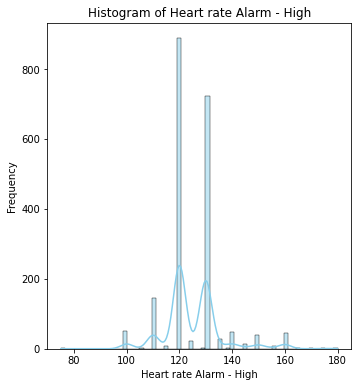

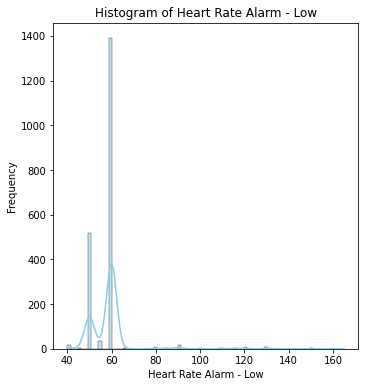

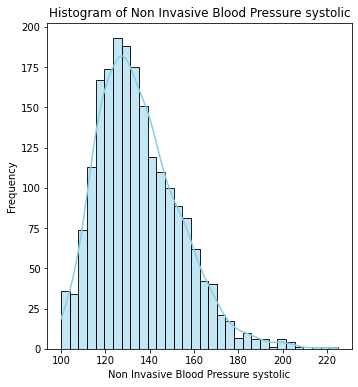

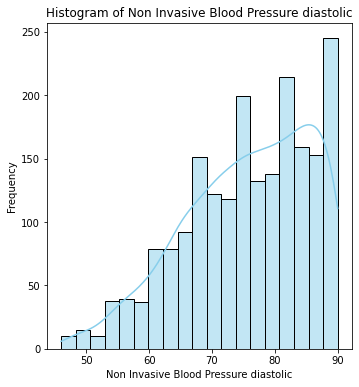

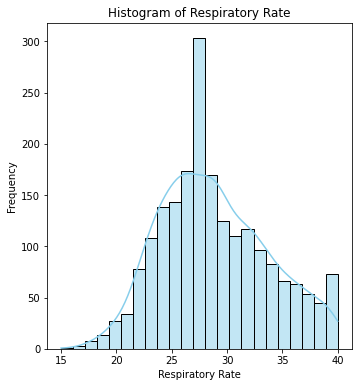

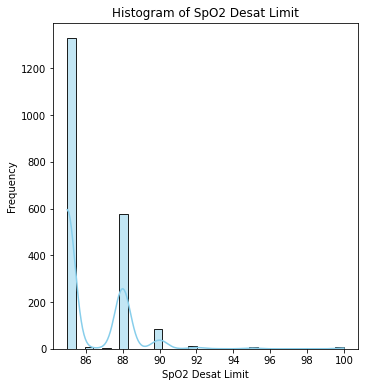

In [113]:
#Histograms to check Normality of the variables
save1_dir = './Shapiro_plots/'
os.makedirs(save1_dir, exist_ok=True)
continuous= df.iloc[:,6:12]

def draw_visualizations(univar, columns):
    for col in columns:
        plt.figure(figsize=(12, 6))
        
        # Histogram
        plt.subplot(1, 2, 1)
        sns.histplot(univar[col], kde=True, color='skyblue')
        plt.title(f'Histogram of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
        
        plt.savefig(os.path.join(save1_dir, col + '_hist.png'))

        plt.show()

draw_visualizations(df,continuous)

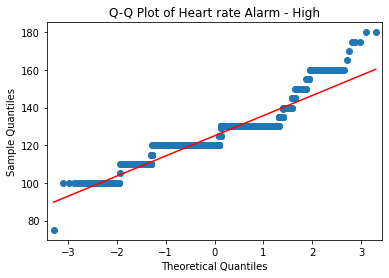

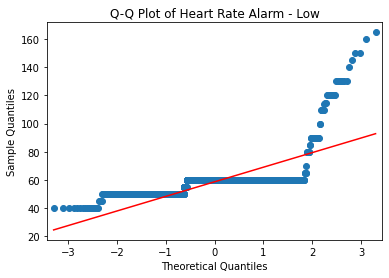

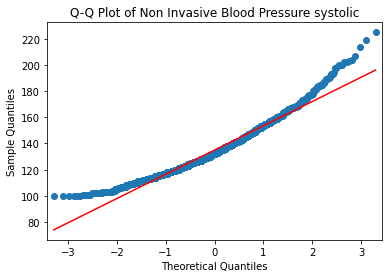

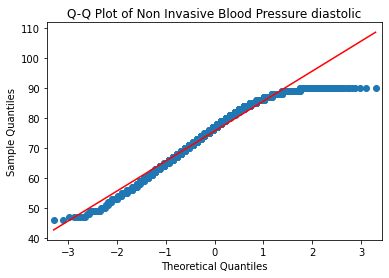

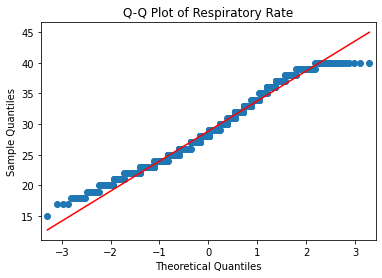

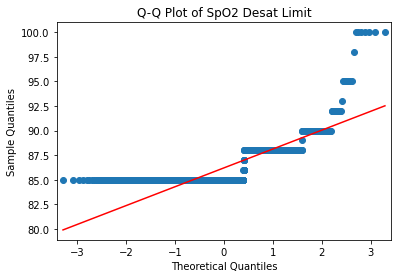

In [114]:
#Q-Q plot to check Normality of continuous variables
import os
save1_dir = './QQ_plots/'
os.makedirs(save1_dir, exist_ok=True)

import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

for col in continuous:
    sm.qqplot(df[col].dropna(), line='s')
    plt.title(f'Q-Q Plot of {col}')
    plt.savefig(os.path.join(save1_dir, col + '_qq.png'))
    plt.show()

### T test

In [115]:
from scipy import stats
continuous= df.iloc[:,6:22]

for col in continuous:
    survivor = df[df['mortality'] == 0][col].dropna()
    non_survivor = df[df['mortality'] == 1][col].dropna()
    t_stat, p_val = stats.ttest_ind(survivor, non_survivor)
    print(f'T-statistic of {col}: {t_stat}, P-value: {p_val}\n')

T-statistic of Heart rate Alarm - High: -10.163992212368727, P-value: 1.0505312771434418e-23

T-statistic of Heart Rate Alarm - Low: -1.7351933527539751, P-value: 0.08285847630590014

T-statistic of Non Invasive Blood Pressure systolic: -5.2508325833832945, P-value: 1.672581484238407e-07

T-statistic of Non Invasive Blood Pressure diastolic: -3.0815157005232963, P-value: 0.0020871794150197384

T-statistic of Respiratory Rate: -10.890915248018178, P-value: 6.956218945116979e-27

T-statistic of SpO2 Desat Limit: -7.277789315477158, P-value: 4.828474900867008e-13

T-statistic of Prothrombin time: 0.7622393082396969, P-value: 0.4460058295120408

T-statistic of Anion gap: -23.59208593393602, P-value: 6.0723656974519785e-109

T-statistic of Creatinine (serum): 0.310987952523229, P-value: 0.7558417412357474

T-statistic of Potassium, Whole Blood-2: 0.6575928822548729, P-value: 0.5108743976068795

T-statistic of Bicarbonate: 5.0526420484580274, P-value: 4.747944423938388e-07

T-statistic of GC

## Feature Selection for Machine Learning Models

In [116]:
feature_df = pd.read_csv('Team3_cleandata.csv')

In [117]:
# Reverse mapping dictionary
reverse_mapping = {'present': 1, 'absent': 0}

# Iterate through the categorical columns
for col in df:
    # Check if the column contains 'present' and 'absent' labels
    unique_values = set(feature_df[col].unique())
    if 'present' in unique_values and 'absent' in unique_values:
        # Map 'present' and 'absent' labels to 1 and 0 using reverse mapping
        feature_df[col] = feature_df[col].map(reverse_mapping)
        # Convert data type to integer
        feature_df[col] = feature_df[col].astype(int)


In [118]:
#Change made 2
#Checking for any data type beside numerical
for column, dtype in feature_df.dtypes.items():
    print(f"Column: {column}, Data Type: {dtype}")

Column: Unnamed: 0, Data Type: int64
Column: subject_id, Data Type: int64
Column: gender, Data Type: int64
Column: age, Data Type: int64
Column: mortality, Data Type: int64
Column: ethnicity, Data Type: object
Column: Heart Rate, Data Type: int64
Column: Heart rate Alarm - High, Data Type: float64
Column: Heart Rate Alarm - Low, Data Type: float64
Column: Non Invasive Blood Pressure systolic, Data Type: float64
Column: Non Invasive Blood Pressure diastolic, Data Type: float64
Column: Respiratory Rate, Data Type: float64
Column: SpO2 Desat Limit, Data Type: float64
Column: Prothrombin time, Data Type: float64
Column: Anion gap, Data Type: float64
Column: Creatinine (serum), Data Type: float64
Column: Potassium, Whole Blood-2, Data Type: float64
Column: Bicarbonate, Data Type: float64
Column: GCS - Eye Opening, Data Type: int64
Column: Hemoglobin-2, Data Type: float64
Column: Hematocrit, Data Type: float64
Column: Platelet Count, Data Type: int64
Column: Acute myocardial infarction of an

In [119]:
#Change 3

#Since ethnicity and agegroup are categorical and non numerical group. Using label encoder i converted them into numerical format 
#to put this inside the model

label_encoder = LabelEncoder()
feature_df['ethnicity_new'] = label_encoder.fit_transform(feature_df['ethnicity'])
feature_df['age_group'] = label_encoder.fit_transform(feature_df['Age Group'])

# Drop the original 'ethnicity' and 'age group' since we already have the old one
feature_df.drop('ethnicity', axis=1, inplace=True)
feature_df.drop('Age Group', axis=1, inplace=True)

In [120]:
#Change 4 

#Checking all the data types if they are numerical 
for column, dtype in feature_df.dtypes.items():
    print(f"Column: {column}, Data Type: {dtype}")

Column: Unnamed: 0, Data Type: int64
Column: subject_id, Data Type: int64
Column: gender, Data Type: int64
Column: age, Data Type: int64
Column: mortality, Data Type: int64
Column: Heart Rate, Data Type: int64
Column: Heart rate Alarm - High, Data Type: float64
Column: Heart Rate Alarm - Low, Data Type: float64
Column: Non Invasive Blood Pressure systolic, Data Type: float64
Column: Non Invasive Blood Pressure diastolic, Data Type: float64
Column: Respiratory Rate, Data Type: float64
Column: SpO2 Desat Limit, Data Type: float64
Column: Prothrombin time, Data Type: float64
Column: Anion gap, Data Type: float64
Column: Creatinine (serum), Data Type: float64
Column: Potassium, Whole Blood-2, Data Type: float64
Column: Bicarbonate, Data Type: float64
Column: GCS - Eye Opening, Data Type: int64
Column: Hemoglobin-2, Data Type: float64
Column: Hematocrit, Data Type: float64
Column: Platelet Count, Data Type: int64
Column: Acute myocardial infarction of anterolateral wall, initial epis, Data 

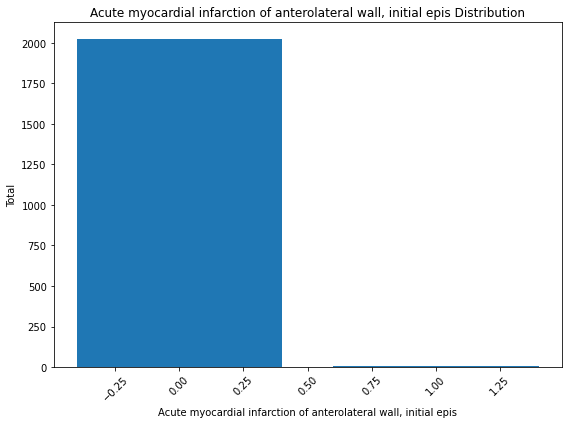

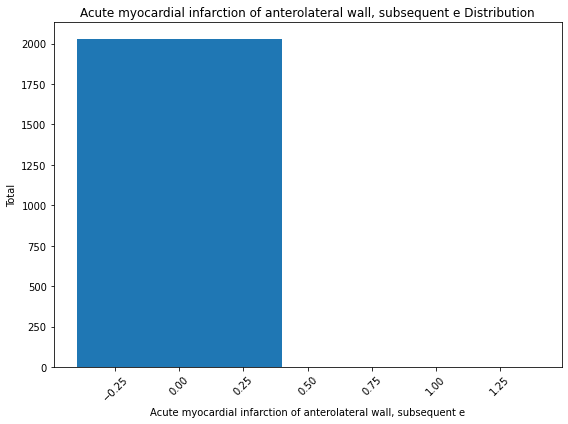

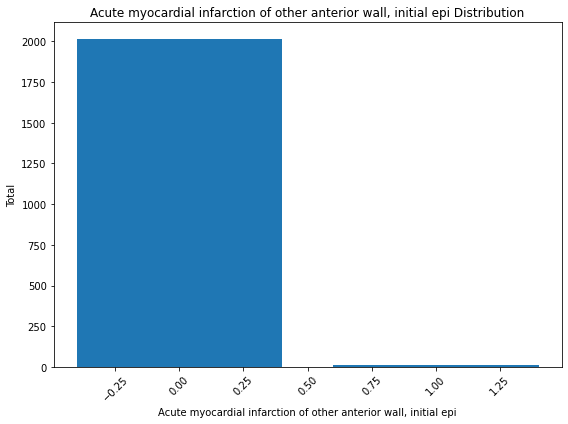

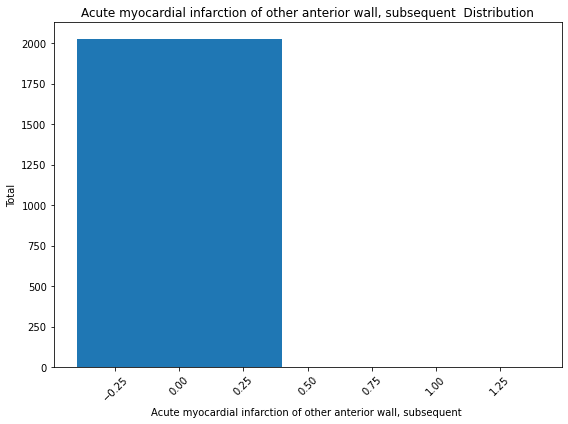

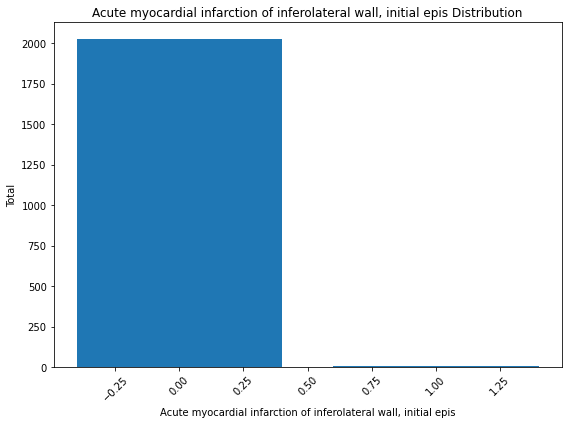

...

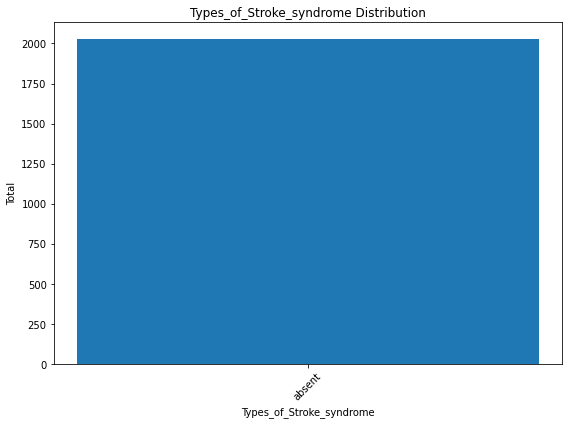

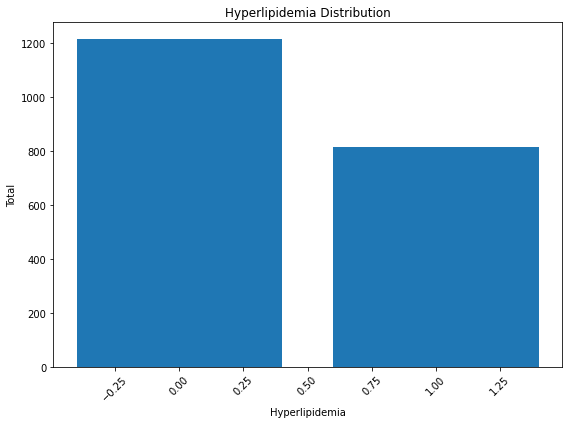

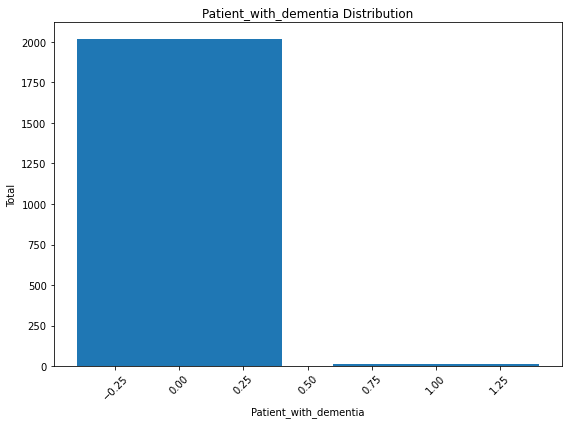

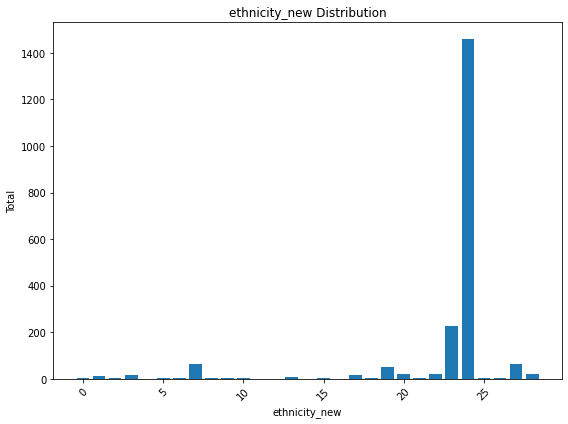

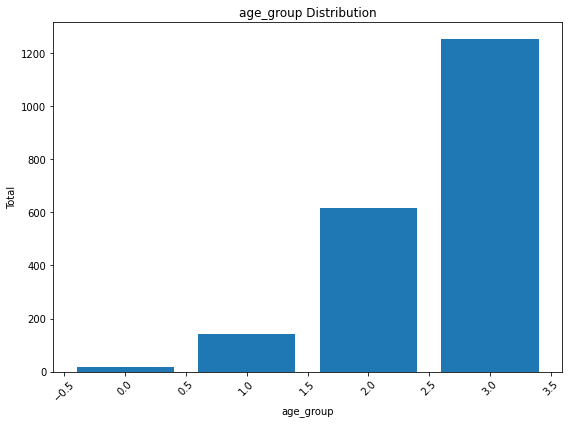

In [121]:

#Checking to see if the binary variables are significant enough. If there is a good balance between the present and absent it will be selected for the model 

save_dir = './category_plots/'
import os
os.makedirs(save_dir, exist_ok=True)
categorical_column = feature_df.iloc[:,21:]
#categorical_column = categorical_column.drop(columns=['Age Group'])
categorical_column

mapping = {1: 'present', 0: 'absent'}

for col in categorical_column:
    # Checking if the column contains values 1 and 0
    unique_values = set(feature_df[col].unique())
    if len(unique_values) == 1 and (0 in unique_values or 1 in unique_values):
        feature_df[col] = feature_df[col].map(mapping)


for col in categorical_column:
    # Count the occurrences of each category
    category_counts = feature_df[col].value_counts()

    # Create the bar chart
    plt.figure(figsize=(8, 6))
    plt.bar(category_counts.index, category_counts.values)

    # Set labels and title
    plt.xlabel(col)
    plt.ylabel('Total')
    plt.title(f'{col} Distribution')

    # Rotate x-axis labels if needed
    plt.xticks(rotation=45)
    
    plt.savefig(os.path.join(save_dir, col + '_catplot.png'))

    # Show the plot
    plt.tight_layout()
    plt.show()

In [122]:
#From above graph the significant categorical variables were selected
features = [
    "gender",
    "age",
    "mortality",
    "Heart Rate",
    "Heart rate Alarm - High",
    "Heart Rate Alarm - Low",
    "Non Invasive Blood Pressure systolic",
    "Non Invasive Blood Pressure diastolic",
    "Respiratory Rate",
    "SpO2 Desat Limit",
    "Prothrombin time",
    "Anion gap",
    "Creatinine (serum)",
    "Potassium, Whole Blood-2",
    "Bicarbonate",
    "GCS - Eye Opening",
    "Hemoglobin-2",
    "Hematocrit",
    "Platelet Count",
    "age_group",
    "ethnicity_new",
   "Chronic systolic (congestive) heart failure",
 "Atrial fibrillation",
 "Hyperlipidemia, unspecified",
 "Chronic obstructive pulmonary disease, unspecified-2",
 "Chronic obstructive pulmonary disease, unspecified",
 "Unspecified atrial fibrillation",
 "Types_of_MI",
 "Types_of_Heart_Failure",
 "Hyperlipidemia"
    
       
]

In [123]:
feature_selected = feature_df[features]

In [124]:
feature_selected.to_csv('Selected_Features.csv', index=False)

#The Selected_Features file will be used for XGBoost and Random Forest model